# Question 1: Word Clustering and Similarity Analysis


## Problem Statement
The goal of this question is to cluster words based on their similarities using unsupervised learning techniques. You will work with a large text corpus (e.g., novels from Project Gutenberg) and analyze relationships between words by calculating the distance or similarity between them. Below are the specific tasks you need to complete:


1. **Text Collection and Preprocessing**: Download a few novels from Project Gutenberg, concatenate them, and clean the data. 
2. **Word Selection**: Pick a set of 100 words (e.g., nouns, verbs, adjectives, adverbs) and form a list called `L`.
3. **Similarity/Distance Calculation**: Calculate the similarity or distance between words in `L`, based on how often two words occur in the same sentence or their average distance apart in the text.
4. **Unsupervised Learning**: Perform unsupervised learning (e.g., clustering) using the similarity/distances. Analyze the results.
5. **Shortest Path Calculation**: Use Dijkstra’s algorithm to find the shortest path between word pairs and repeat the unsupervised learning process to check for differences.


In [57]:
# !pip install PyPDF2

## Import Required Libraries

Import all the necessary libraries for data processing, text analysis, and unsupervised learning. Below are the libraries we need for different tasks:

In [58]:
import os
import PyPDF2
import re
import nltk
import contractions
from collections import Counter
from itertools import combinations
import numpy as np
import networkx as nx
from sklearn.cluster import DBSCAN
import matplotlib.pyplot as plt
from nltk.tokenize import sent_tokenize, word_tokenize
from nltk.corpus import stopwords, wordnet
from nltk import pos_tag
from nltk.stem import WordNetLemmatizer

## Download NLTK Resources
Download the necessary resources from the **Natural Language Toolkit (NLTK)**. These resources are crucial for tokenizing text and performing part-of-speech tagging:

- **punkt**: Used for sentence and word tokenization.
- **averaged_perceptron_tagger_eng**: Used for part-of-speech tagging, allowing us to identify different word types such as nouns, verbs, adjectives, etc.
- **stopwords**: A list of common words (e.g., "the", "is", "in") that we will remove from the text to focus on meaningful words.


In [59]:
nltk.download("punkt")
nltk.download("averaged_perceptron_tagger_eng")
nltk.download("stopwords")
nltk.download('wordnet')
nltk.download('omw-1.4') 

[nltk_data] Downloading package punkt to C:\Users\agarw/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger_eng to
[nltk_data]     C:\Users\agarw/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger_eng is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\agarw/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to C:\Users\agarw/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to C:\Users\agarw/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


True

## Extract Text from PDFs

The function extract_text_from_pdfs(pdf_files):
- Reads a list of PDF files.
- Extracts text from each page of each PDF.
- Removes Project Gutenberg headers and footers if present.
- Combines and returns all the cleaned text as a single string.

In [60]:
def extract_text_from_pdfs(pdf_files):        # Initialize an empty string to store all the extracted text
    text = ""                                 # Loop through each PDF file in the provided list
    
    for file in pdf_files:                    # Initialize an empty string for the current file's text    
        extracted_text = ""
        with open(file, "rb") as f:
            reader = PyPDF2.PdfReader(f)      # Create a PDF reader object to read the file
            for page in reader.pages:
                page_text = page.extract_text()
                if page_text:
                    extracted_text += page_text + " "
        # Remove Gutenberg headers/footers if present
        match = re.search(
            r"\*\*\* START OF THE PROJECT GUTENBERG EBOOK .*? \*\*\*(.*?)\*\*\* END OF THE PROJECT GUTENBERG EBOOK .*? \*\*\*", 
            extracted_text, 
            re.DOTALL
        )
        if match:                            # If headers/footers are found, keep only the main content
            cleaned_text = match.group(1).strip()
        else:
            cleaned_text = extracted_text.strip()   # Add the cleaned text from this file to the final output, separated by two newlines
        text += cleaned_text + "\n\n"
    return text

pdf_files = ["Siddhartha.pdf", "This_side_of_paradise.pdf","Ulysses.pdf","great gatsby.pdf","TheMysteryOfBlueTrain.pdf"]  # List of PDF files to process
raw_text = extract_text_from_pdfs(pdf_files)

In [61]:
for i, file in enumerate(pdf_files):
    print(f"\n--- Sample from {file} ---")
    sample_text = extract_text_from_pdfs([file])
    print(sample_text[:100])  # Print first 100 characters for inspection



--- Sample from Siddhartha.pdf ---
Siddhartha
An Indian Tale
by Herman Hesse
Contents
 FIRST PART
 THE SON OF THE BRAHMAN
 WITH THE SAM

--- Sample from This_side_of_paradise.pdf ---
Produced by David Reed, Ken Reeder, and David Widger
[Illustration]
      THIS SIDE OF PARADISE
    

--- Sample from Ulysses.pdf ---
The Great Gatsby
                                  by
                          F. Scott Fitzgerald


--- Sample from great gatsby.pdf ---
The Great Gatsby
                                  by
                          F. Scott Fitzgerald


--- Sample from TheMysteryOfBlueTrain.pdf ---
THE MYSTERY OF THE BLUE TRAIN
                          By AGATHA CHRISTIE
            Copyright, 19


In [62]:
raw_text #Store the Extracted Text 

'Siddhartha\nAn Indian Tale\nby Herman Hesse\nContents\n FIRST PART\n THE SON OF THE BRAHMAN\n WITH THE SAMANAS\n GOTAMA\n AWAKENING\n SECOND PART\n KAMALA\n WITH THE CHILDLIKE PEOPLE\n SANSARA\n BY THE RIVER\n THE FERRYMAN\n THE SON\n OM\n GOVINDA\nFIRST PART\nTo Romain Rolland, my dear friend3/17/25, 1:40 PM gutenberg.org/cache/epub/2500/pg2500.txt\nhttps://www.gutenberg.org/cache/epub/2500/pg2500.txt 1/67 THE SON OF THE BRAHMAN\nIn the shade of the house, in the sunshine of the riverbank near the\nboats, in the shade of the Sal-wood forest, in the shade of the fig\ntree is where Siddhartha grew up, the handsome son of the Brahman, the\nyoung falcon, together with his friend Govinda, son of a Brahman. The\nsun tanned his light shoulders by the banks of the river when bathing,\nperforming the sacred ablutions, the sacred offerings. In the mango\ngrove, shade poured into his black eyes, when playing as a boy, when\nhis mother sang, when the sacred offerings were made, when his father,\

## Mapping POS tag & Text Preprocessing 


Mapping POS tag

In [63]:
# Helper function to map NLTK POS tags to WordNet POS tags
def get_wordnet_pos(treebank_tag):
    if treebank_tag.startswith('J'):         # If the tag starts with 'J', it means adjective
        return wordnet.ADJ
    elif treebank_tag.startswith('V'):       # If the tag starts with 'V', it means verb
        return wordnet.VERB
    elif treebank_tag.startswith('N'):       # If the tag starts with 'N', it means noun
        return wordnet.NOUN
    elif treebank_tag.startswith('R'):       # If the tag starts with 'R', it means adverb
        return wordnet.ADV
    else:
        return wordnet.NOUN  # default to noun


Text Preprocessing

The function preprocess_text(text):

- Converts all text to lowercase.
- Expands contractions (like "don't" to "do not").
- Removes Project Gutenberg metadata and other unwanted patterns.
- Removes URLs, digits, and non-ASCII characters.
- Normalizes whitespace (removes extra spaces).
- Returns the cleaned text.

In [64]:
def preprocess_text(text):
    # Lowercase
    text = text.lower()
    # Expand contractions
    text = contractions.fix(text)
    # Remove unwanted patterns and metadata
    text = re.sub(r'project gutenberg ebook.*?start of the project gutenberg ebook', '', text, flags=re.DOTALL)
    text = re.sub(r'project gutenberg.*', '', text, flags=re.DOTALL)
    text = re.sub(r'pm\s+gutenberg\.org.*?pg\.txt', '', text, flags=re.DOTALL)
    text = re.sub(r'gutenberg\.org.*?\.txt', '', text, flags=re.DOTALL)
    # Remove URLs, digits, non-ASCII
    text = re.sub(r'http\S+', '', text)
    text = re.sub(r'\d+', '', text)
    text = text.encode('ascii', 'ignore').decode('ascii')
    # Normalize whitespace
    text = re.sub(r"\s+", " ", text).strip()
    return text


## Tokenize Sentences and Words
Tokenization is the process of splitting text into smaller units, such as sentences and words. We also remove stopwords and non-alphabetical words to focus on meaningful content.

The function tokenize_lemmatize(text):

- Splits text into sentences and words.
- Removes punctuation and special characters.
- Removes common English and custom stopwords.
- Tags each word with its part of speech (POS).
- Lemmatizes each word (reduces to its base form).
- Returns both the processed sentences and a flat list of all lemmatized words.


In [65]:
def tokenize_lemmatize(text):
    stop_words = set(stopwords.words('english'))   # Get a set of standard English stopwords (common words to ignore)
    custom_stopwords = {'chapter', 'gutenberg', 'ebook', 'pg', 'org', 'pm', 'txt', 'cache', 'epub'} # Add custom stopwords specific to your project
    stop_words.update(custom_stopwords)
    lemmatizer = WordNetLemmatizer()
    # Sentence tokenize **before removing punctuation**
    sentences = sent_tokenize(text)
    processed_sentences = []
    all_words = []

    # Process each sentence in the text
    for sent in sentences:
        # Remove special characters (except spaces and keep sentence structure)
        sent_clean = re.sub(r"[^a-zA-Z\s]", " ", sent)
        sent_clean = re.sub(r"\s+", " ", sent_clean).strip()
        words = word_tokenize(sent_clean)
        tagged = pos_tag(words)
        lemmatized = [
            lemmatizer.lemmatize(word, get_wordnet_pos(tag))
            for word, tag in tagged
            if word.isalpha() and word not in stop_words
        ]
        if lemmatized:  # Only add non-empty sentences
            all_words.extend(lemmatized)
            processed_sentences.append(lemmatized)
    return processed_sentences, all_words

# Clean the raw text using the preprocessing function
clean_text = preprocess_text(raw_text)

# Tokenize and lemmatize the cleaned text
processed_sentences, all_words = tokenize_lemmatize(clean_text)

In [66]:
print("\n--- Sample of First 3 Processed Sentences ---")
for sent in processed_sentences[:3]:
    print(sent)
print("\n--- Sample of 20 All Words ---")
print(all_words[:20])


--- Sample of First 3 Processed Sentences ---
['siddhartha', 'indian', 'tale', 'herman', 'hesse', 'content', 'first', 'part', 'son', 'brahman', 'samanas', 'gotama', 'awaken', 'second', 'part', 'kamala', 'childlike', 'people', 'sansara', 'river', 'ferryman', 'son', 'om', 'govinda', 'first', 'part', 'romain', 'rolland', 'dear', 'friend', 'son', 'brahman', 'shade', 'house', 'sunshine', 'riverbank', 'near', 'boat', 'shade', 'sal', 'wood', 'forest', 'shade', 'fig', 'tree', 'siddhartha', 'grow', 'handsome', 'son', 'brahman', 'young', 'falcon', 'together', 'friend', 'govinda', 'son', 'brahman']
['sun', 'tan', 'light', 'shoulder', 'bank', 'river', 'bath', 'perform', 'sacred', 'ablution', 'sacred', 'offering']
['mango', 'grove', 'shade', 'pour', 'black', 'eye', 'play', 'boy', 'mother', 'sang', 'sacred', 'offering', 'make', 'father', 'scholar', 'teach', 'wise', 'men', 'talk']

--- Sample of 20 All Words ---
['siddhartha', 'indian', 'tale', 'herman', 'hesse', 'content', 'first', 'part', 'son', '

## POS Tagging and Frequency Filtering

In [67]:
# Count word frequencies
word_counts = Counter(all_words)

# Filter Words by Length and Frequency
filtered_words = [w for w in all_words if len(w) >=3 and word_counts[w] >= 5 ]

# Re-count using only filtered words
filtered_counts = Counter(filtered_words)

# POS tag filtered words
tagged = pos_tag(filtered_words)

# Categorize by POS
pos_map = {
    'nouns': ['NN', 'NNS', 'NNP', 'NNPS'],
    'verbs': ['VB', 'VBD', 'VBG', 'VBN', 'VBP', 'VBZ'],
    'adjectives': ['JJ', 'JJR', 'JJS'],
    'adverbs': ['RB', 'RBR', 'RBS']
}
word_pos = {key: [] for key in pos_map}

for word, tag in tagged:
    for pos_name, tags in pos_map.items():
        if tag in tags:
            word_pos[pos_name].append(word)

# Get top 25 from each POS category
L = []
for pos_name in word_pos:
    freq = Counter(word_pos[pos_name])
    top = [w for w, _ in freq.most_common(25)]
    L.extend(top)

# Ensure uniqueness
L = list(dict.fromkeys(L))

# Fill to 100 using only filtered words
if len(L) < 100:
    remaining = [w for w, _ in filtered_counts.most_common() if w not in L]
    L += remaining[:100 - len(L)]

L = L[:100]

In [68]:
print("\n--- List L: 100 Content Words ---")
print(L)
print(f"\nTotal unique words in L: {len(L)}")



--- List L: 100 Content Words ---
['amory', 'man', 'time', 'siddhartha', 'thing', 'day', 'year', 'people', 'life', 'eye', 'night', 'look', 'voice', 'men', 'face', 'hand', 'way', 'world', 'govinda', 'word', 'heart', 'nothing', 'river', 'rosalind', 'hour', 'say', 'know', 'think', 'get', 'make', 'come', 'take', 'want', 'see', 'find', 'seem', 'felt', 'leave', 'become', 'saw', 'love', 'give', 'tell', 'turn', 'teaching', 'stand', 'thought', 'walk', 'good', 'old', 'little', 'many', 'great', 'new', 'much', 'last', 'long', 'young', 'light', 'first', 'full', 'high', 'big', 'small', 'smile', 'beautiful', 'deep', 'live', 'hear', 'well', 'never', 'back', 'also', 'still', 'even', 'always', 'ever', 'rather', 'yet', 'away', 'quite', 'suddenly', 'really', 'already', 'perhaps', 'thus', 'slowly', 'almost', 'far', 'often', 'quietly', 'one', 'would', 'like', 'could', 'every', 'two', 'let', 'learn', 'ask']

Total unique words in L: 100


## Building the Co-occurrence Matrix

In [69]:
# Create a Set of Selected Words
L_set = set(L)

# Map Words to Index Numbers
word2idx = {w: i for i, w in enumerate(L)}

# Initialize the Co-occurrence Matrix
cooc_mat = np.zeros((len(L), len(L)), dtype=int)

# Count Co-occurrences in Sentences
for sent in processed_sentences:       # Go through each processed sentence (a list of lemmatized words).
    present = [w for w in sent if w in L_set]
    for w1, w2 in combinations(set(present), 2):
        idx1, idx2 = word2idx[w1], word2idx[w2]
        cooc_mat[idx1, idx2] += 1   # Get the index of each word in the matrix.
        cooc_mat[idx2, idx1] += 1   # Increase the count for this word pair.


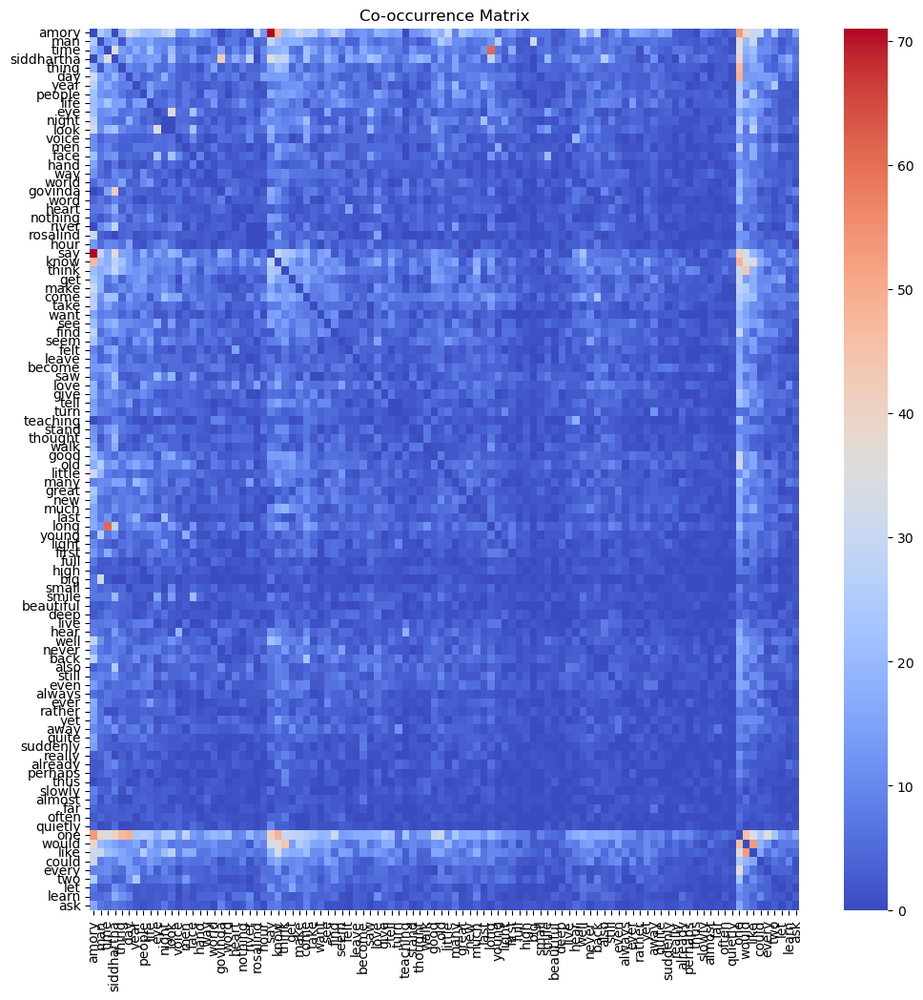

In [70]:
# Converting Co-occurrence to Distance Matrix

# Create a Distance Matrix from Co-occurrence Matrix
# Use: distance = 1 / (cooccurrence + 1)

dist_mat = 1 / (cooc_mat + 1)

# For each pair of words, calculate a "distance" value.
# The more often two words appear together, the smaller the distance.
# Adding 1 prevents division by zero.

# Visualizing the Co-occurrence Matrix
import seaborn as sns     #library for creating attractive heatmaps.
plt.figure(figsize=(12, 12))
sns.heatmap(cooc_mat,xticklabels=L,yticklabels=L,cmap="coolwarm")
plt.title("Co-occurrence Matrix")

plt.show() #Display the Plot

In [71]:
dist_mat  #helps measure how closely words are related in the text

array([[1.        , 0.03846154, 0.05      , ..., 0.125     , 0.16666667,
        0.05882353],
       [0.03846154, 1.        , 0.07692308, ..., 0.33333333, 0.16666667,
        0.125     ],
       [0.05      , 0.07692308, 1.        , ..., 0.25      , 0.125     ,
        0.16666667],
       ...,
       [0.125     , 0.33333333, 0.25      , ..., 1.        , 0.33333333,
        1.        ],
       [0.16666667, 0.16666667, 0.125     , ..., 0.33333333, 1.        ,
        0.25      ],
       [0.05882353, 0.125     , 0.16666667, ..., 1.        , 0.25      ,
        1.        ]])

## Clustering Words Based on Co-occurrence Distances

Clustering is the process of grouping similar items together. Here, we use three clustering algorithms to group words based on how often they appear together (co-occurrence) in the text. We use a distance matrix derived from co-occurrence counts to measure how "close" or "related" each pair of words is.

This code:
- Imports necessary libraries for clustering and dimensionality reduction.
- Applies three clustering methods: DBSCAN, Agglomerative Clustering, and KMeans.
- Uses Multi-Dimensional Scaling (MDS) to convert the distance matrix into coordinates for KMeans.

In [72]:
from sklearn.manifold import MDS
from sklearn.cluster import AgglomerativeClustering,DBSCAN,KMeans
from collections import defaultdict

# DBSCAN Clustering on Co-occurrence Distance
dbscan = DBSCAN(eps=0.5, min_samples=5, metric='precomputed')
labels_dbscan = dbscan.fit_predict(dist_mat)

# Agglomerative Clustering (Ward linkage)
agglo = AgglomerativeClustering(n_clusters=5, metric='precomputed', linkage='average')
labels_agglo = agglo.fit_predict(dist_mat) # Fit Agglomerative Clustering to your distance matrix and get a label for each word.

# KMeans (requires vector data, so use MDS for embedding)
mds = MDS(n_components=2, dissimilarity='precomputed', random_state=42)
coords = mds.fit_transform(dist_mat)  # Transform the distance matrix into 2D coordinates for each word.
kmeans = KMeans(n_clusters=5, random_state=42)  # Create a KMeans clustering object to find 5 clusters.
labels_kmeans = kmeans.fit_predict(coords) # Fit KMeans to the 2D coordinates and get a label for each word.

The function plot_clusters(coords, labels, title):
- Plots each word as a point in 2D space.
- Colors each point according to its cluster label.
- Annotates each point with the corresponding word.
- Adds a color bar and a title to the plot.

In [73]:
# Visualize Clusters (MDS 2D)
def plot_clusters(coords, labels, title):
    
    # plt.figure(figsize=(8,6))
    scatter = plt.scatter(coords[:,0], coords[:,1], c=labels, cmap='tab10', s=60)
    
    for i, word in enumerate(L):   # For each word, add its text label at its (x, y) coordinate.
        plt.text(coords[i,0], coords[i,1], word, fontsize=8)
    plt.title(title)
    plt.colorbar(scatter)


## Visualizing Clusters and Analyzing Word Network with Dijkstra's Algorithm

In [74]:
# Build Graph for Dijkstra's algorithm

G = nx.Graph()

# Create an empty undirected graph using NetworkX.
for i, w1 in enumerate(L):
    for j, w2 in enumerate(L):
        if i < j and cooc_mat[i, j] > 0:
            G.add_edge(w1, w2, weight=dist_mat[i, j])     # Add an edge between words w1 and w2 if they co-occur at least once.

# Compute Dijkstra Shortest Path Distance Matrix
present_words = list(G.nodes)   # List all words (nodes) that are present in the graph.
n_present = len(present_words)

shortest_distances = np.full((n_present, n_present), np.inf)   # Create a matrix filled with infinity to store shortest path distances between all pairs of words.

for i, w1 in enumerate(present_words):
    lengths = nx.single_source_dijkstra_path_length(G, w1)
    for j, w2 in enumerate(present_words):
        if w2 in lengths:
            shortest_distances[i, j] = lengths[w2]

# Replace Infinite Values for Clustering
max_finite = np.max(shortest_distances[np.isfinite(shortest_distances)])  # Find the largest finite distance in the matrix.
shortest_distances[~np.isfinite(shortest_distances)] = max_finite + 1  # Replace any remaining infinite values with (max finite distance + 1).

# Create a mapping from words to their indices
word_to_index = {word: i for i, word in enumerate(L)}

# Build a Dictionary of Original Distances
word_distances = {}

for i in range(len(L)):
    for j in range(i + 1, len(L)):  # to avoid duplicate pairs (i,j) and (j,i)
        word1 = L[i]
        word2 = L[j]
        dist = dist_mat[i, j]
        word_distances[(word1, word2)] = dist
        
# Compare Original and Corrected Distances
for (word1, word2), original_distance in word_distances.items():
    idx1, idx2 = word_to_index[word1], word_to_index[word2]  # Get indices
    corrected_distance = shortest_distances[idx1, idx2]  # Extract distance from matrix
    print(f"{word1} -> {word2}: Original = {original_distance}, Corrected = {corrected_distance}")


amory -> man: Original = 0.038461538461538464, Corrected = 0.038461538461538464
amory -> time: Original = 0.05, Corrected = 0.046296296296296294
amory -> siddhartha: Original = 1.0, Corrected = 0.039351851851851846
amory -> thing: Original = 0.05263157894736842, Corrected = 0.030303030303030304
amory -> day: Original = 0.030303030303030304, Corrected = 0.03571428571428571
amory -> year: Original = 0.03571428571428571, Corrected = 0.043478260869565216
amory -> people: Original = 0.043478260869565216, Corrected = 0.045454545454545456
amory -> life: Original = 0.045454545454545456, Corrected = 0.043478260869565216
amory -> eye: Original = 0.043478260869565216, Corrected = 0.034482758620689655
amory -> night: Original = 0.034482758620689655, Corrected = 0.030303030303030304
amory -> look: Original = 0.030303030303030304, Corrected = 0.07271241830065359
amory -> voice: Original = 0.08333333333333333, Corrected = 0.05300127713920817
amory -> men: Original = 0.08333333333333333, Corrected = 0

## Comparing Clustering on Co-occurrence vs. Dijkstra Distance Matrices

This section compares how three clustering algorithms (DBSCAN, Agglomerative, KMeans) group words when using the original co-occurrence distances versus the shortest-path (Dijkstra) distances. The results are visualized side-by-side for easy comparison.

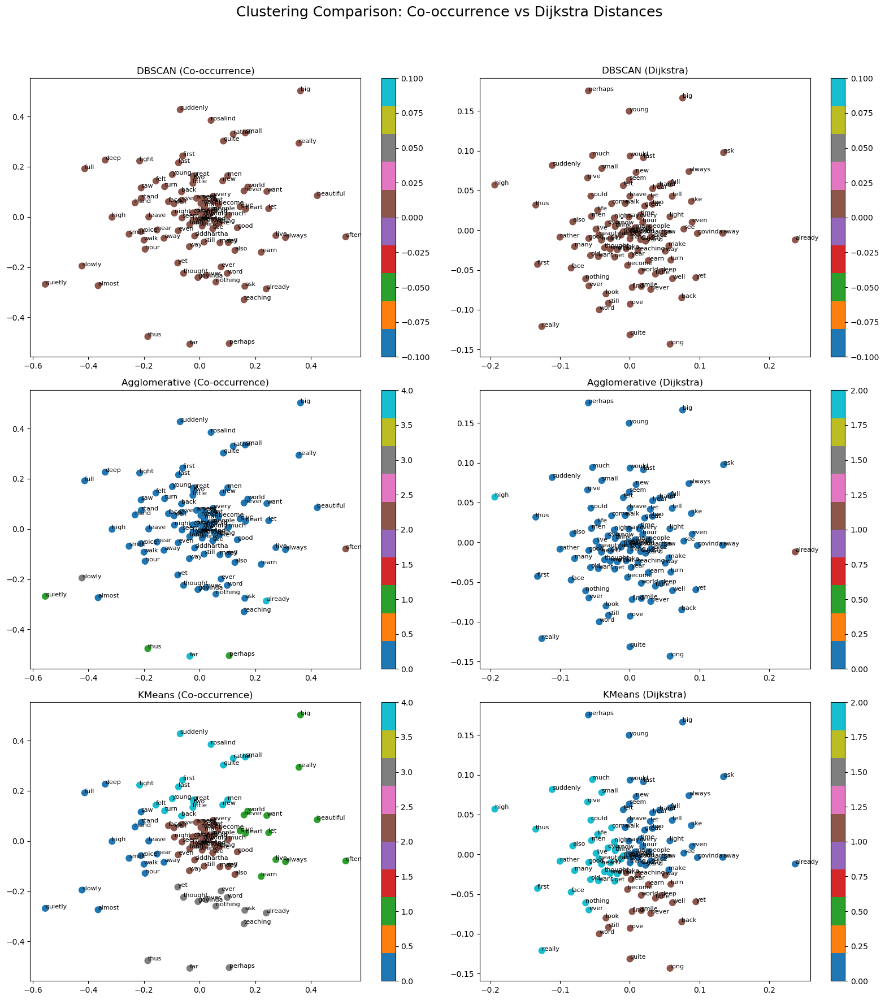

In [75]:
# Clustering on Dijkstra Distance Matrix

# DBSCAN
dbscan_dij = DBSCAN(eps=1.5, min_samples=5, metric='precomputed')
labels_dbscan_dij = dbscan_dij.fit_predict(shortest_distances)

# Agglomerative
agglo_dij = AgglomerativeClustering(n_clusters=3, metric='precomputed', linkage='average')
labels_agglo_dij = agglo_dij.fit_predict(shortest_distances)

# KMeans (using MDS embedding)
mds_dij = MDS(n_components=2, dissimilarity='precomputed', random_state=42)
coords_dij = mds_dij.fit_transform(shortest_distances)
kmeans_dij = KMeans(n_clusters=3, random_state=42)
labels_kmeans_dij = kmeans_dij.fit_predict(coords_dij)

# Visualizing Clustering Results Side-by-Side
fig, axes = plt.subplots(3, 2, figsize=(16, 18))
fig.suptitle("Clustering Comparison: Co-occurrence vs Dijkstra Distances", fontsize=18)

# DBSCAN Comparison
plt.sca(axes[0, 0])
plot_clusters(coords, labels_dbscan, "DBSCAN (Co-occurrence)")

plt.sca(axes[0, 1])
plot_clusters(coords_dij, labels_dbscan_dij, "DBSCAN (Dijkstra)")

# Agglomerative Comparison
plt.sca(axes[1, 0])
plot_clusters(coords, labels_agglo, "Agglomerative (Co-occurrence)")

plt.sca(axes[1, 1])
plot_clusters(coords_dij, labels_agglo_dij, "Agglomerative (Dijkstra)")

# KMeans Comparison
plt.sca(axes[2, 0])
plot_clusters(coords, labels_kmeans, "KMeans (Co-occurrence)")

plt.sca(axes[2, 1])
plot_clusters(coords_dij, labels_kmeans_dij, "KMeans (Dijkstra)")

# Finalize and Show the Figure
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

## Printing Clustered Words for Each Algorithm

The function print_clusters(words, labels, method):
- Groups words by their assigned cluster label.
- Prints the method name and the words in each cluster.

In [76]:
def print_clusters(words, labels, method):
    clusters = defaultdict(list)  # Create a dictionary where each cluster label maps to a list of words.
    
    for word, label in zip(words, labels):  # For each word and its cluster label, add the word to the correct cluster.
        clusters[label].append(word)
    print(f"\n{method} Clusters:")
    
    for label, group in clusters.items():   # Print the cluster label and the list of words in that cluster.
        print(f"  Cluster {label}: {group}")

# Print Clusters for Each Algorithm and Distance Type
print_clusters(L, labels_dbscan, "DBSCAN (Co-occurrence)")
print_clusters(L, labels_agglo, "Agglomerative (Co-occurrence)")
print_clusters(L, labels_kmeans, "KMeans (Co-occurrence)")

print_clusters(L, labels_dbscan_dij, "DBSCAN (Dijkstra)")
print_clusters(L, labels_agglo_dij, "Agglomerative (Dijkstra)")
print_clusters(L, labels_kmeans_dij, "KMeans (Dijkstra)")


DBSCAN (Co-occurrence) Clusters:
  Cluster 0: ['amory', 'man', 'time', 'siddhartha', 'thing', 'day', 'year', 'people', 'life', 'eye', 'night', 'look', 'voice', 'men', 'face', 'hand', 'way', 'world', 'govinda', 'word', 'heart', 'nothing', 'river', 'rosalind', 'hour', 'say', 'know', 'think', 'get', 'make', 'come', 'take', 'want', 'see', 'find', 'seem', 'felt', 'leave', 'become', 'saw', 'love', 'give', 'tell', 'turn', 'teaching', 'stand', 'thought', 'walk', 'good', 'old', 'little', 'many', 'great', 'new', 'much', 'last', 'long', 'young', 'light', 'first', 'full', 'high', 'big', 'small', 'smile', 'beautiful', 'deep', 'live', 'hear', 'well', 'never', 'back', 'also', 'still', 'even', 'always', 'ever', 'rather', 'yet', 'away', 'quite', 'suddenly', 'really', 'already', 'perhaps', 'thus', 'slowly', 'almost', 'far', 'often', 'quietly', 'one', 'would', 'like', 'could', 'every', 'two', 'let', 'learn', 'ask']

Agglomerative (Co-occurrence) Clusters:
  Cluster 0: ['amory', 'man', 'time', 'siddharth

## Evaluating Cluster Quality with Silhouette Scores

Silhouette score is a metric that measures how well each point fits within its cluster compared to other clusters. A higher score means better-defined clusters. Here, we compute silhouette scores for KMeans and Agglomerative clustering, both before and after applying Dijkstra’s shortest-path correction to the distance matrix.

In [77]:
# Import Silhouette Score Function
from sklearn.metrics import silhouette_score

# Set the diagonal elements of dist_mat to 0
np.fill_diagonal(dist_mat, 0)

# Compute Silhouette Score for KMeans (Co-occurrence Distance)
# Assuming `before_kmeans_labels` and `after_kmeans_labels` are the cluster labels
sil_kmeans = silhouette_score(dist_mat, labels_kmeans,metric="precomputed")
print(f'KMeans Score Before Dijkstra: {sil_kmeans}')

# Compute Silhouette Score for KMeans (Dijkstra Distance)
sil_kmeans_dij = silhouette_score(shortest_distances, labels_kmeans_dij,metric="precomputed")
print(f'KMeans Score After Dijkstra: {sil_kmeans_dij}')

# Compute Silhouette Score for Agglomerative Clustering (Co-occurrence Distance)
sil_agglomerative = silhouette_score(dist_mat, labels_agglo,metric="precomputed")
print(f'Agglomerative Score Before Dijkstra: {sil_agglomerative}')

# Compute Silhouette Score for Agglomerative Clustering (Dijkstra Distance)
sil_agg_dij = silhouette_score(shortest_distances, labels_agglo_dij,metric="precomputed")
print(f'Agglomerative Score After Dijkstra: {sil_agg_dij}')

KMeans Score Before Dijkstra: -0.005314433378391364
KMeans Score After Dijkstra: 0.037941708349553745
Agglomerative Score Before Dijkstra: 0.13571635209649924
Agglomerative Score After Dijkstra: 0.4603534909347598


## Comparing Cluster Distributions Before and After Dijkstra Correction
Visualizing how the distribution of words across clusters changes before and after applying Dijkstra’s correction helps you understand the impact of using shortest-path distances. The function below creates side-by-side bar charts for each clustering method.

The function plot_cluster_comparison(selected_words, initial_clusters, corrected_clusters, title):
- Counts how many words are in each cluster, before and after Dijkstra correction.
- Plots these counts as grouped bar charts for easy visual comparison.
- Adds labels, a title, and a legend for clarity.



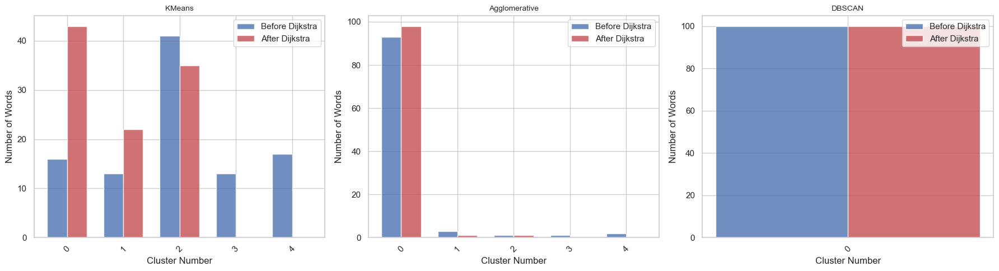

In [90]:
import matplotlib.pyplot as plt
import numpy as np

# Define the Comparison Plotting Function
def plot_cluster_comparison(selected_words, initial_clusters, corrected_clusters, title):
    # Get all unique cluster IDs across both sets
    all_clusters = sorted(set(initial_clusters) | set(corrected_clusters))

    # Count words in each cluster, before and after
    initial_cluster_counts = [list(initial_clusters).count(i) for i in all_clusters]
    corrected_cluster_counts = [list(corrected_clusters).count(i) for i in all_clusters]

    # Create bar chart
    x_pos = np.arange(len(all_clusters))
    bar_width = 0.35
    opacity = 0.8

    fig, ax = plt.subplots(figsize=(10, 6))

    ax.bar(x_pos - bar_width / 2, initial_cluster_counts, bar_width,
           alpha=opacity, color='b', label='Before Dijkstra')

    ax.bar(x_pos + bar_width / 2, corrected_cluster_counts, bar_width,
           alpha=opacity, color='r', label='After Dijkstra')

    # Labels and formatting
    ax.set_xlabel('Cluster Number')
    ax.set_ylabel('Number of Words')
    ax.set_title(title)
    ax.set_xticks(x_pos)
    ax.set_xticklabels([f'Cluster {i}' for i in all_clusters])
    ax.legend()

    plt.tight_layout()
    plt.show()

# Applying the Function to Different Clustering Methods
plot_cluster_comparison(L, labels_kmeans, labels_kmeans_dij, 
                        "KMeans: Cluster Distribution Before and After Dijkstra's Correction")

plot_cluster_comparison(L,labels_agglo, labels_agglo_dij, 
                        "Agglomerative Clustering: Cluster Distribution Before and After Dijkstra's Correction")

plot_cluster_comparison(L,labels_dbscan,labels_dbscan_dij, 
                        "DBSCAN: Cluster Distribution Before and After Dijkstra's Correction")


# Question 2: Investigating Classification Models on a Quadratic Boundary

## Problem Statement

We will generate a 2D dataset where the decision boundary follows the equation: 𝑦 = 𝑎𝑥^2+𝑥

- Points on one side of this boundary will belong to Class A and the other side to Class B.
- We will investigate how well logistic regression and a small neural network classify this dataset.
- We will vary:
   - The parameter α a to change the complexity of the decision boundary.
   - The number of points in the dataset.
   - The class balance (i.e., ratio of points in Class A vs. Class B).
   - The size of the neural network.

### Import Required Libraries

- NumPy (numpy): Used for numerical computations and dataset creation.
- Matplotlib (matplotlib.pyplot): Helps in visualizing the dataset and decision boundaries.
- Scikit-learn Modules (sklearn):
   - train_test_split: Splits data into training and testing sets.
   - LogisticRegression: Implements the logistic regression model.
   - MLPClassifier: A multi-layer perceptron (small neural network).
   - accuracy_score: Computes model accuracy.
   - confusion_matrix, ConfusionMatrixDisplay: Used to analyze model performance.

In [79]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

### Generate the Dataset
Generates a dataset with a decision boundary of the form y = ax² + x

In [80]:
my_student_number = 2619208

def generate_data(a, num_samples, class_ratio=0.5):
    np.random.seed(my_student_number)  # For reproducibility

    # Generate random x values
    x = np.random.uniform(-2, 2, num_samples)
    
    # Compute the decision boundary y = ax² + x
    y_boundary = a * x**2 + x

    # Add some noise to y values
    y_noise = np.random.uniform(-0.5, 0.5, num_samples)
    y = y_boundary + y_noise

    # Assign labels based on whether y is above or below the boundary
    labels = (y > y_boundary).astype(int)

    # Separate indices for both classes
    class1_indices = np.where(labels == 1)[0]
    class0_indices = np.where(labels == 0)[0]

    # Determine the number of samples for each class based on the ratio
    num_class1 = int(num_samples * class_ratio)
    num_class0 = num_samples - num_class1

    # Ensure we do not exceed available samples in either class
    class1_sample_size = min(len(class1_indices), num_class1)
    class0_sample_size = min(len(class0_indices), num_class0)

    # Randomly select samples from each class
    selected_class1_indices = np.random.choice(class1_indices, size=class1_sample_size, replace=False)
    selected_class0_indices = np.random.choice(class0_indices, size=class0_sample_size, replace=False)

    # Extract x and y values for selected indices
    x_class1, y_class1 = x[selected_class1_indices], y[selected_class1_indices]
    x_class0, y_class0 = x[selected_class0_indices], y[selected_class0_indices]

    # Combine into final dataset
    x = np.concatenate([x_class0, x_class1])
    y = np.concatenate([y_class0, y_class1])
    labels = np.concatenate([np.zeros(class0_sample_size), np.ones(class1_sample_size)])

    print(f"Generated data: X shape {x.shape}, y length {len(labels)}")  # Debugging output

    return np.column_stack((x, y)), labels


### Evaluating Models
This function evaluates the performance of both Logistic Regression and a Neural Network on datasets generated using different parameters.

In [81]:
def evaluate_models(a_values, sample_sizes, class_ratios, nn_sizes):
    results = []
    confusion_matrices_log_reg = []
    confusion_matrices_nn = []
    for a in a_values:
        for num_samples in sample_sizes:
            for class_ratio in class_ratios:
                for nn_size in nn_sizes:
                    
                    # Generate dataset
                    X, y = generate_data(a, num_samples, class_ratio)

                    # Split into training and testing sets
                    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=my_student_number)

                    # Ensure consistency in data
                    assert len(X) == len(y), f"Inconsistent samples: X has {len(X)} rows, y has {len(y)} elements"
                    
                    # Logistic Regression
                    log_reg = LogisticRegression()
                    log_reg.fit(X_train, y_train)
                    log_reg_preds = log_reg.predict(X_test)
                    log_reg_acc = accuracy_score(y_test, log_reg_preds)
                    
                    # Neural Network
                    nn = MLPClassifier(hidden_layer_sizes=nn_size, max_iter=1000, random_state=my_student_number)
                    nn.fit(X_train, y_train)
                    nn_preds = nn.predict(X_test)
                    nn_acc = accuracy_score(y_test, nn_preds)

                    # Store results
                    results.append((a, num_samples, class_ratio, nn_size, log_reg_acc, nn_acc))

                    # Store confusion matrices for later plotting
                    cm_log_reg = confusion_matrix(y_test, log_reg_preds)
                    cm_nn = confusion_matrix(y_test, nn_preds)
                    
                    confusion_matrices_log_reg.append({
                        'a': a, 'num_samples': num_samples, 'class_ratio': class_ratio, 
                        'nn_size': nn_size, 'conf_matrix': cm_log_reg
                    })
                    
                    confusion_matrices_nn.append({
                        'a': a, 'num_samples': num_samples, 'class_ratio': class_ratio, 
                        'nn_size': nn_size, 'conf_matrix': cm_nn
                    })
                    
                    # Plot decision boundaries for visualization
                    plot_decision_boundary(X, y, log_reg, nn, a, num_samples, class_ratio, nn_size)
    return results,confusion_matrices_log_reg, confusion_matrices_nn

### Visualizing Decision Boundaries
This function visualizes decision boundaries for Logistic Regression and a Neural Network by plotting their classification results over a 2D grid.

In [82]:
def plot_decision_boundary(X, y, log_reg, nn, a, num_samples, class_ratio, nn_size):
    plt.figure(figsize=(12, 5))

    # Define the grid limits
    x_min, x_max = X[:, 0].min() - 1, X[:, 0].max() + 1
    y_min, y_max = X[:, 1].min() - 1, X[:, 1].max() + 1
    xx, yy = np.meshgrid(np.linspace(x_min, x_max, 200), np.linspace(y_min, y_max, 200))
    grid = np.c_[xx.ravel(), yy.ravel()]

    # Plot for Logistic Regression
    plt.subplot(1, 2, 1)
    log_reg_pred = log_reg.predict(grid).reshape(xx.shape)
    plt.contourf(xx, yy, log_reg_pred, alpha=0.3)
    plt.scatter(X[:, 0], X[:, 1], c=y, edgecolors='k')
    plt.title(f'Logistic Regression (a={a}, samples={num_samples}, balance={class_ratio})')

    # Plot for Neural Network
    plt.subplot(1, 2, 2)
    nn_pred = nn.predict(grid).reshape(xx.shape)
    plt.contourf(xx, yy, nn_pred, alpha=0.3)
    plt.scatter(X[:, 0], X[:, 1], c=y, edgecolors='k')
    plt.title(f'Neural Network {nn.hidden_layer_sizes} (a={a})')
    
    plt.show()

### Running Model Evaluations & Analyzing Performance

Generated data: X shape (83,), y length 83


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


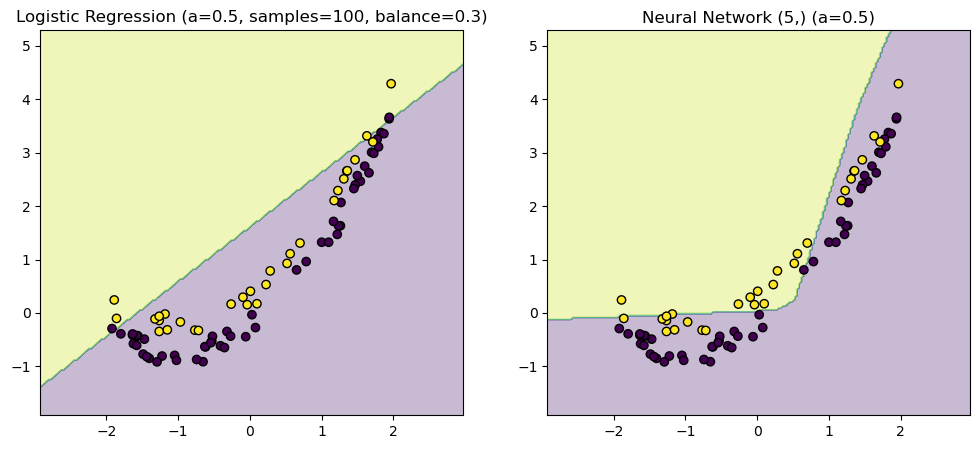

Generated data: X shape (83,), y length 83


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


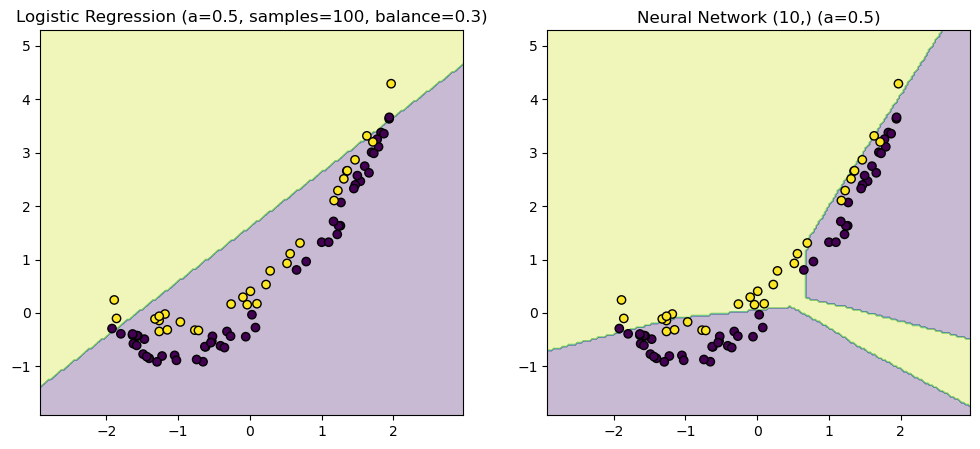

Generated data: X shape (83,), y length 83


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


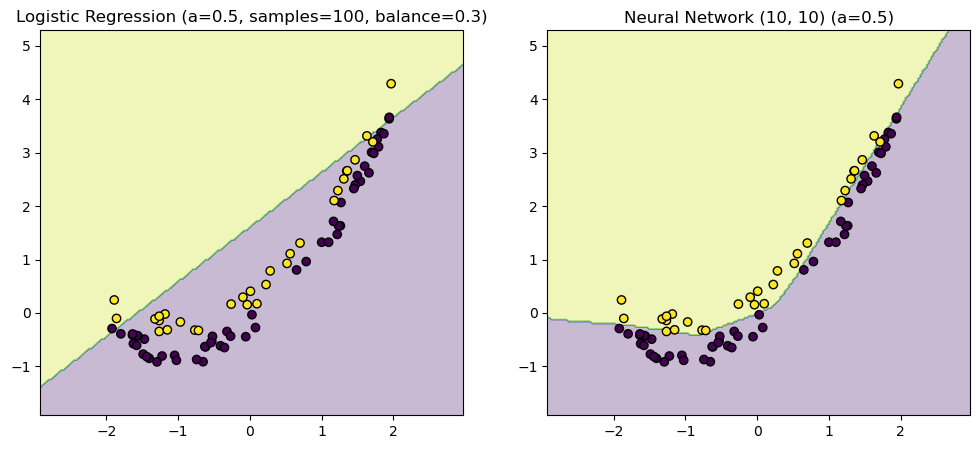

Generated data: X shape (83,), y length 83


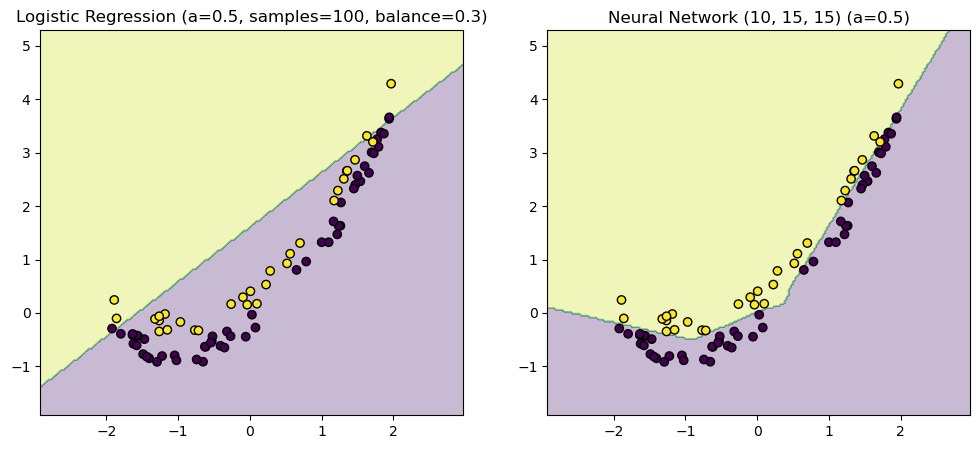

Generated data: X shape (97,), y length 97


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


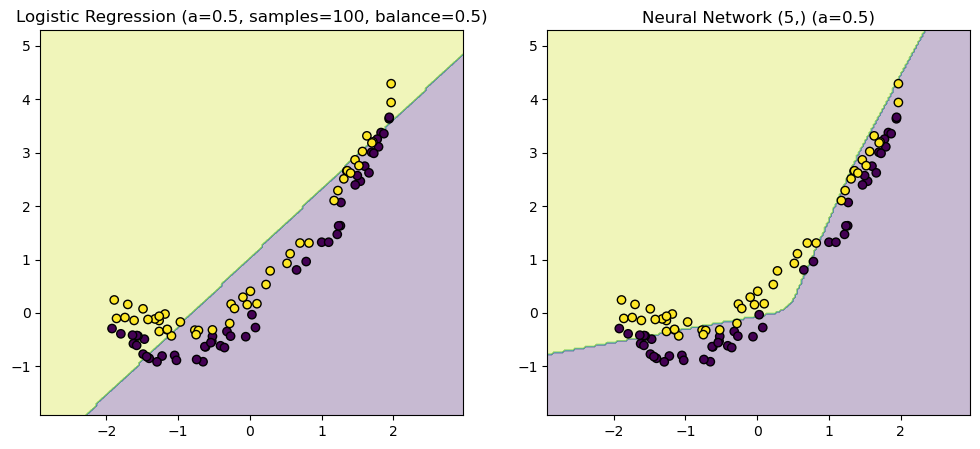

Generated data: X shape (97,), y length 97


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


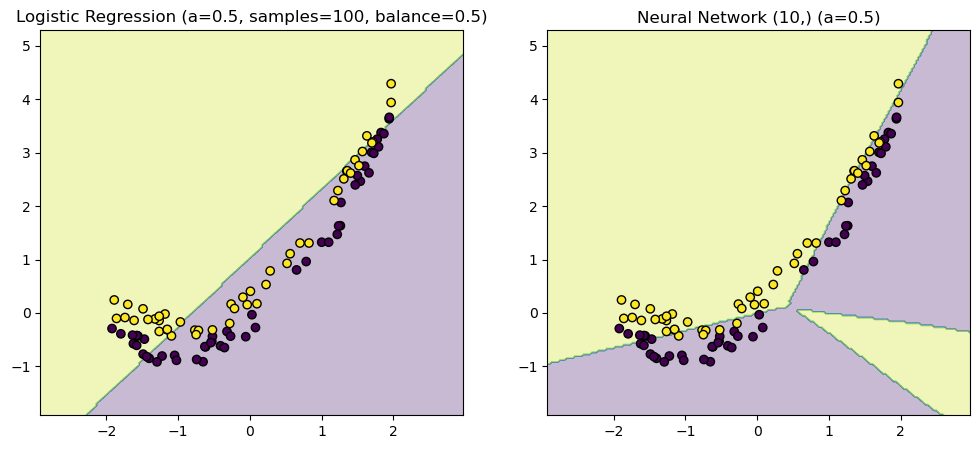

Generated data: X shape (97,), y length 97


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


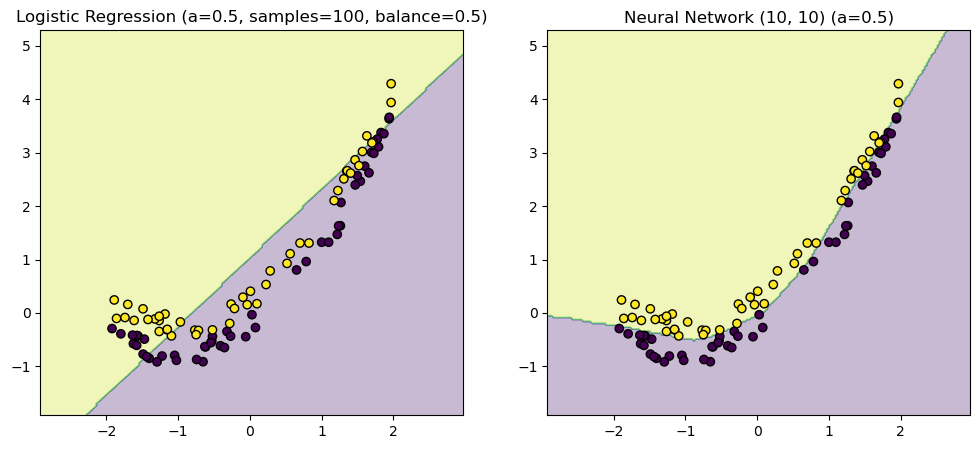

Generated data: X shape (97,), y length 97


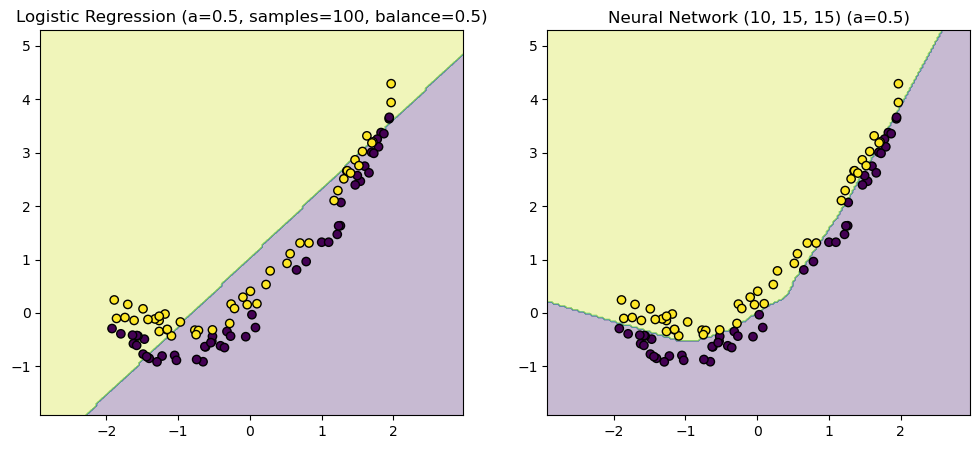

Generated data: X shape (77,), y length 77


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


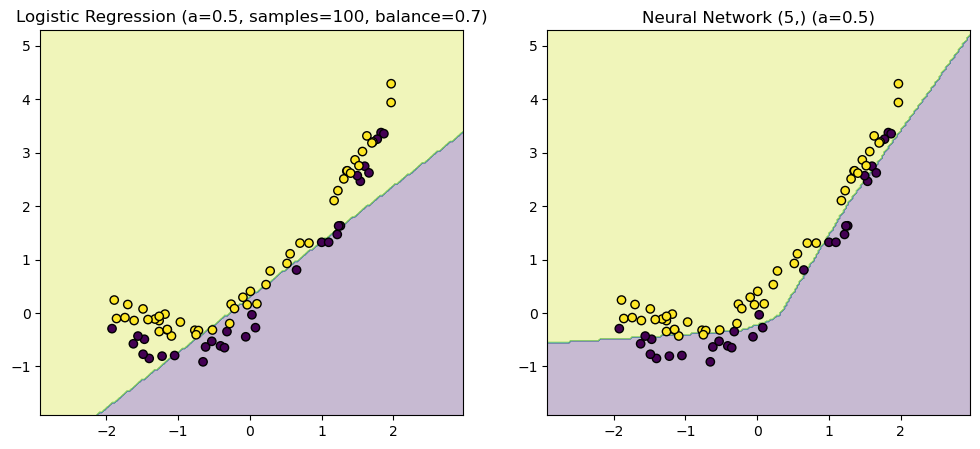

Generated data: X shape (77,), y length 77


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


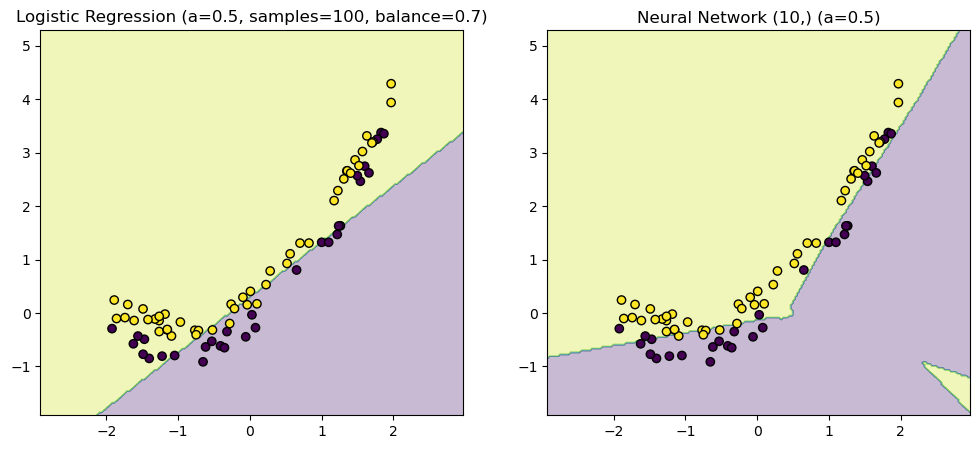

Generated data: X shape (77,), y length 77


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


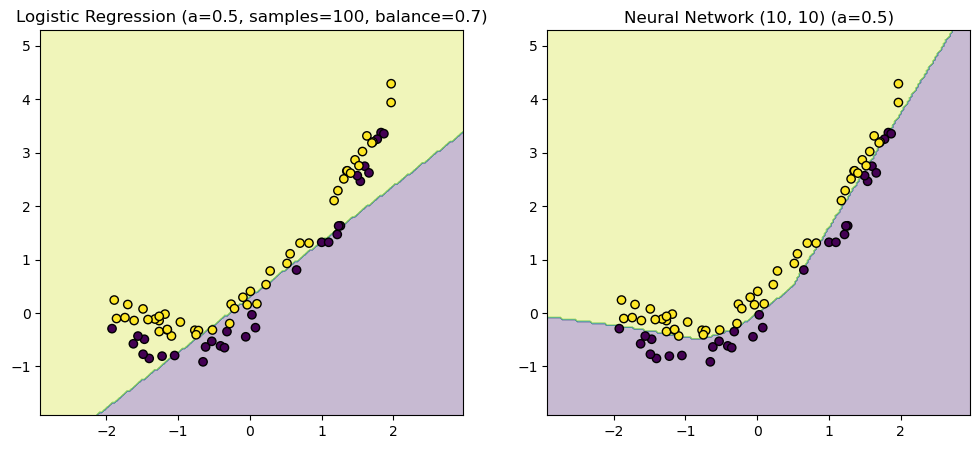

Generated data: X shape (77,), y length 77


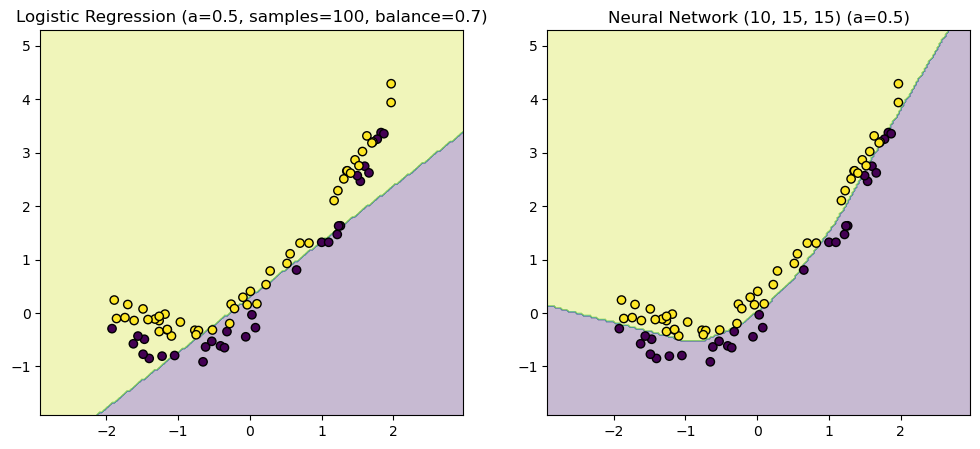

Generated data: X shape (248,), y length 248


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


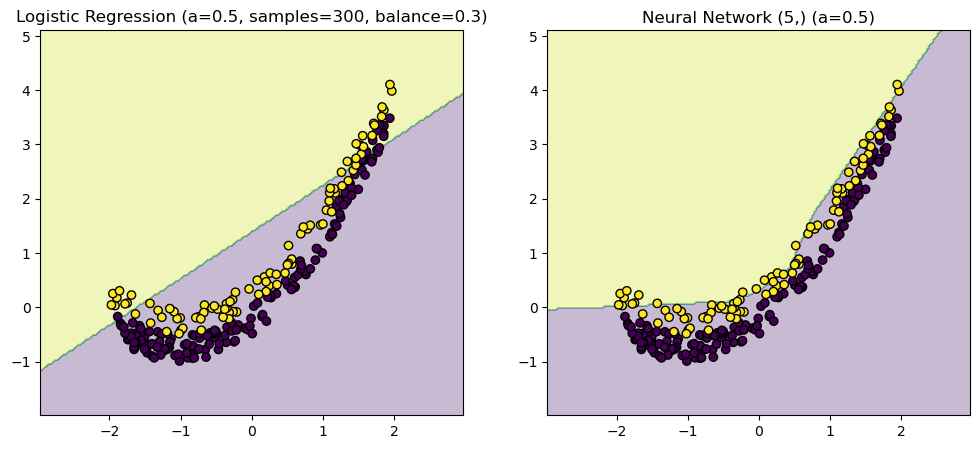

Generated data: X shape (248,), y length 248


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


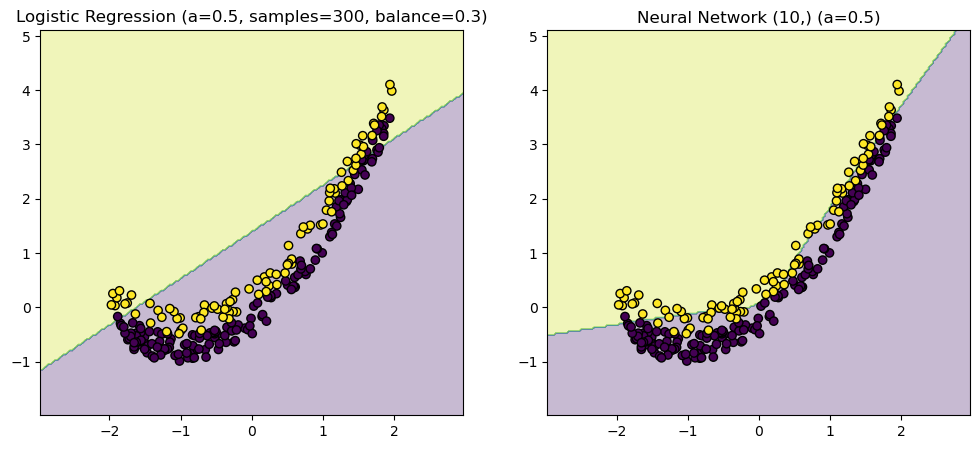

Generated data: X shape (248,), y length 248


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


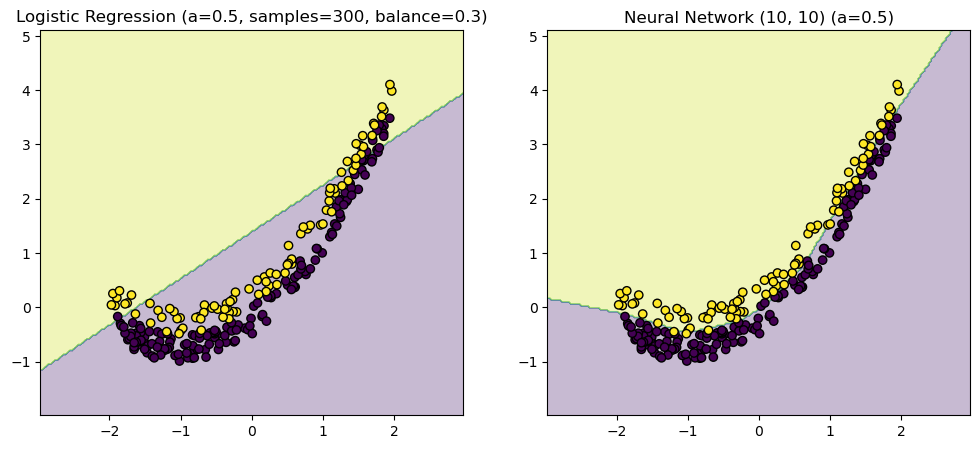

Generated data: X shape (248,), y length 248


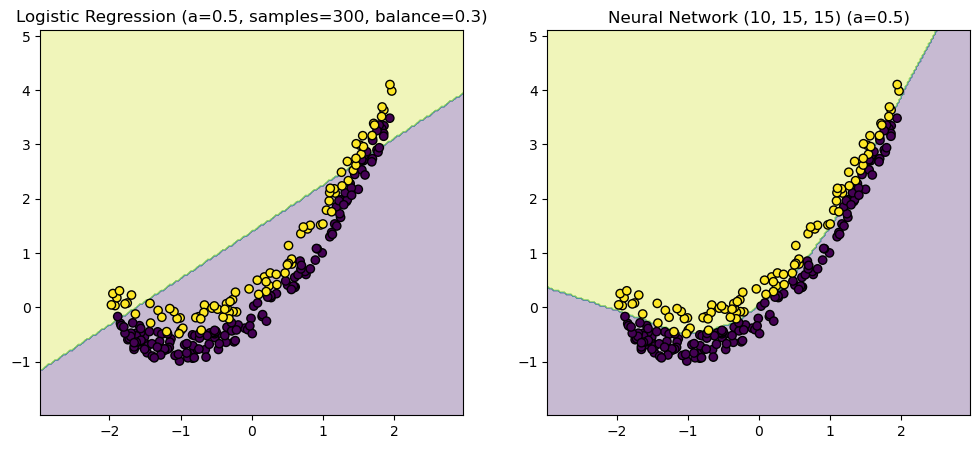

Generated data: X shape (292,), y length 292


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


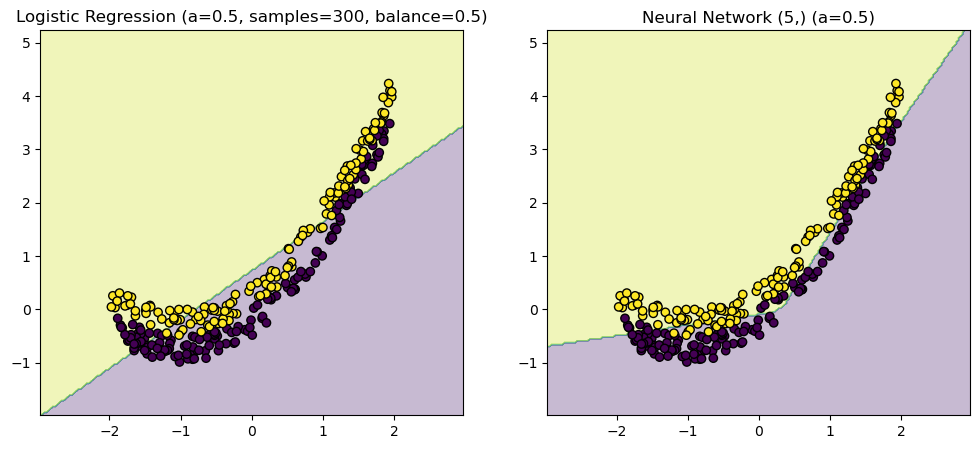

Generated data: X shape (292,), y length 292


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


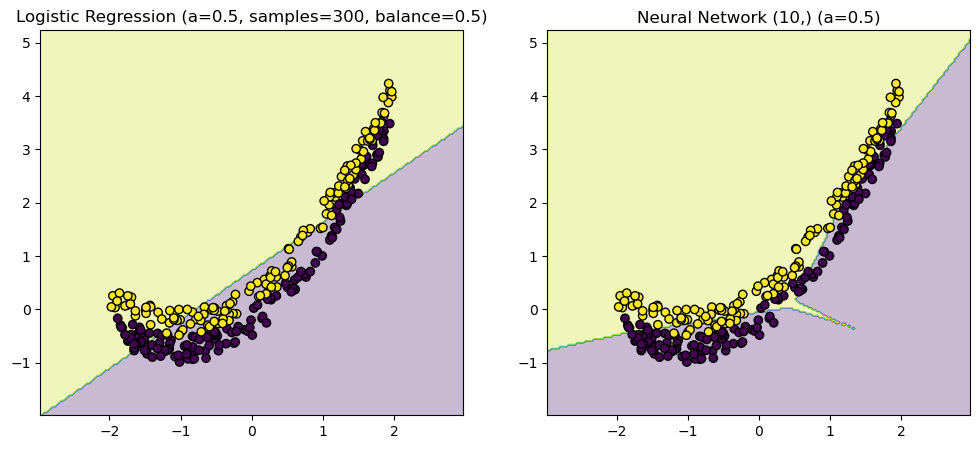

Generated data: X shape (292,), y length 292


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


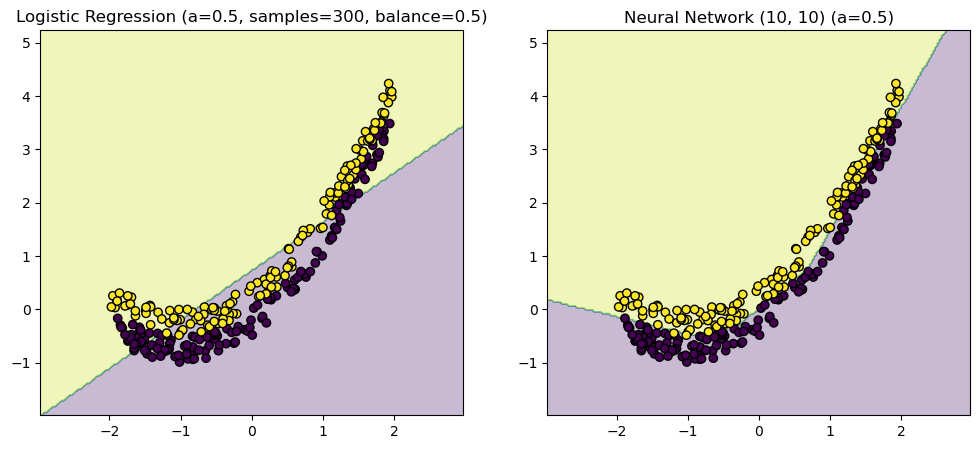

Generated data: X shape (292,), y length 292


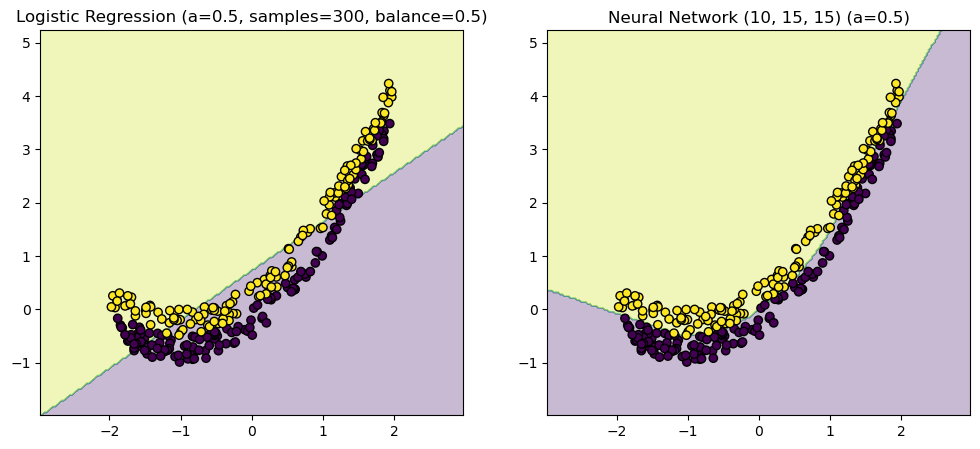

Generated data: X shape (232,), y length 232


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


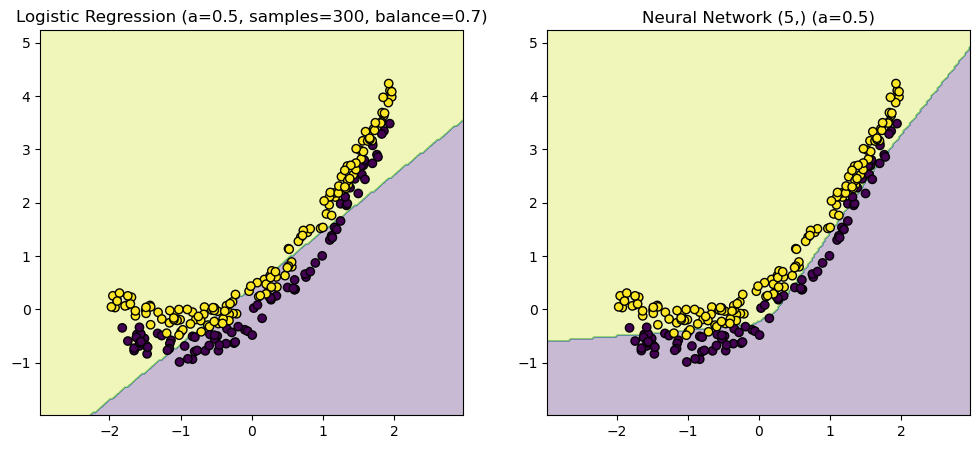

Generated data: X shape (232,), y length 232


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


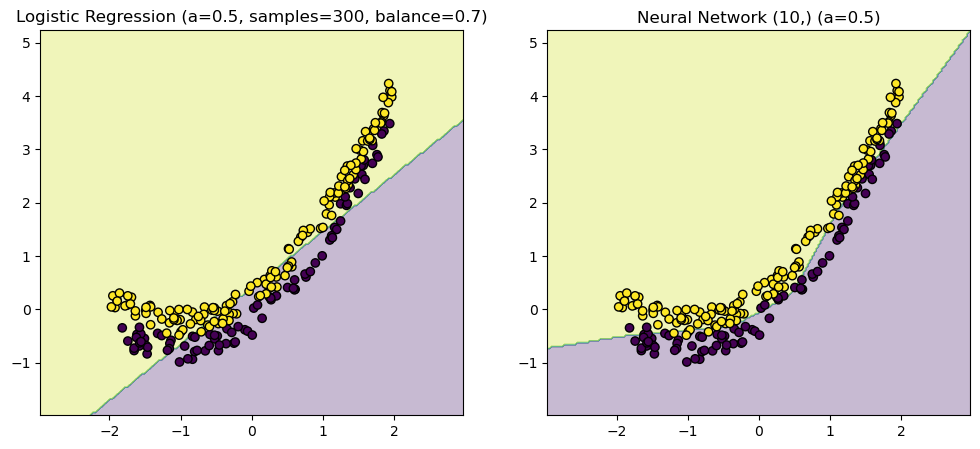

Generated data: X shape (232,), y length 232


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


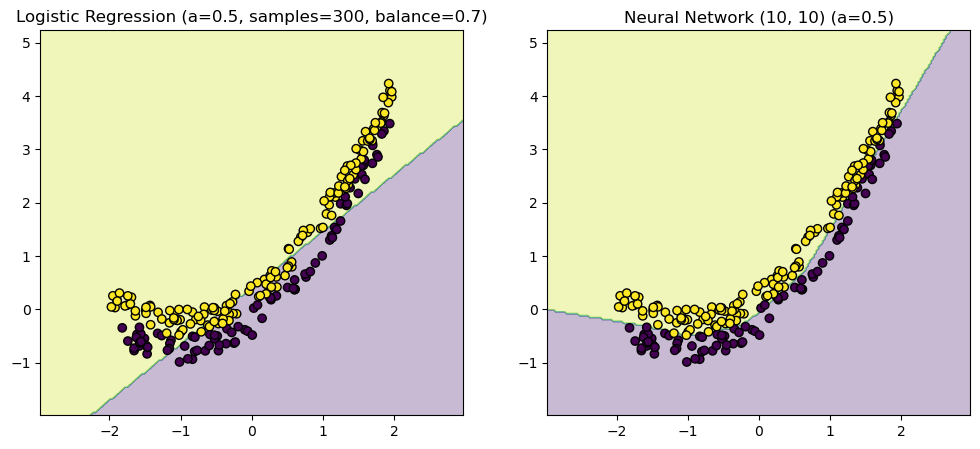

Generated data: X shape (232,), y length 232


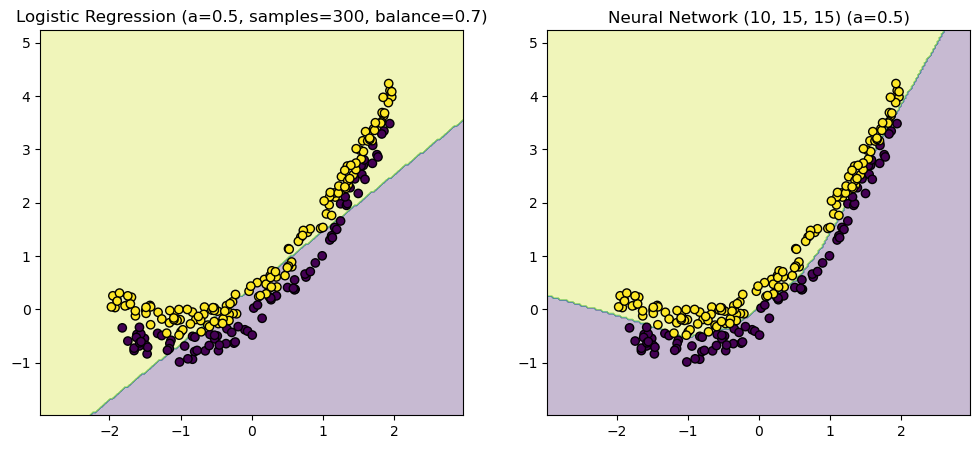

Generated data: X shape (408,), y length 408


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


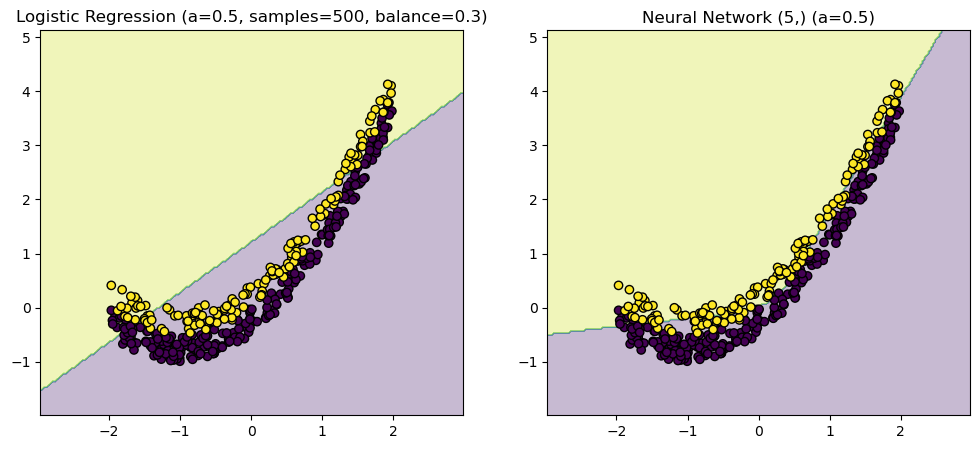

Generated data: X shape (408,), y length 408


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


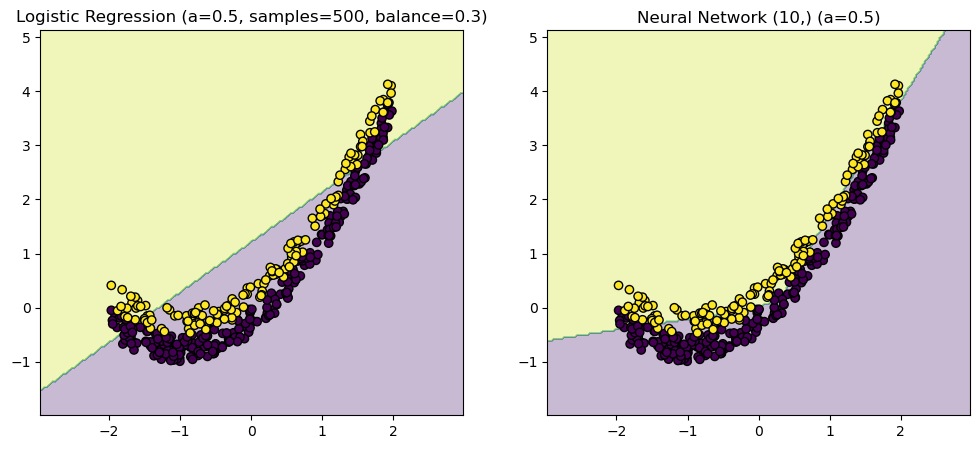

Generated data: X shape (408,), y length 408


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


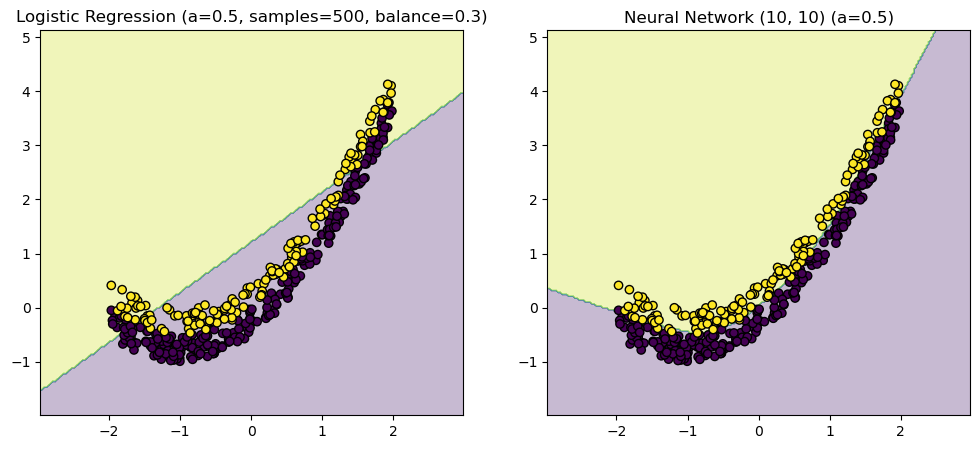

Generated data: X shape (408,), y length 408


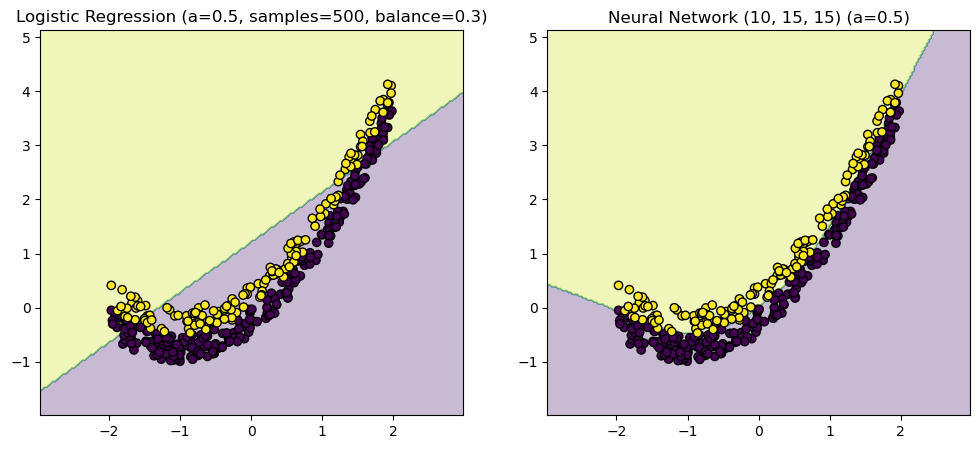

Generated data: X shape (492,), y length 492


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


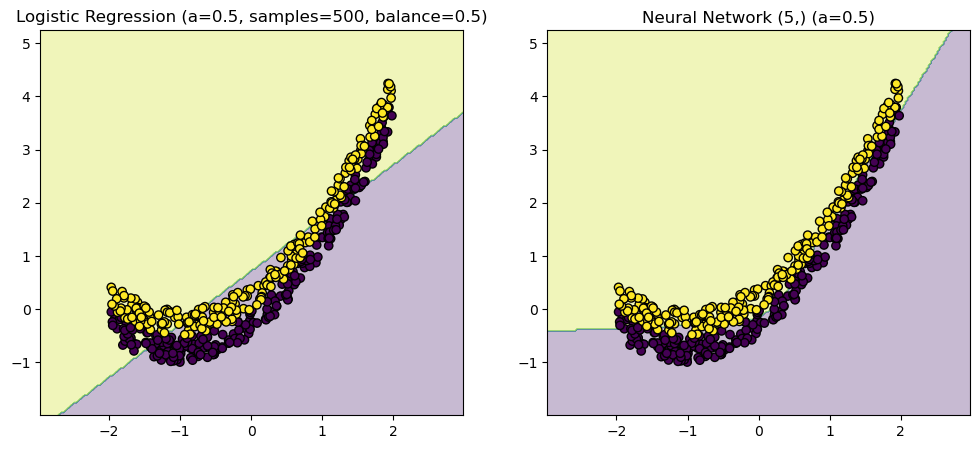

Generated data: X shape (492,), y length 492


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


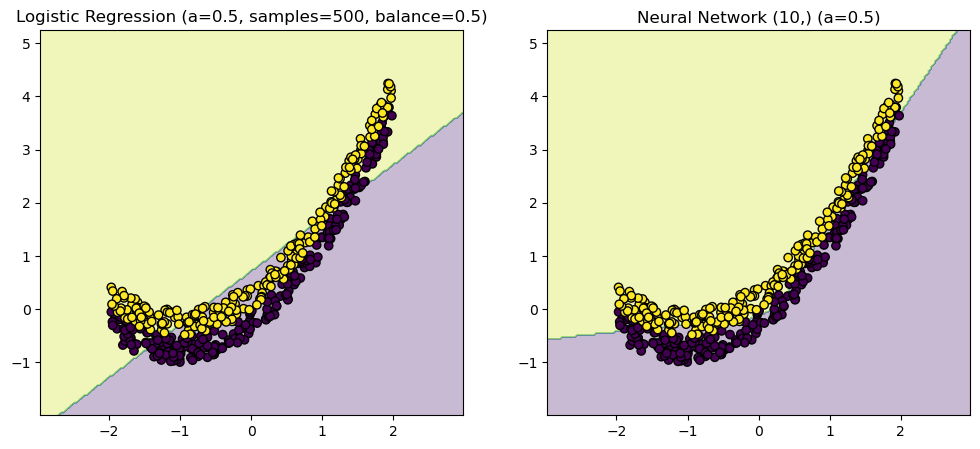

Generated data: X shape (492,), y length 492


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


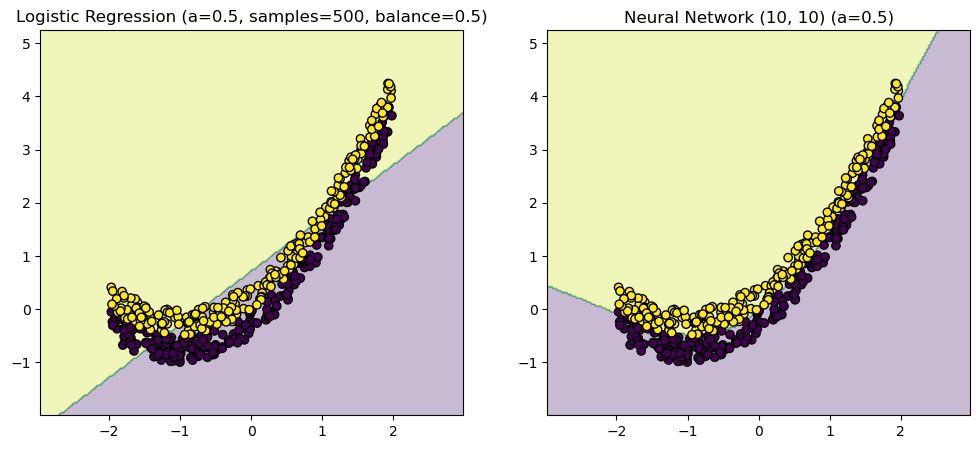

Generated data: X shape (492,), y length 492


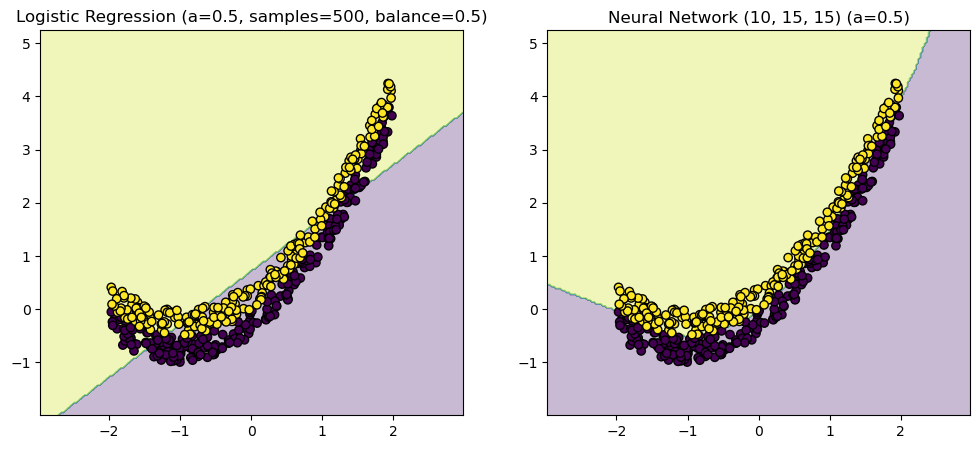

Generated data: X shape (392,), y length 392


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


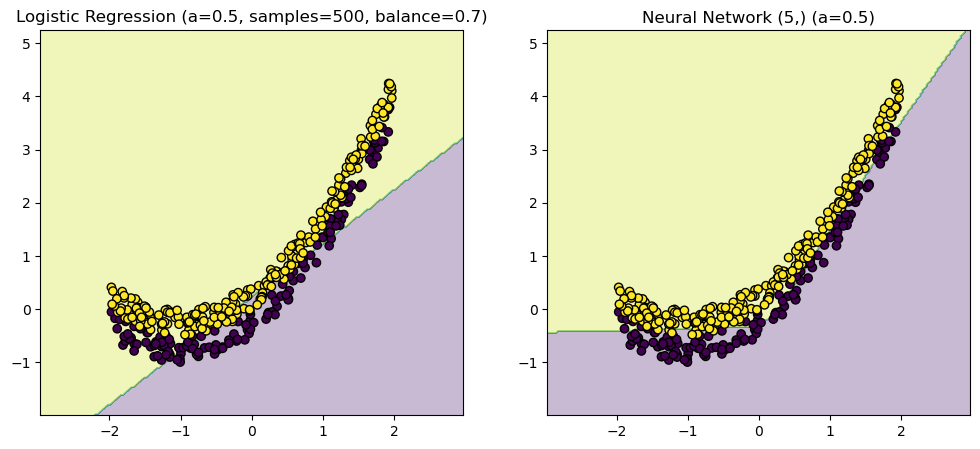

Generated data: X shape (392,), y length 392


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


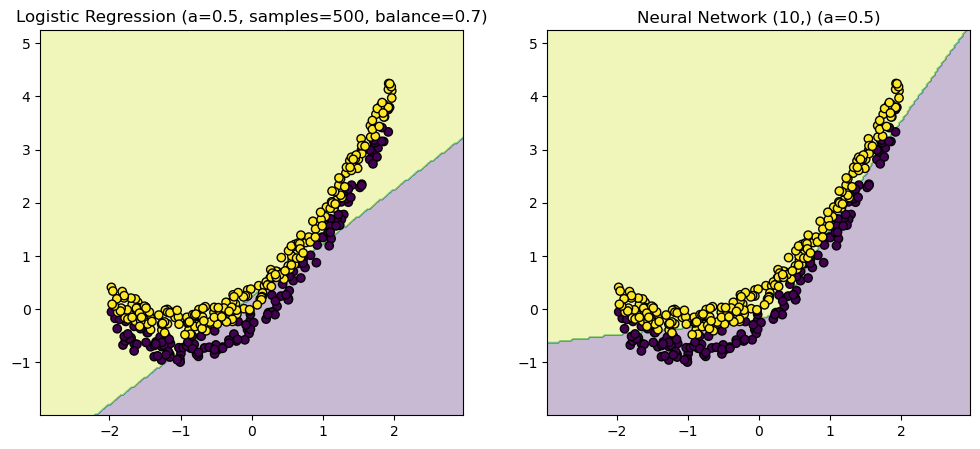

Generated data: X shape (392,), y length 392


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


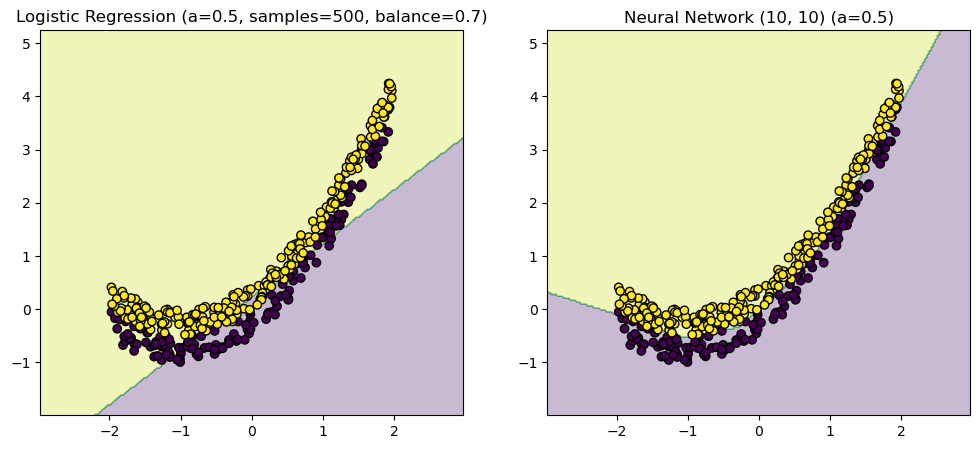

Generated data: X shape (392,), y length 392


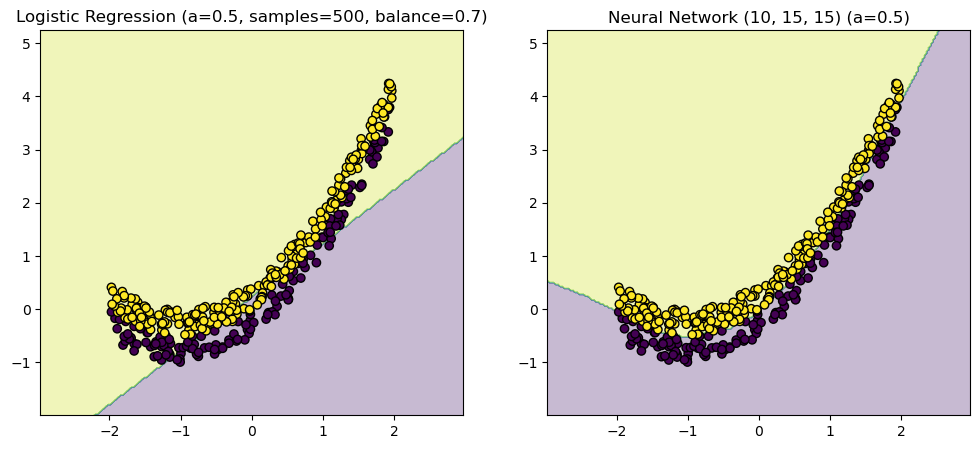

Generated data: X shape (83,), y length 83


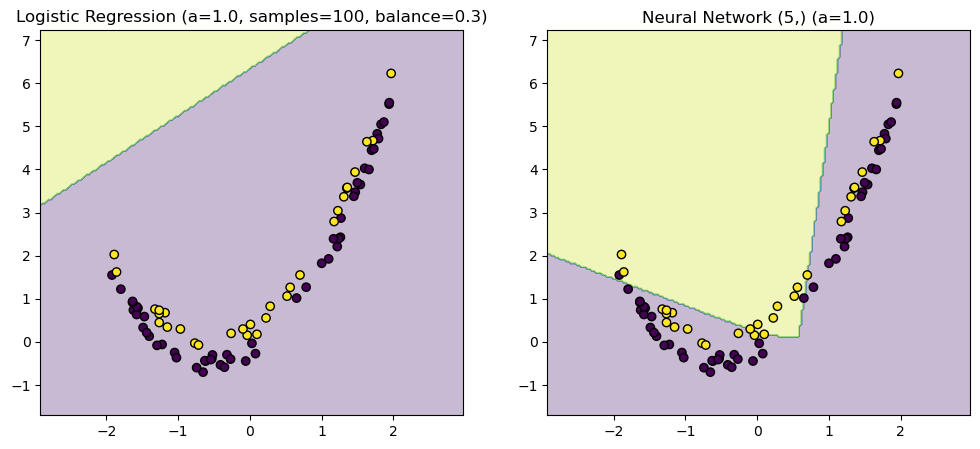

Generated data: X shape (83,), y length 83


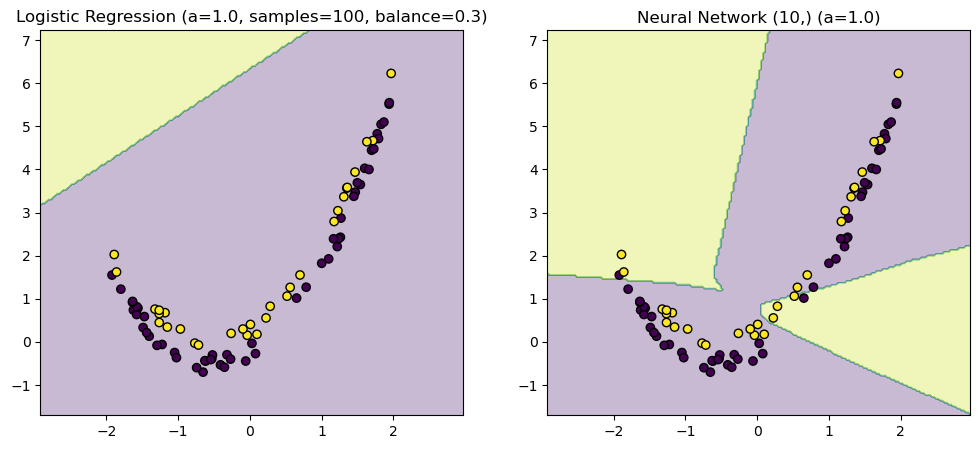

Generated data: X shape (83,), y length 83


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


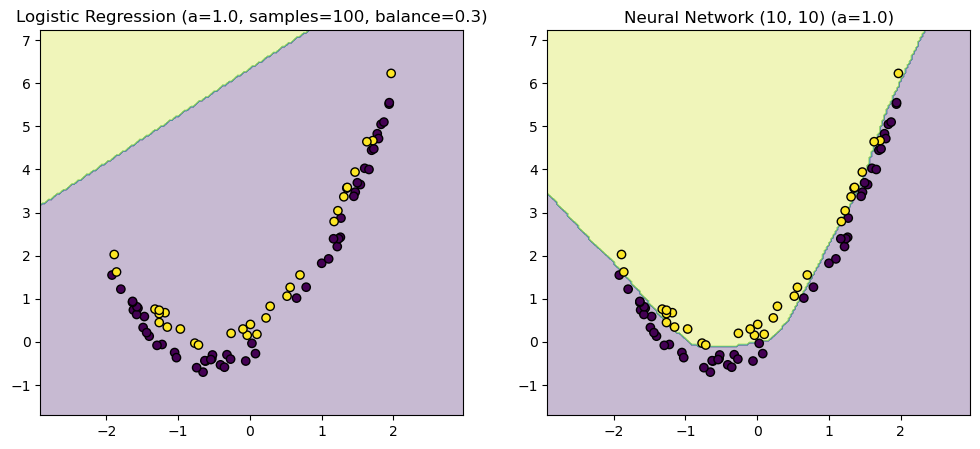

Generated data: X shape (83,), y length 83


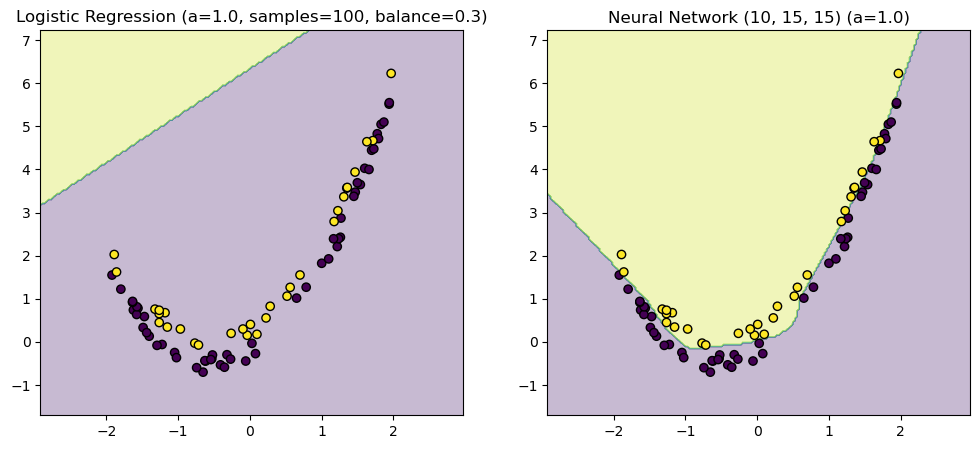

Generated data: X shape (97,), y length 97


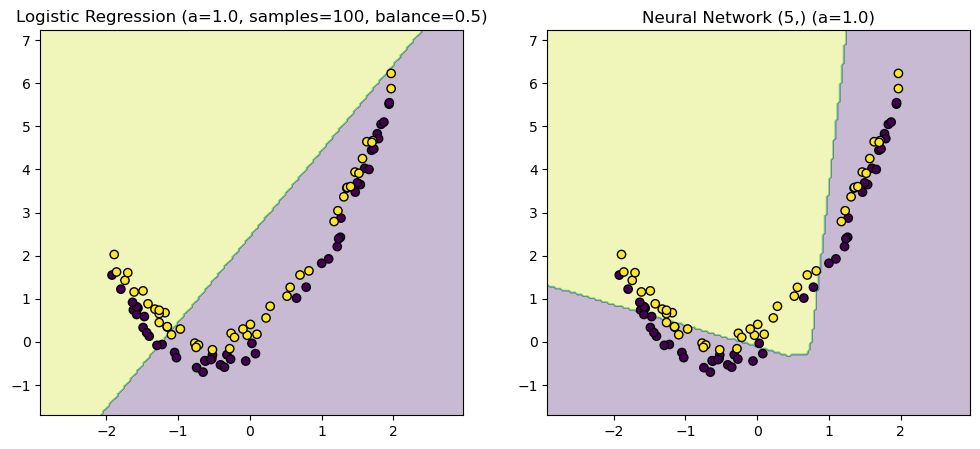

Generated data: X shape (97,), y length 97


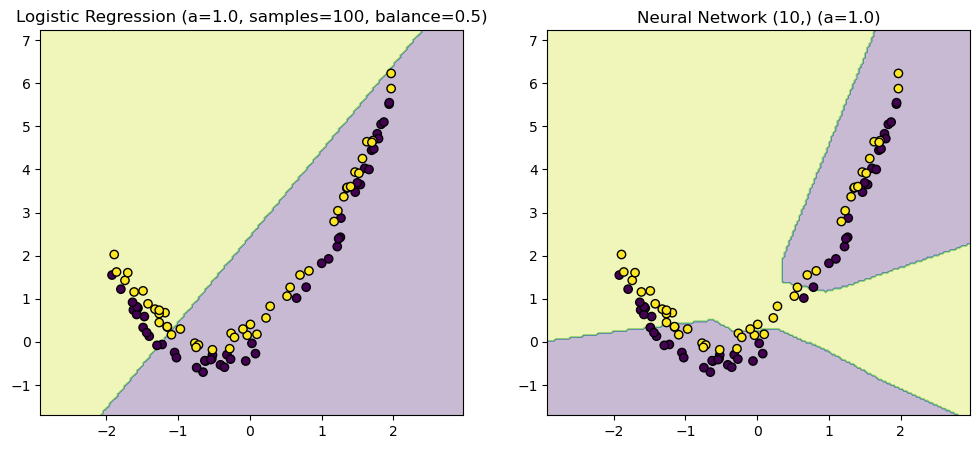

Generated data: X shape (97,), y length 97


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


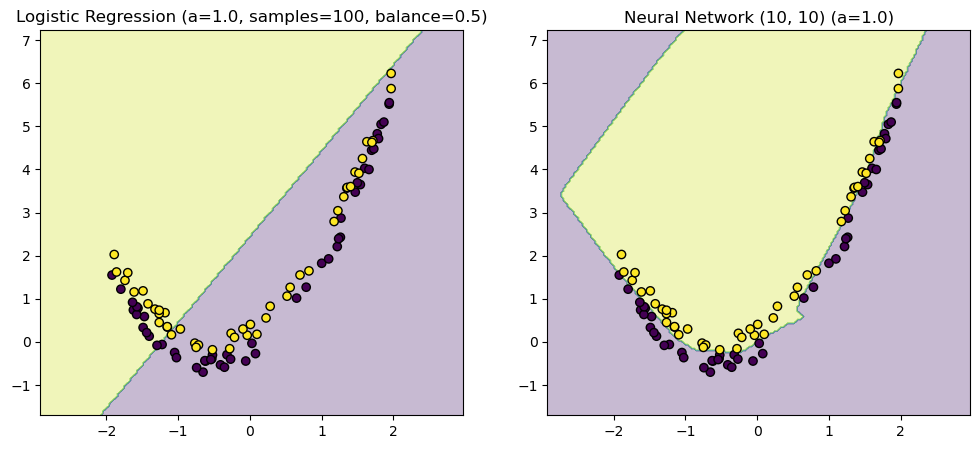

Generated data: X shape (97,), y length 97


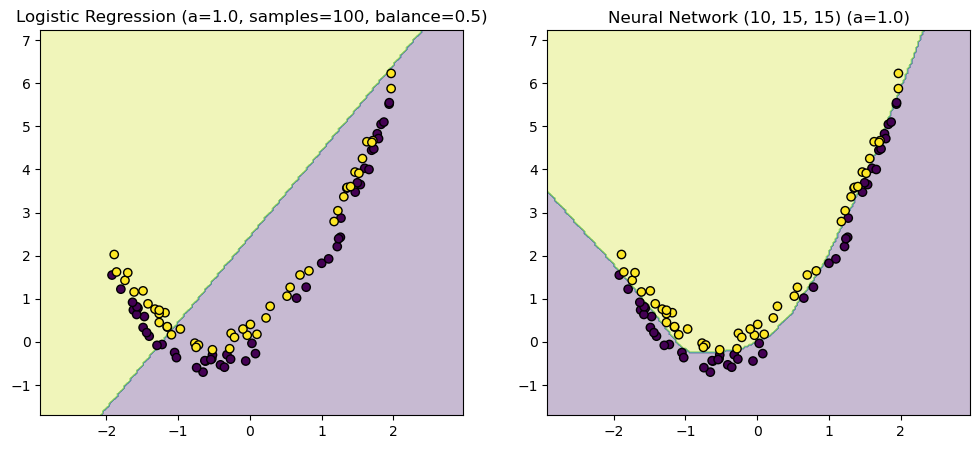

Generated data: X shape (77,), y length 77


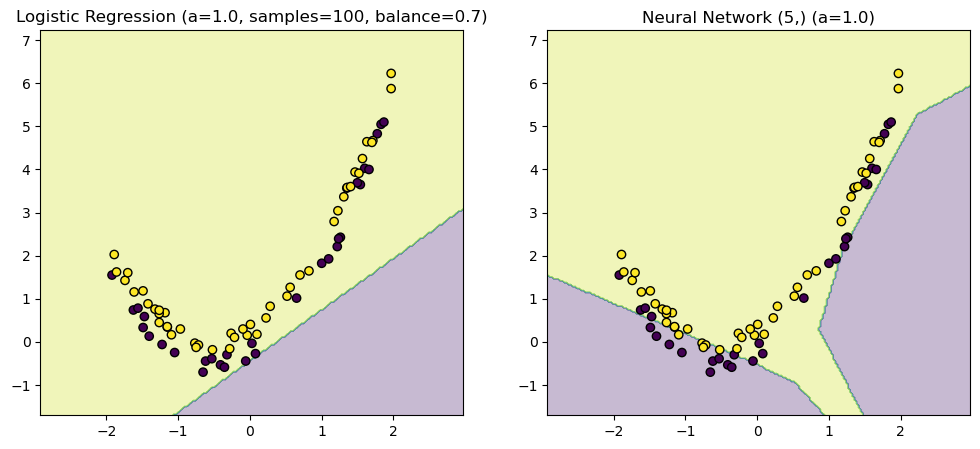

Generated data: X shape (77,), y length 77


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


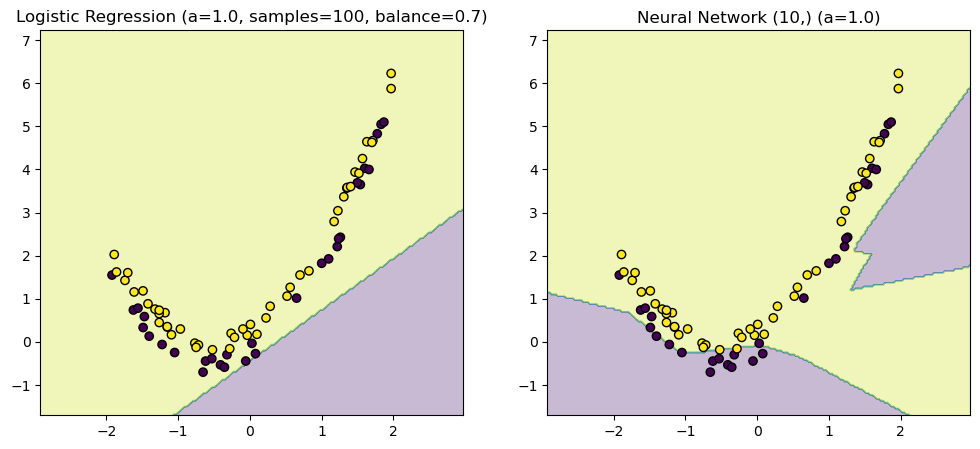

Generated data: X shape (77,), y length 77


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


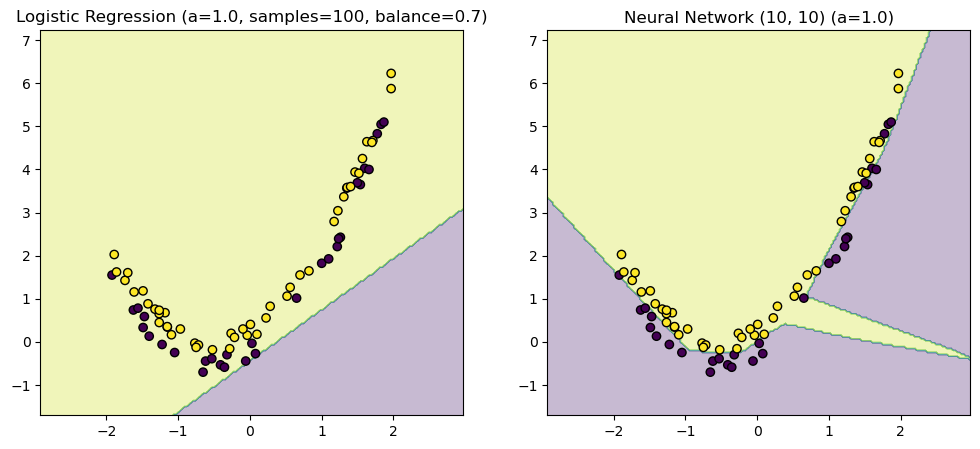

Generated data: X shape (77,), y length 77


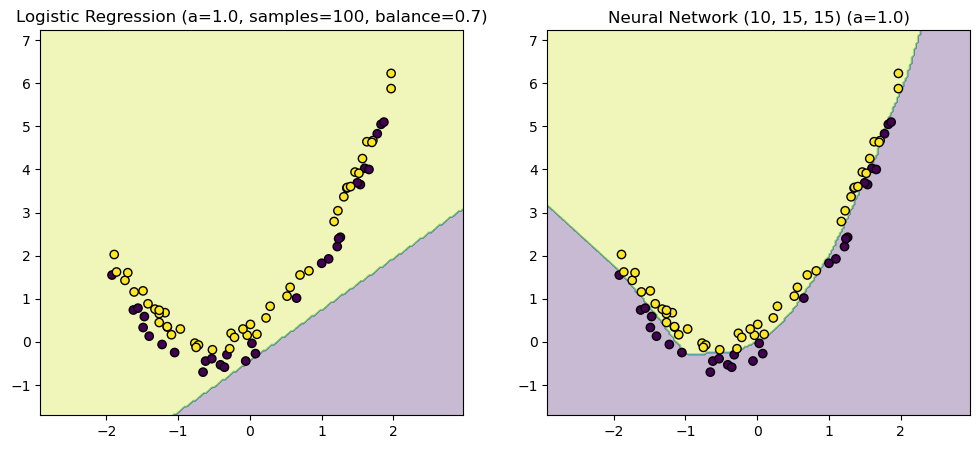

Generated data: X shape (248,), y length 248


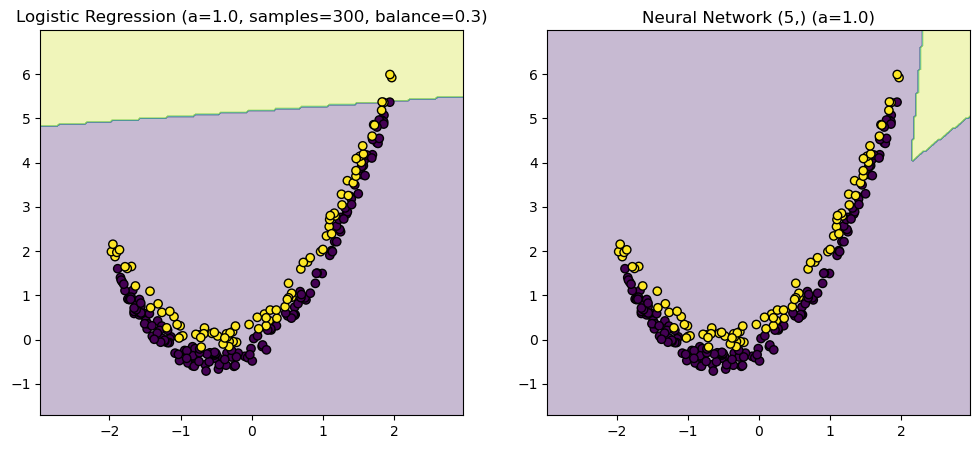

Generated data: X shape (248,), y length 248


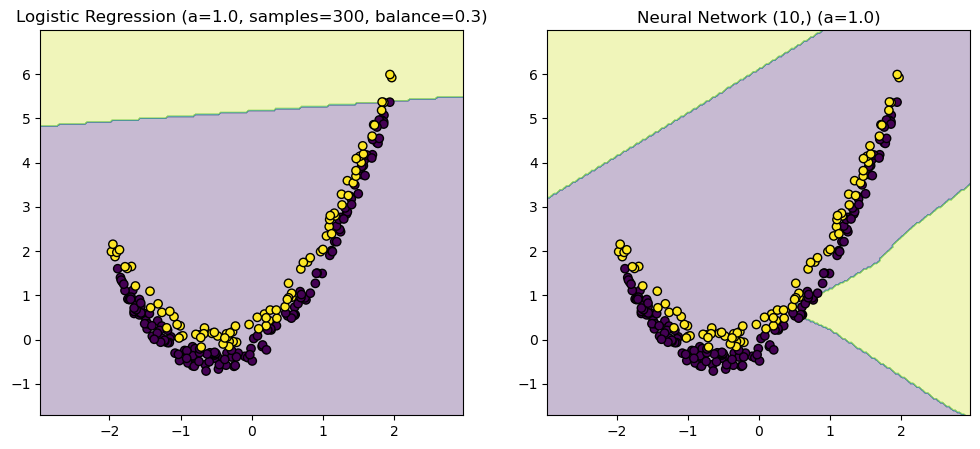

Generated data: X shape (248,), y length 248


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


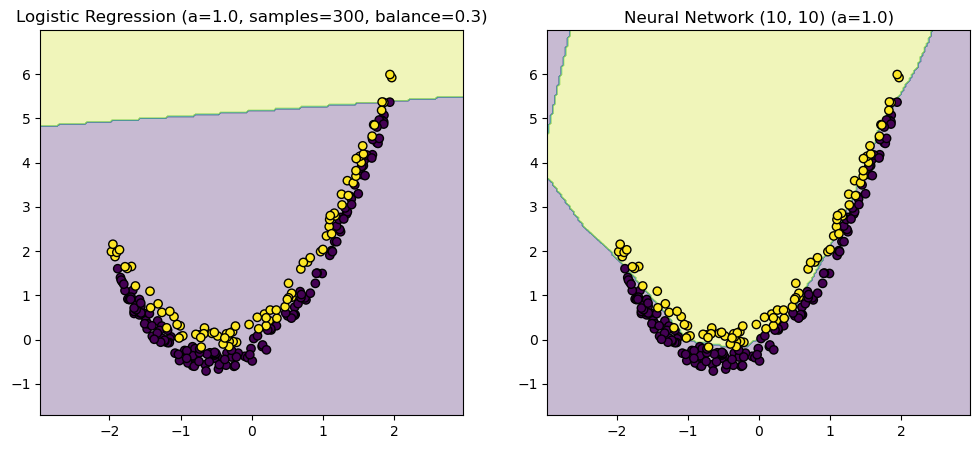

Generated data: X shape (248,), y length 248


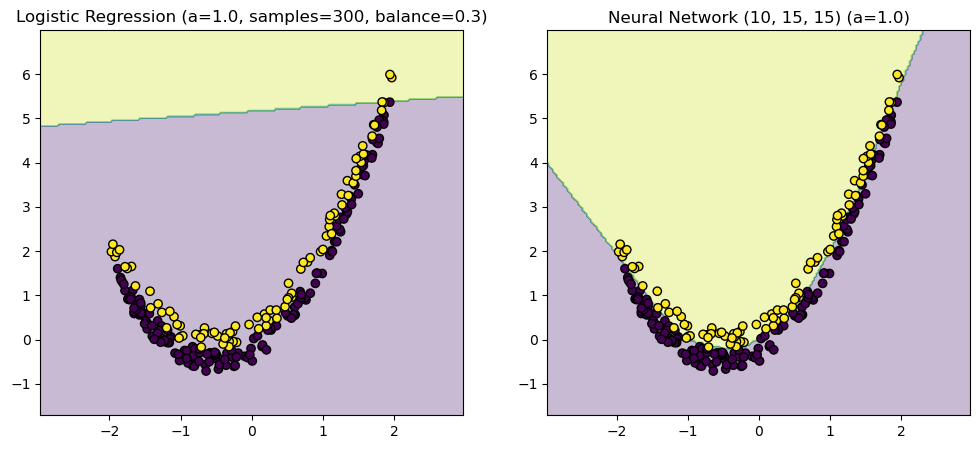

Generated data: X shape (292,), y length 292


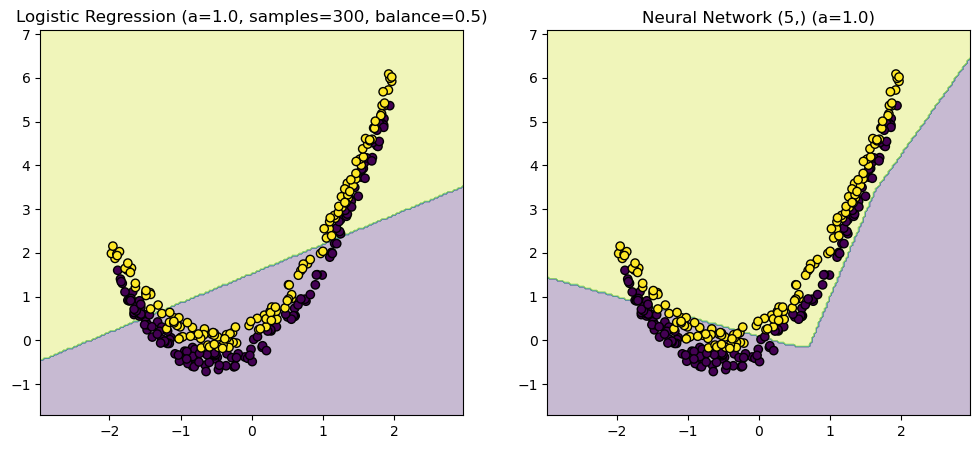

Generated data: X shape (292,), y length 292


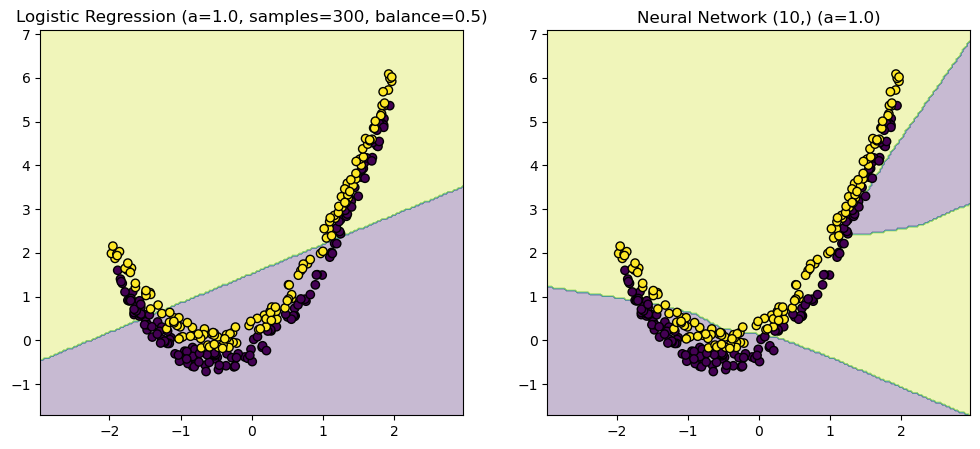

Generated data: X shape (292,), y length 292


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


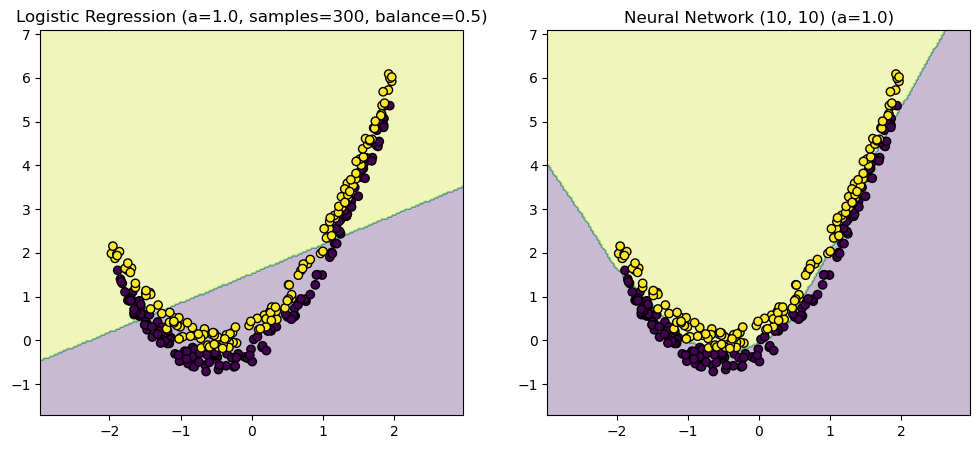

Generated data: X shape (292,), y length 292


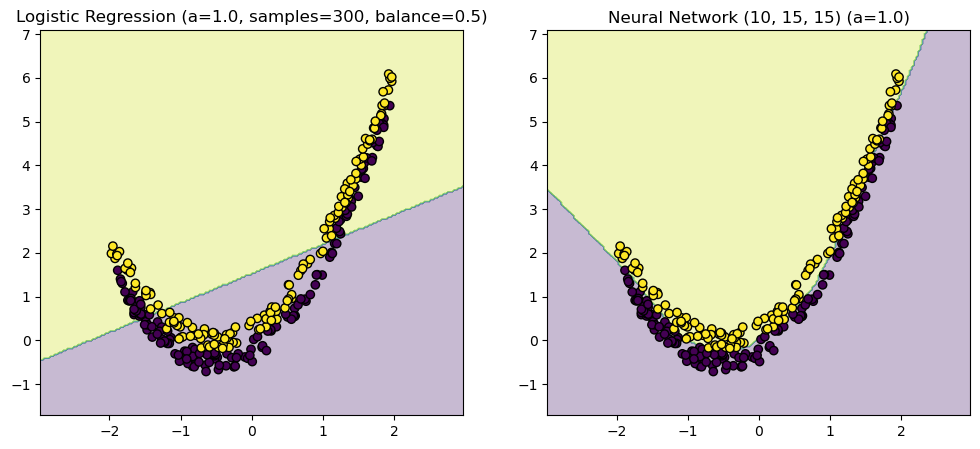

Generated data: X shape (232,), y length 232


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


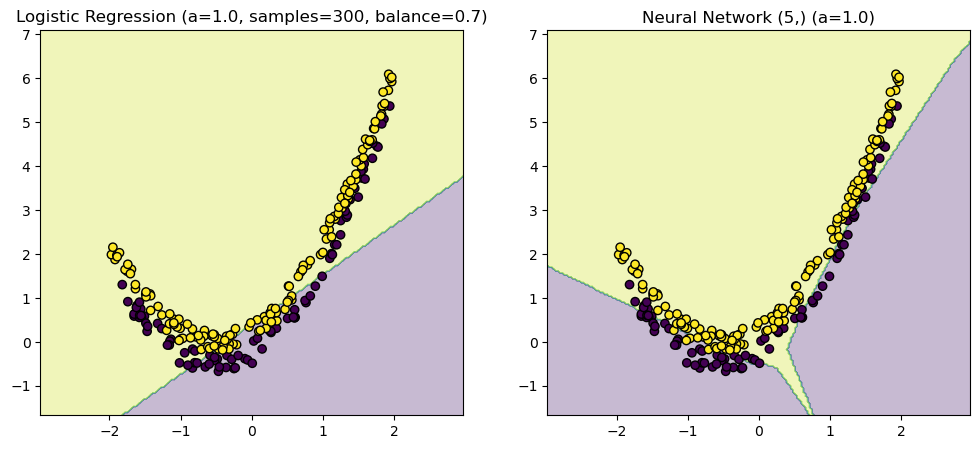

Generated data: X shape (232,), y length 232


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


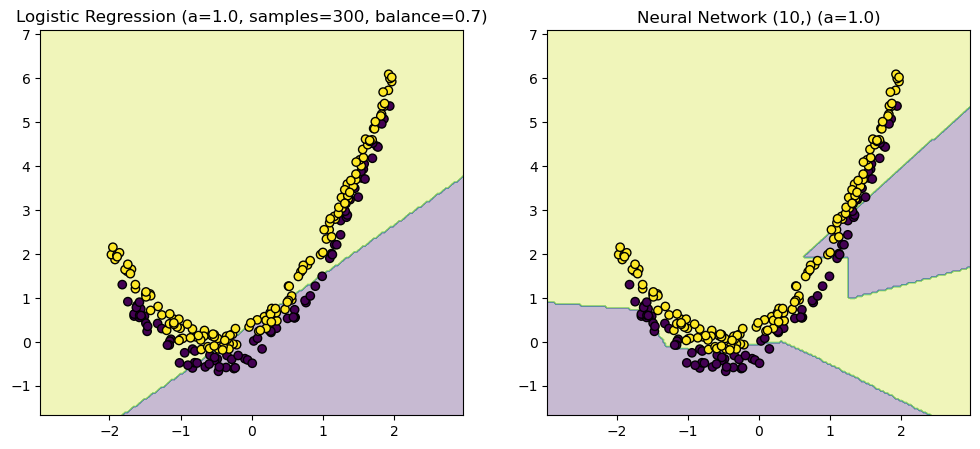

Generated data: X shape (232,), y length 232


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


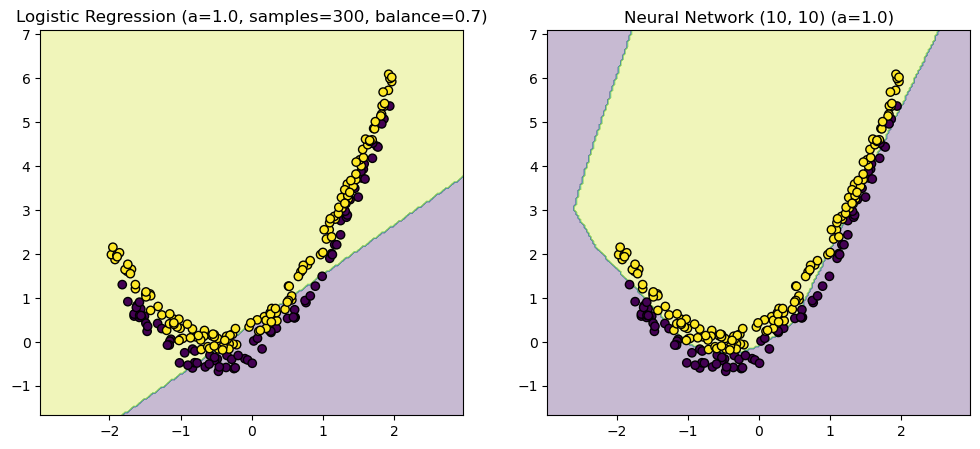

Generated data: X shape (232,), y length 232


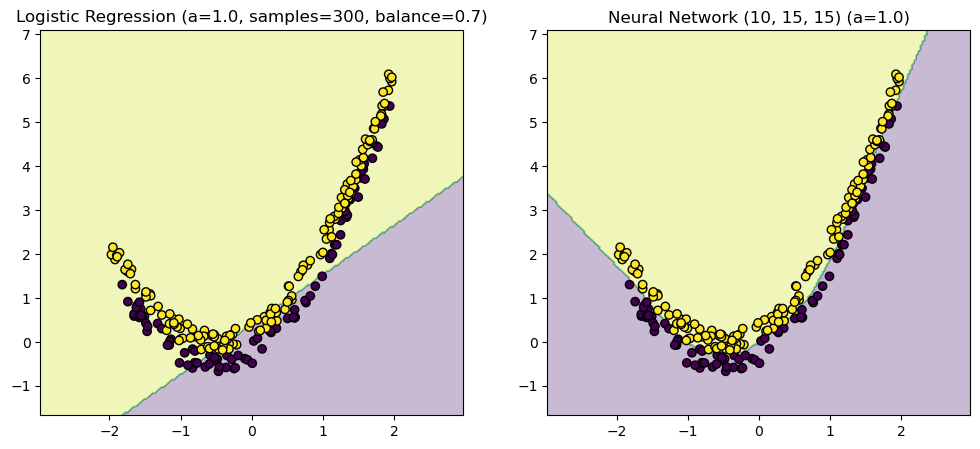

Generated data: X shape (408,), y length 408


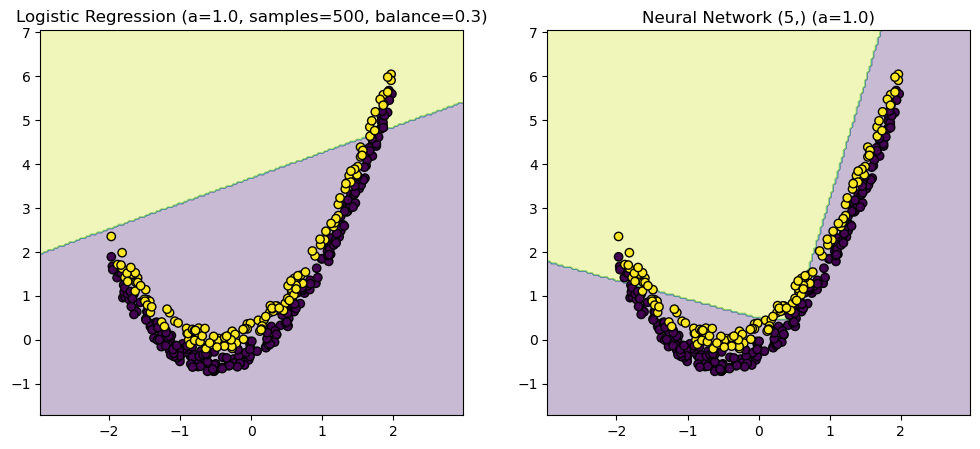

Generated data: X shape (408,), y length 408


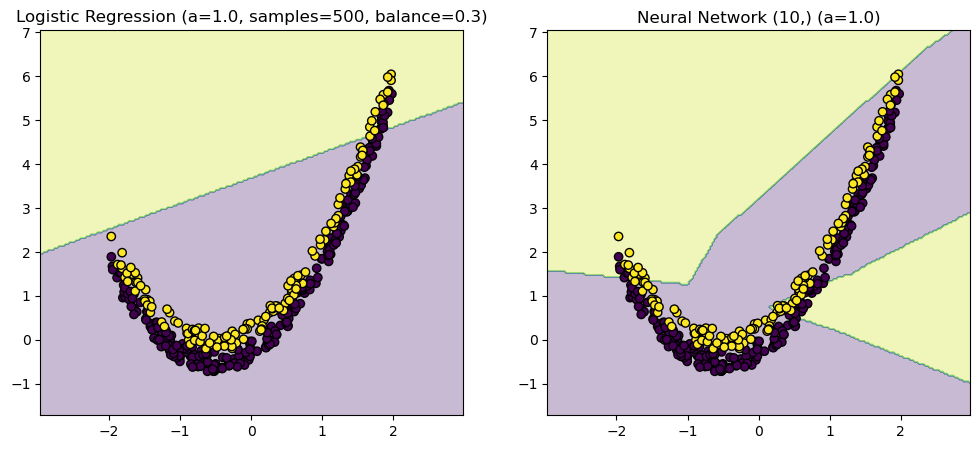

Generated data: X shape (408,), y length 408


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


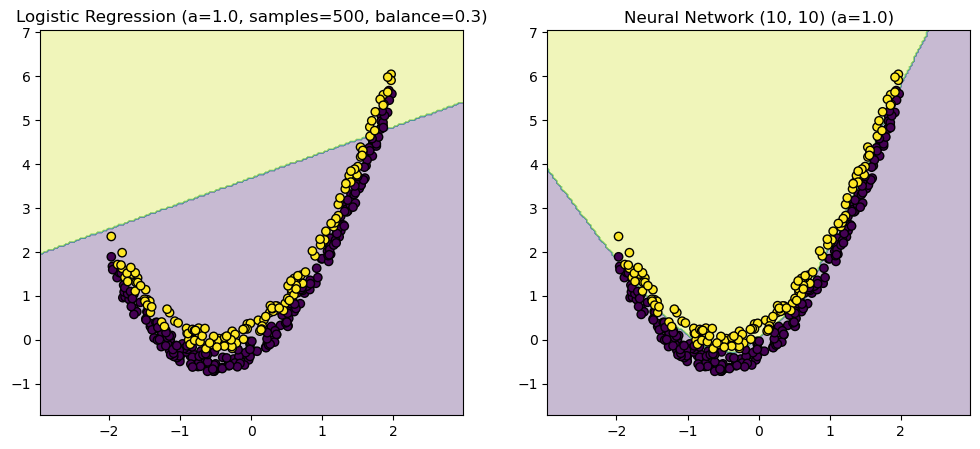

Generated data: X shape (408,), y length 408


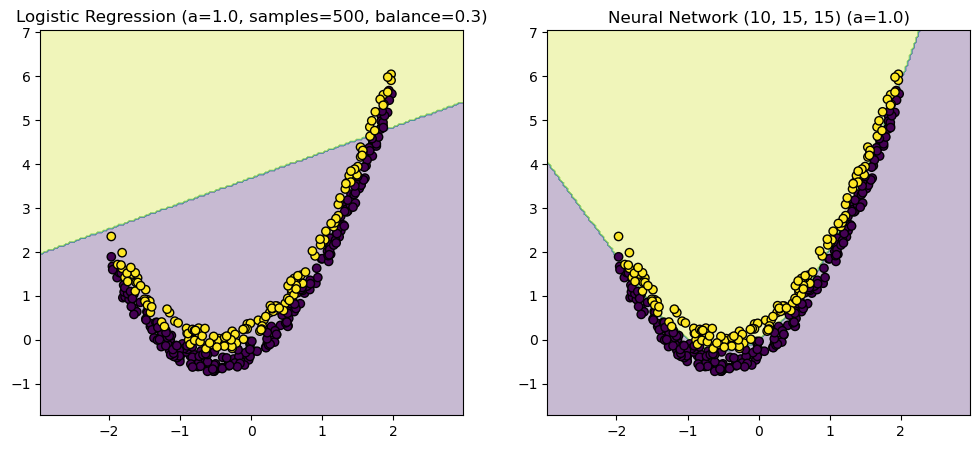

Generated data: X shape (492,), y length 492


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


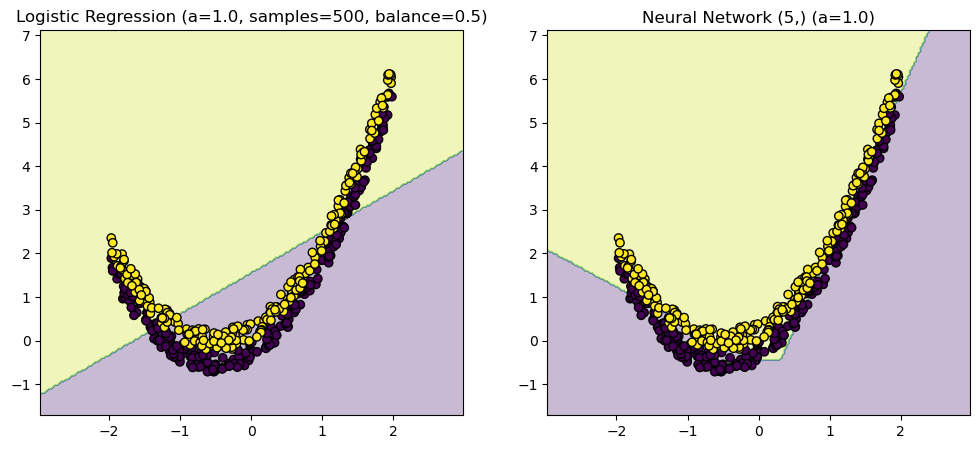

Generated data: X shape (492,), y length 492


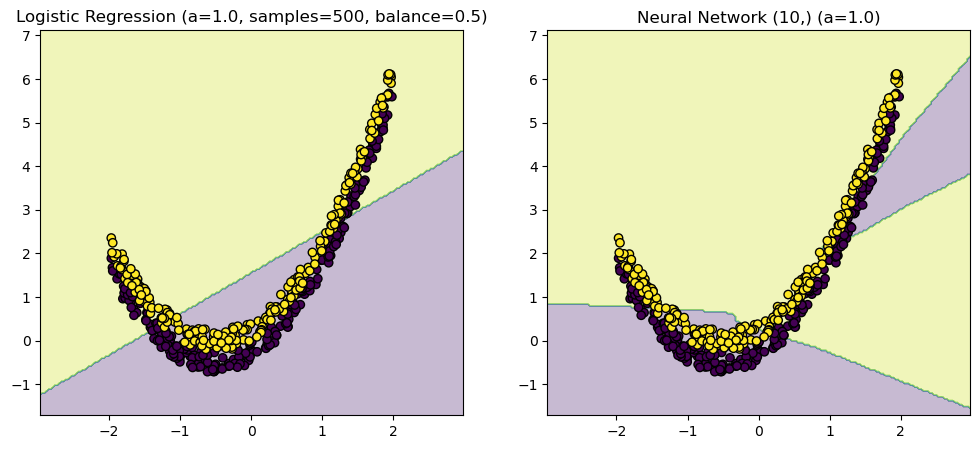

Generated data: X shape (492,), y length 492


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


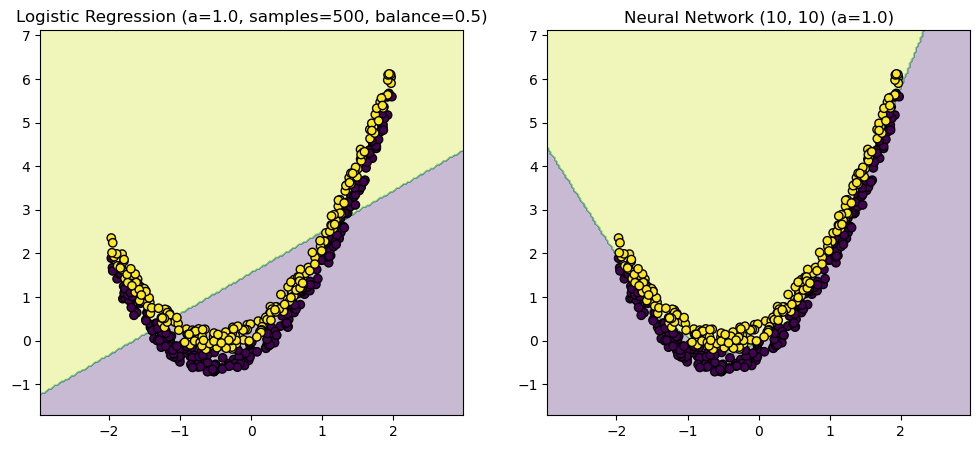

Generated data: X shape (492,), y length 492


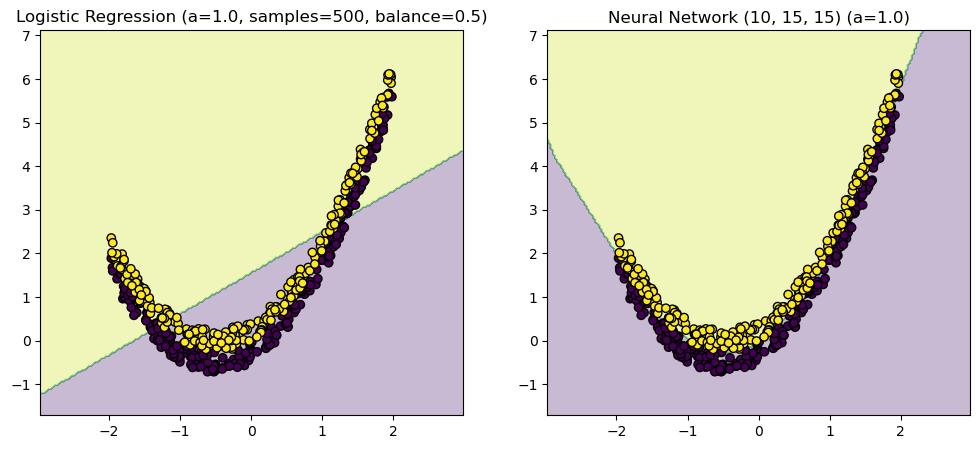

Generated data: X shape (392,), y length 392


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


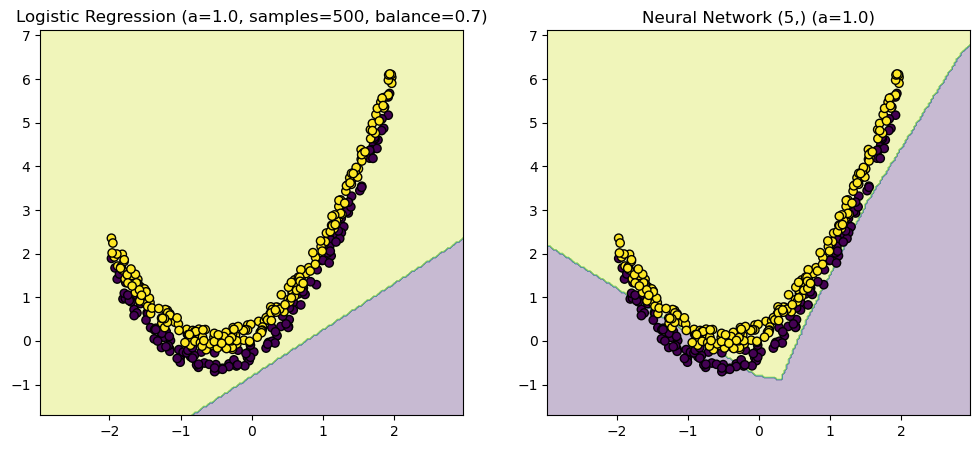

Generated data: X shape (392,), y length 392


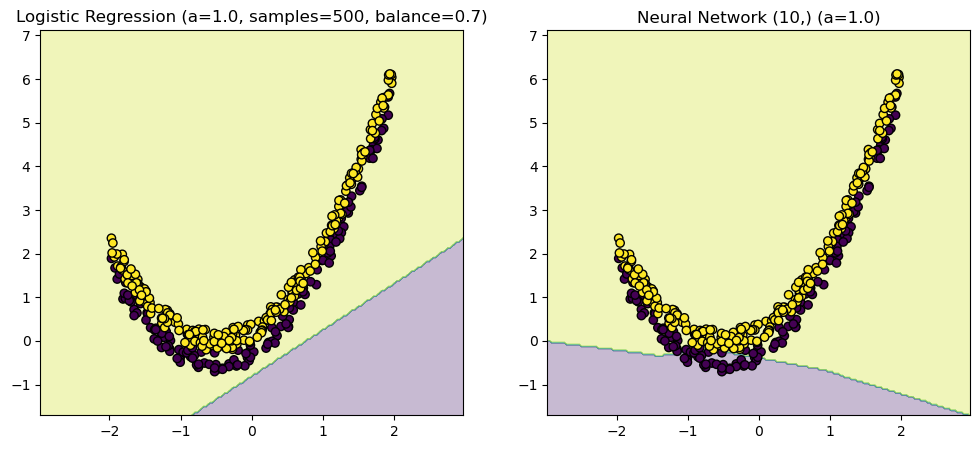

Generated data: X shape (392,), y length 392


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


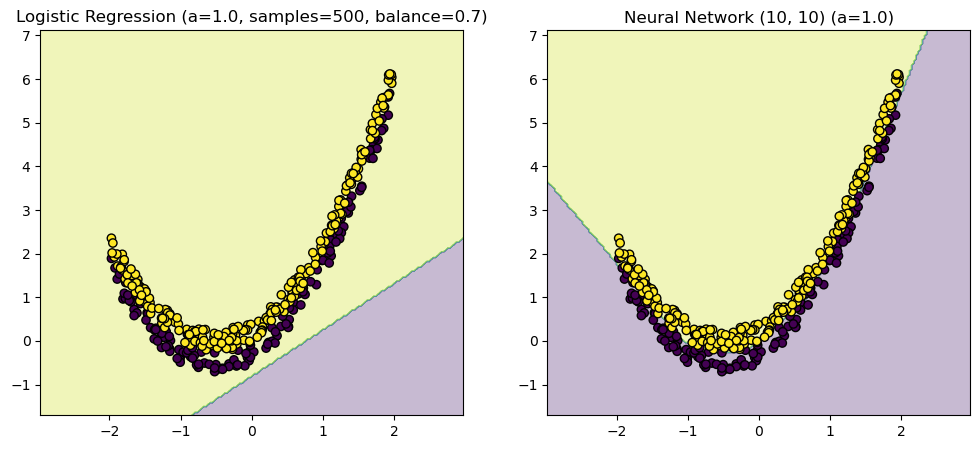

Generated data: X shape (392,), y length 392


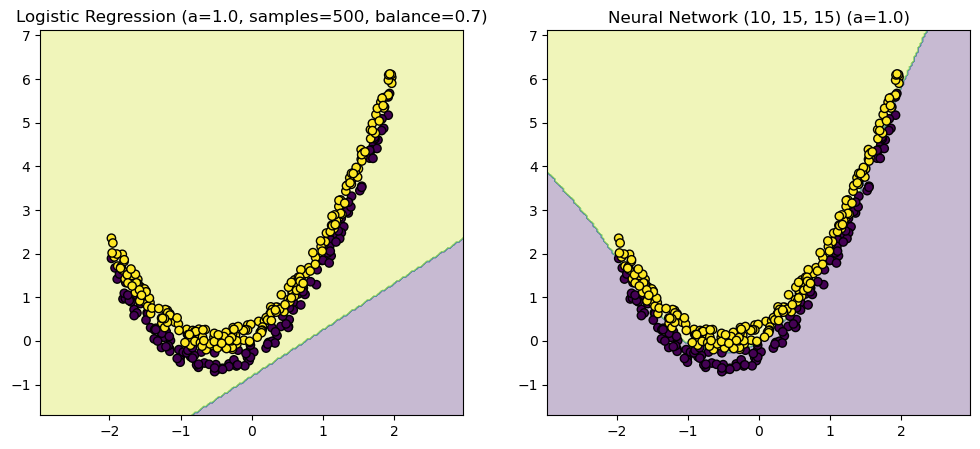

Generated data: X shape (83,), y length 83


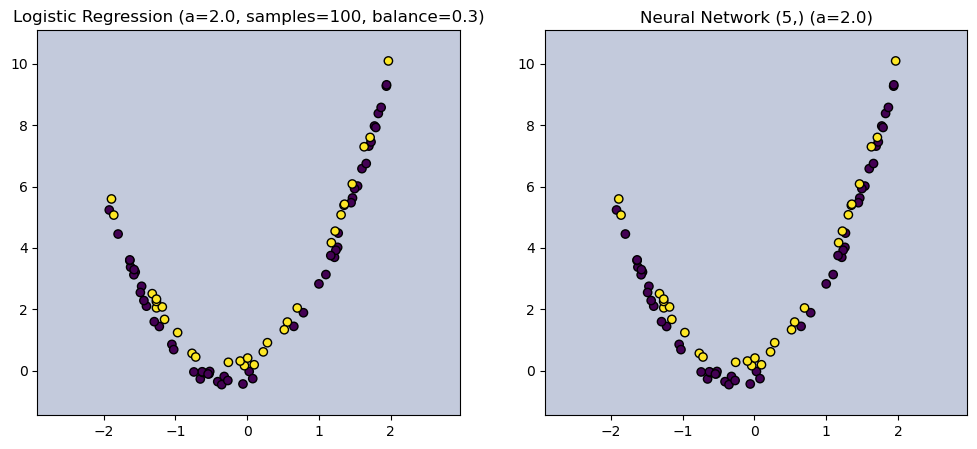

Generated data: X shape (83,), y length 83


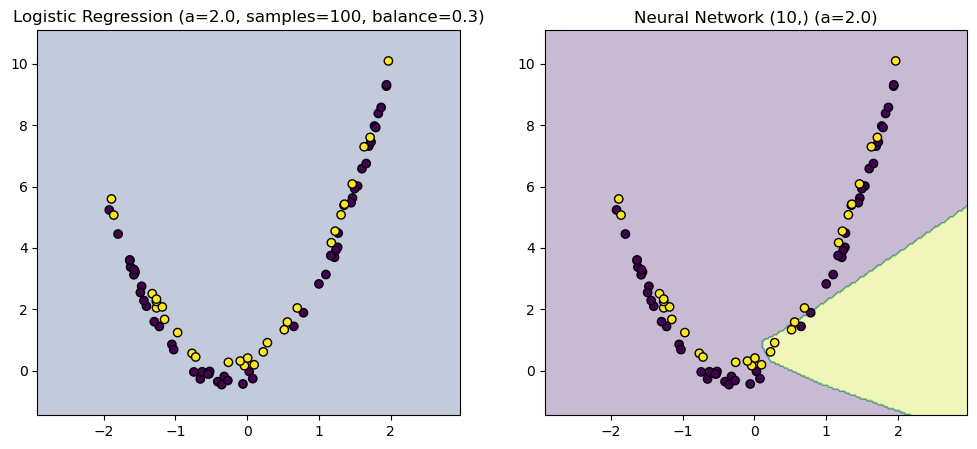

Generated data: X shape (83,), y length 83


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


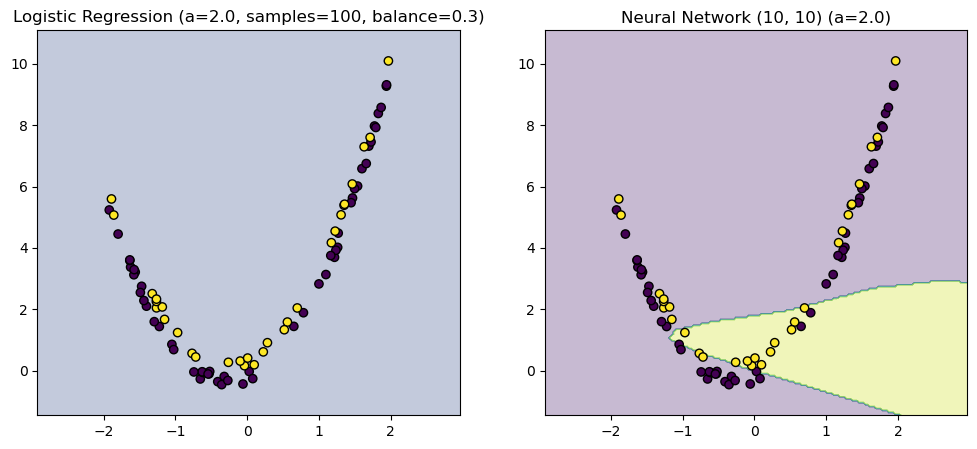

Generated data: X shape (83,), y length 83


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


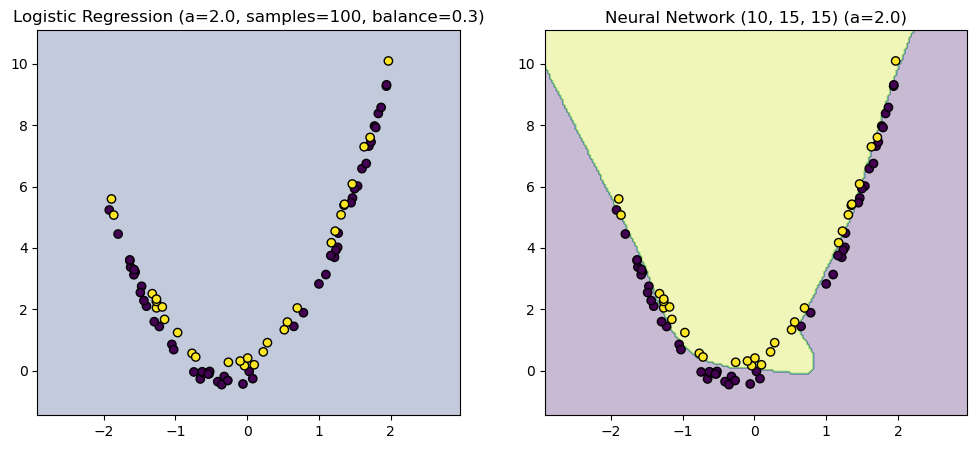

Generated data: X shape (97,), y length 97


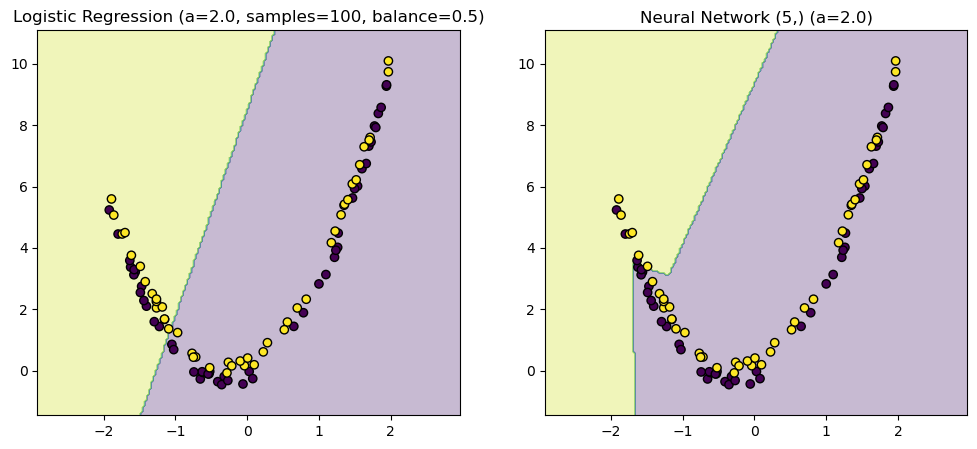

Generated data: X shape (97,), y length 97


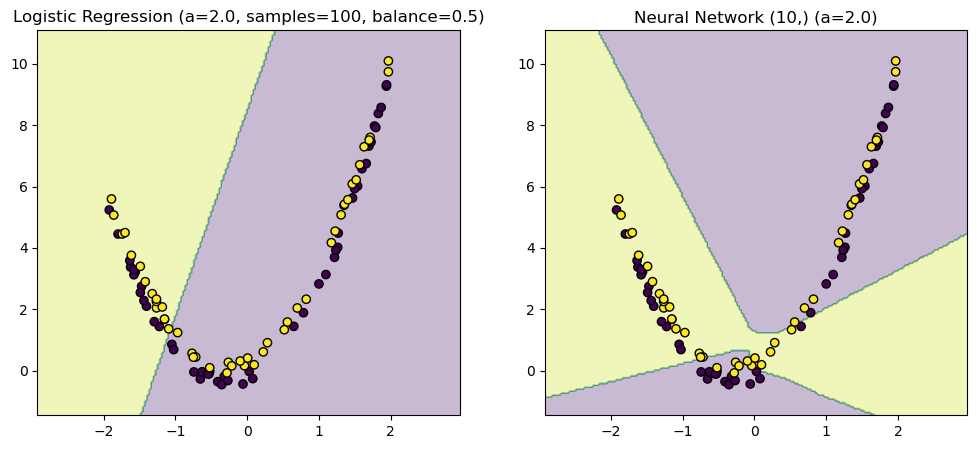

Generated data: X shape (97,), y length 97


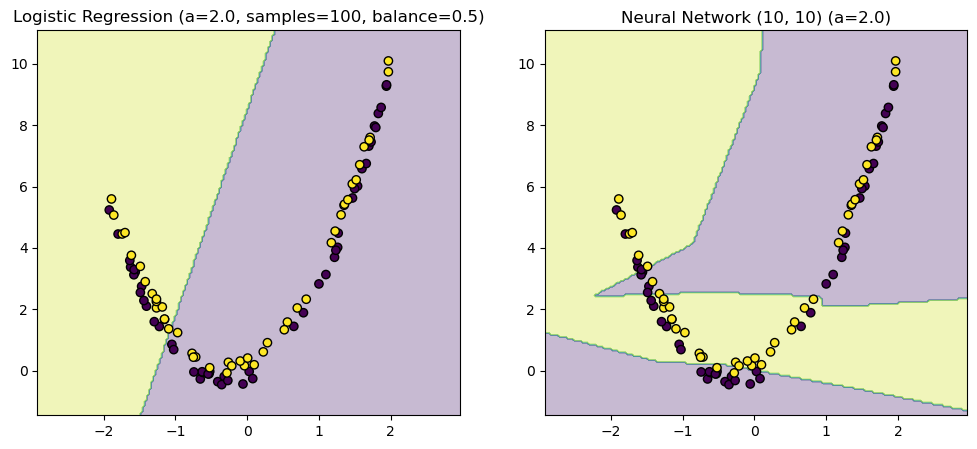

Generated data: X shape (97,), y length 97


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


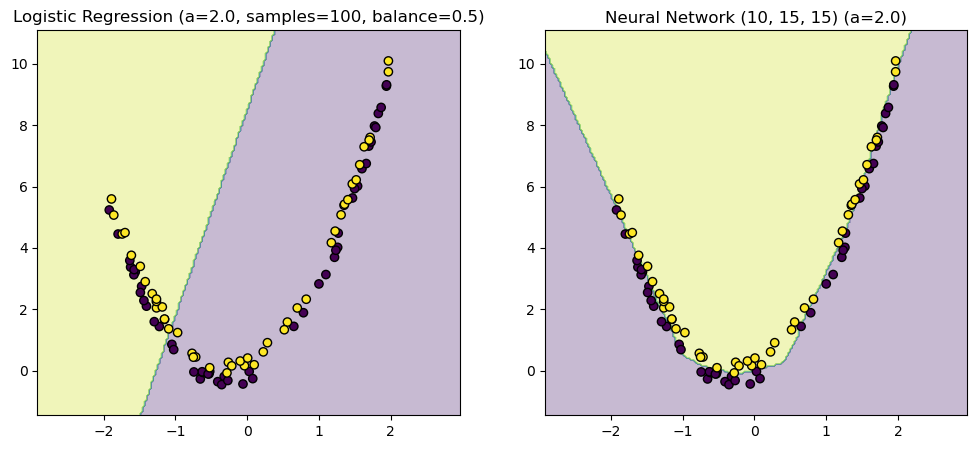

Generated data: X shape (77,), y length 77


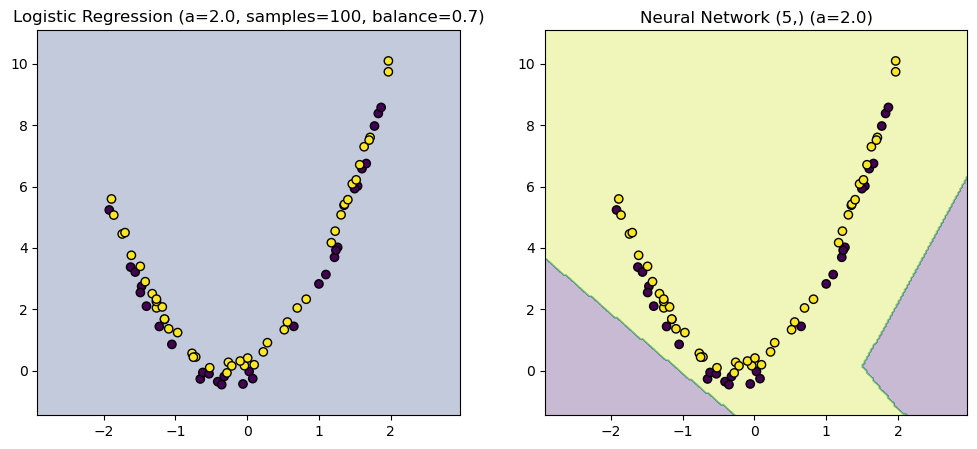

Generated data: X shape (77,), y length 77


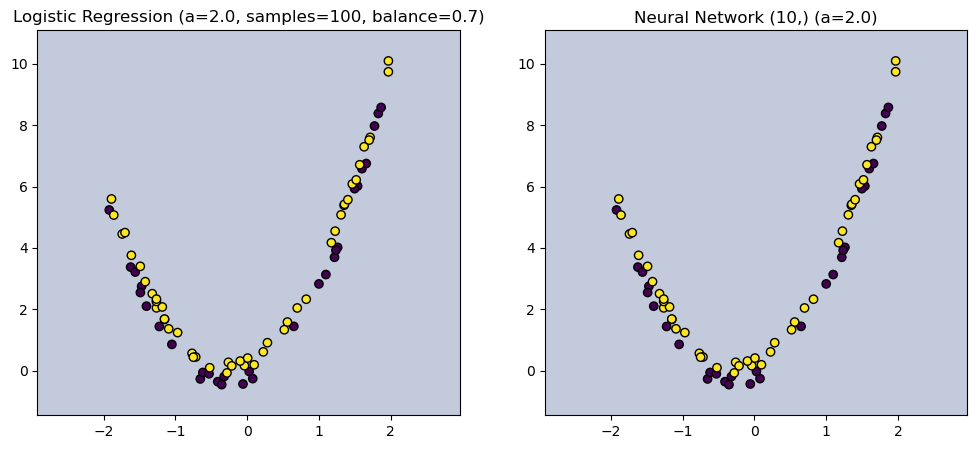

Generated data: X shape (77,), y length 77


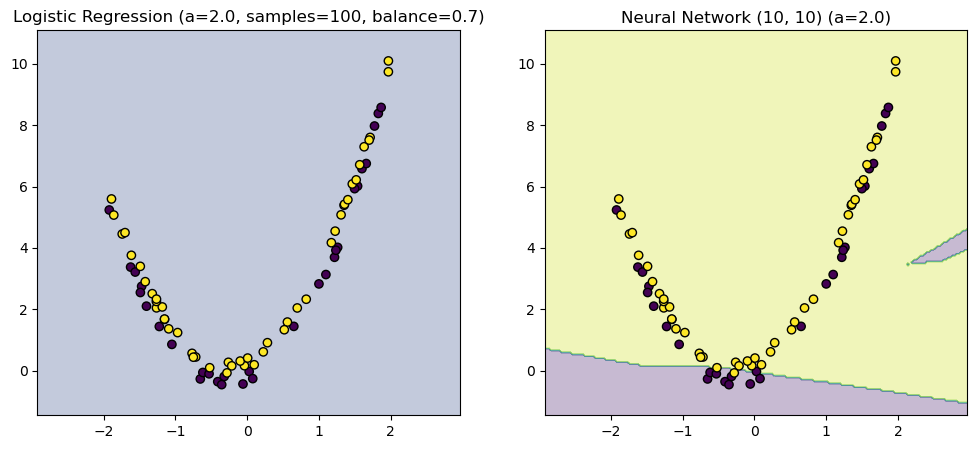

Generated data: X shape (77,), y length 77


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


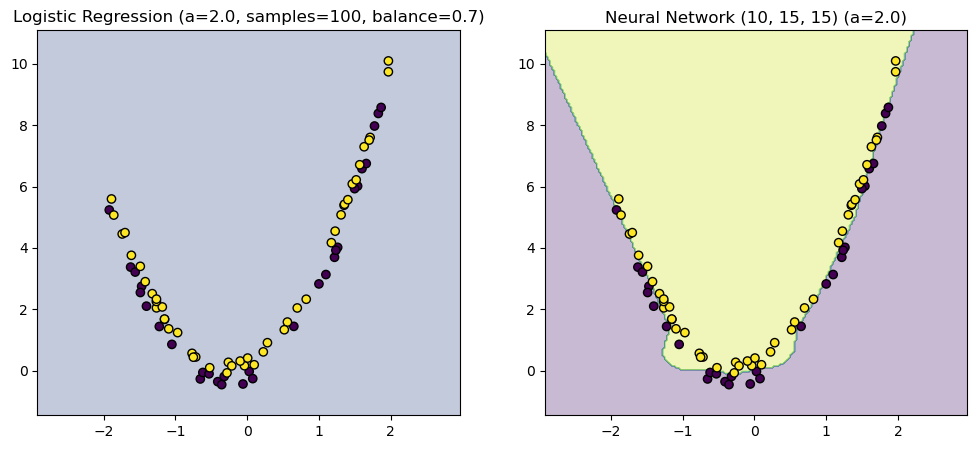

Generated data: X shape (248,), y length 248


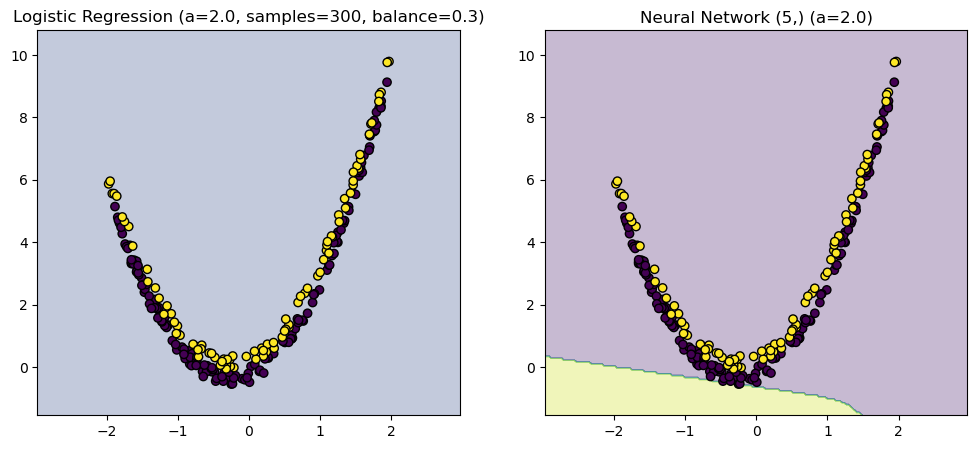

Generated data: X shape (248,), y length 248


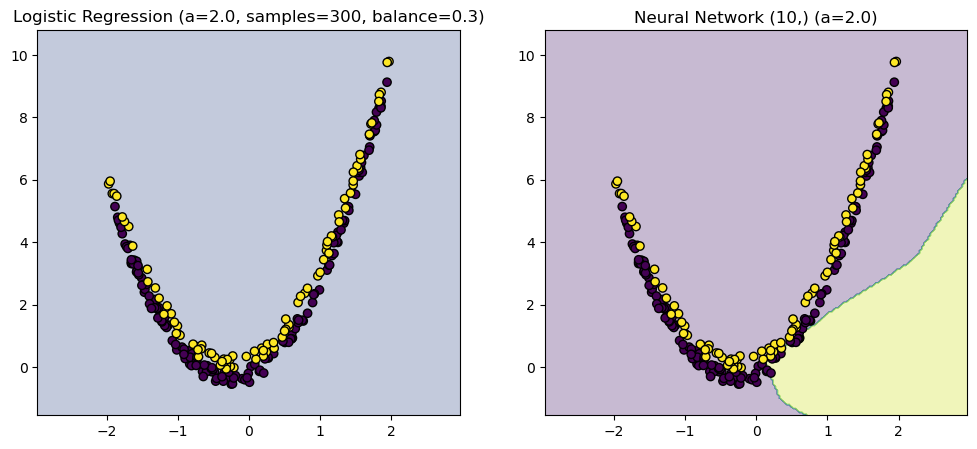

Generated data: X shape (248,), y length 248


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


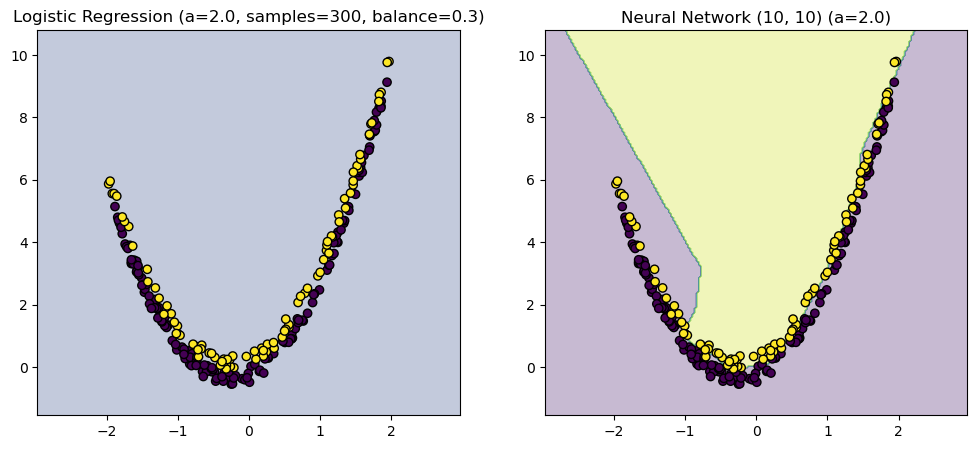

Generated data: X shape (248,), y length 248


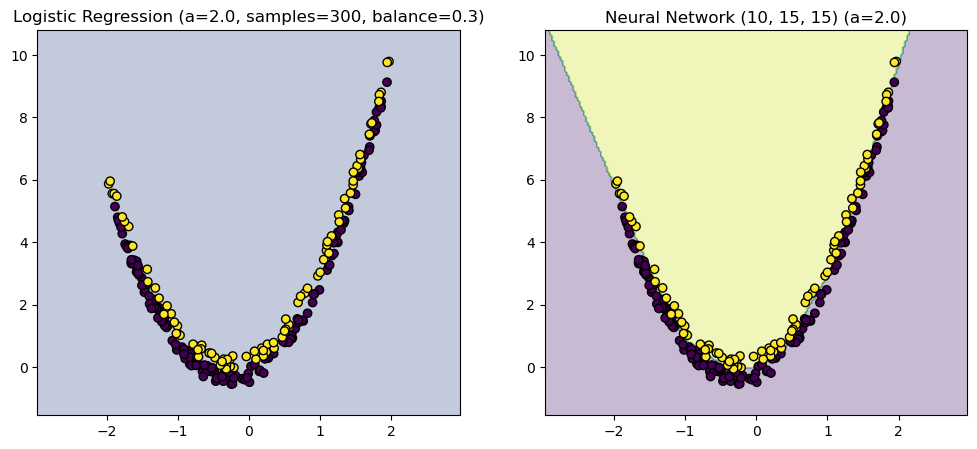

Generated data: X shape (292,), y length 292


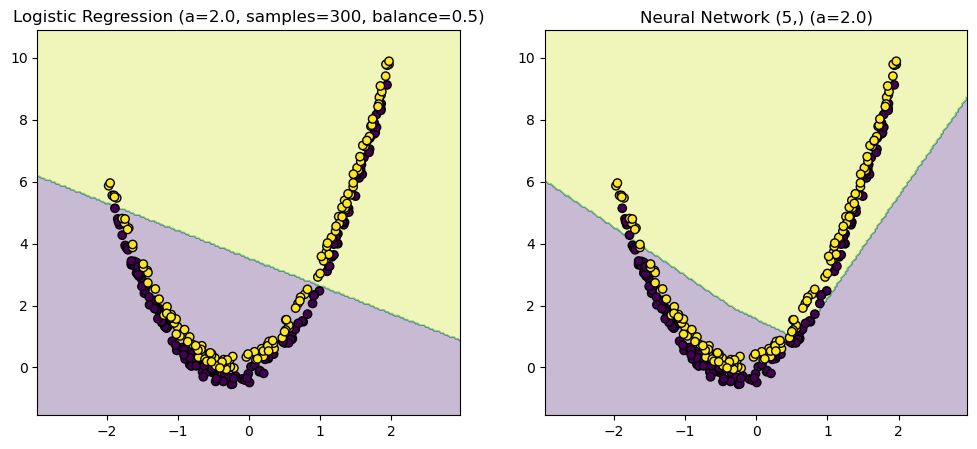

Generated data: X shape (292,), y length 292


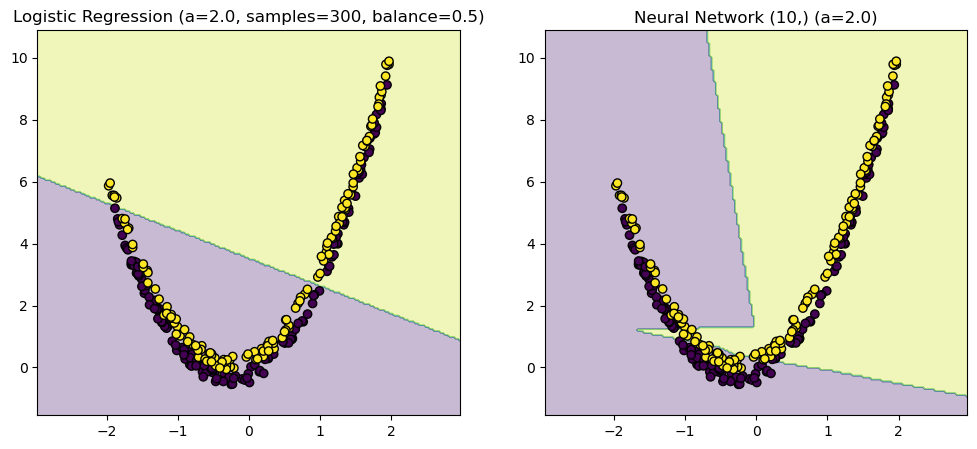

Generated data: X shape (292,), y length 292


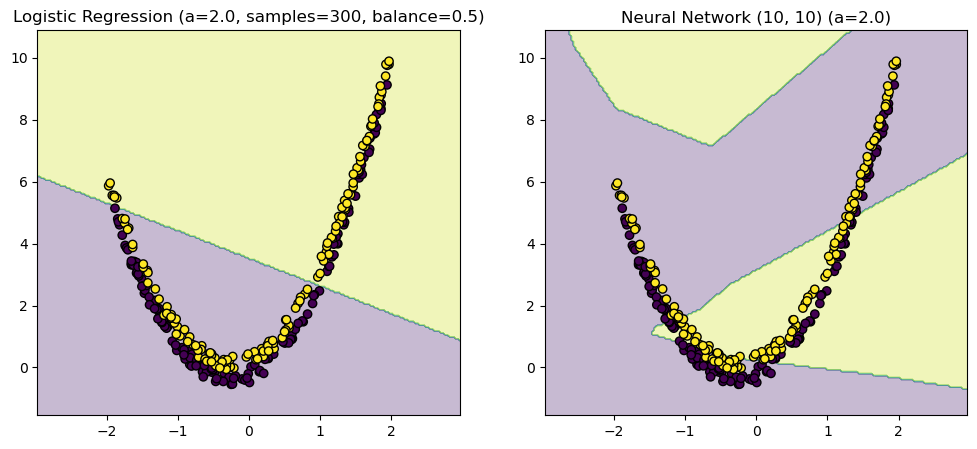

Generated data: X shape (292,), y length 292


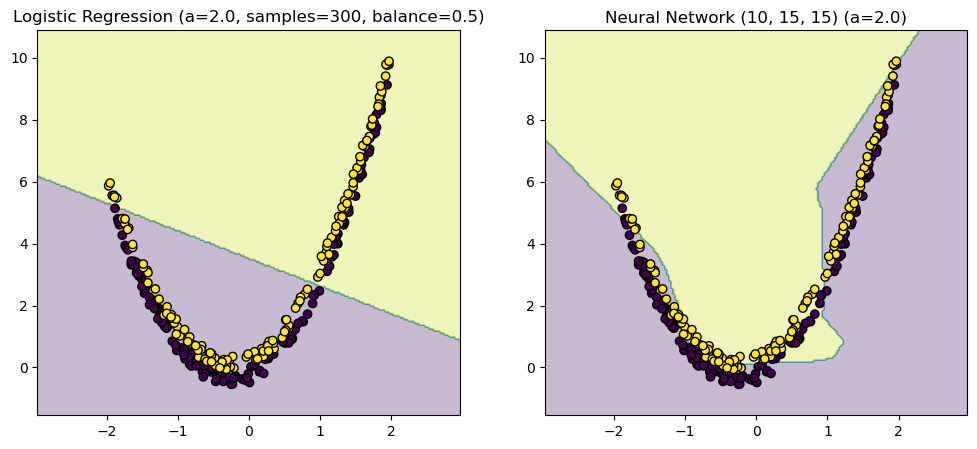

Generated data: X shape (232,), y length 232


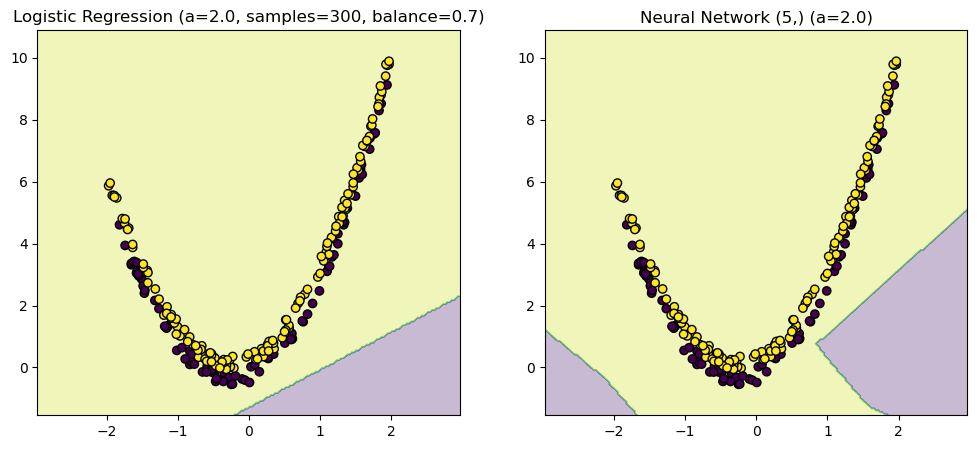

Generated data: X shape (232,), y length 232


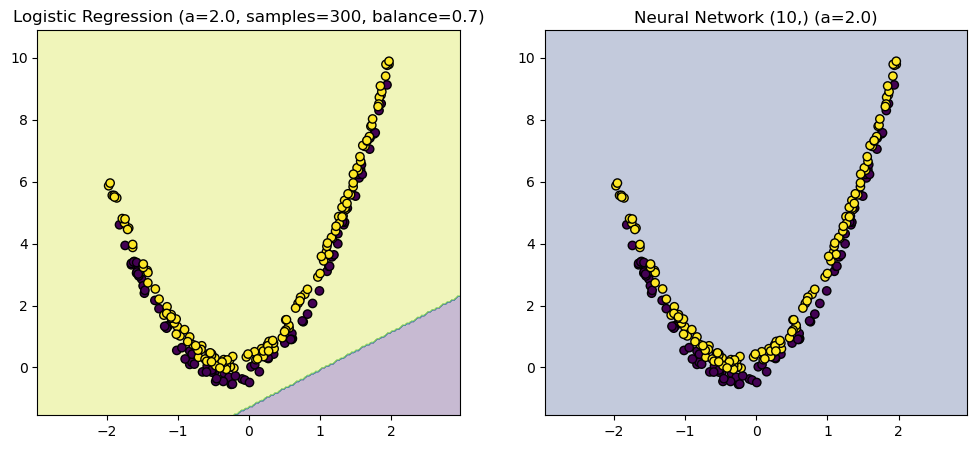

Generated data: X shape (232,), y length 232


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


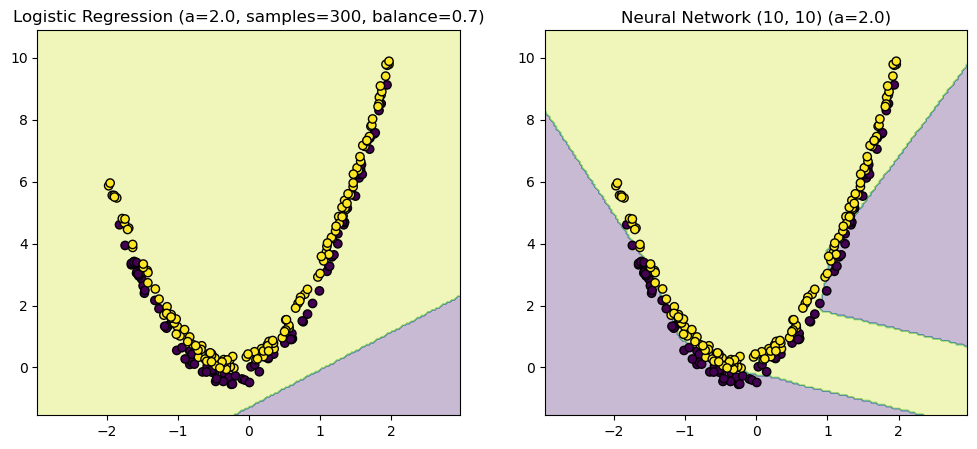

Generated data: X shape (232,), y length 232


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


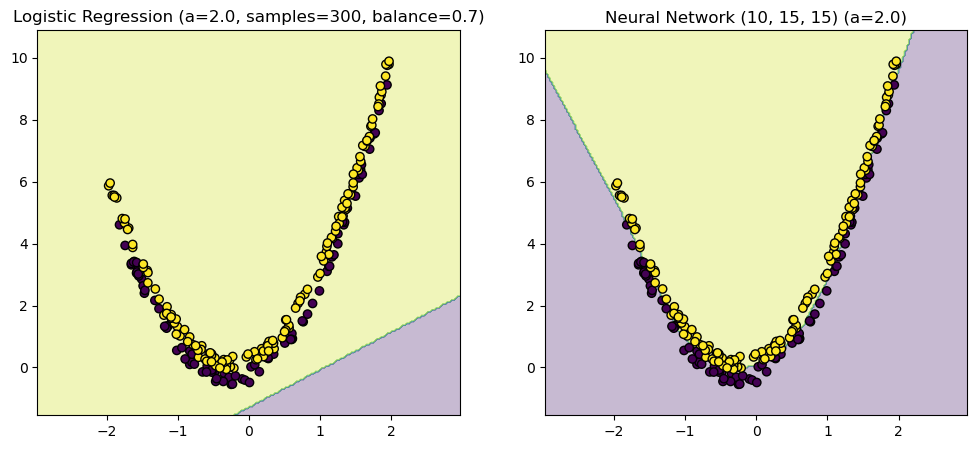

Generated data: X shape (408,), y length 408


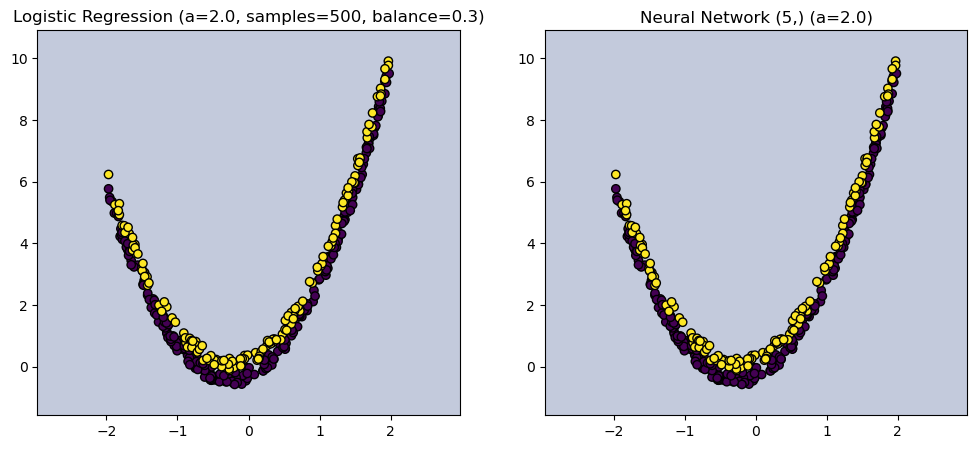

Generated data: X shape (408,), y length 408


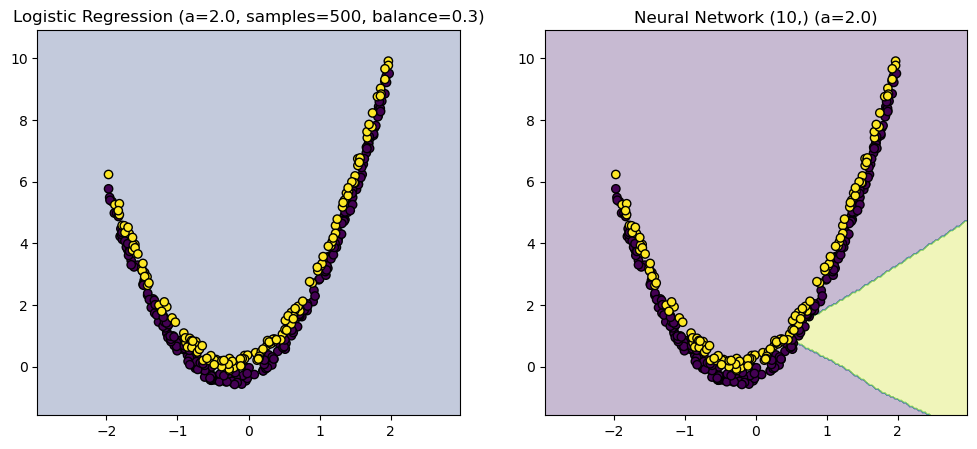

Generated data: X shape (408,), y length 408


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


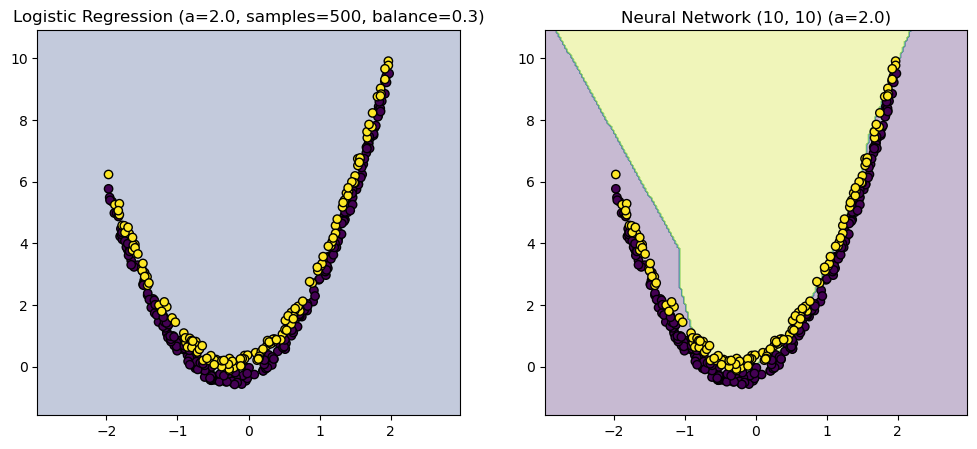

Generated data: X shape (408,), y length 408


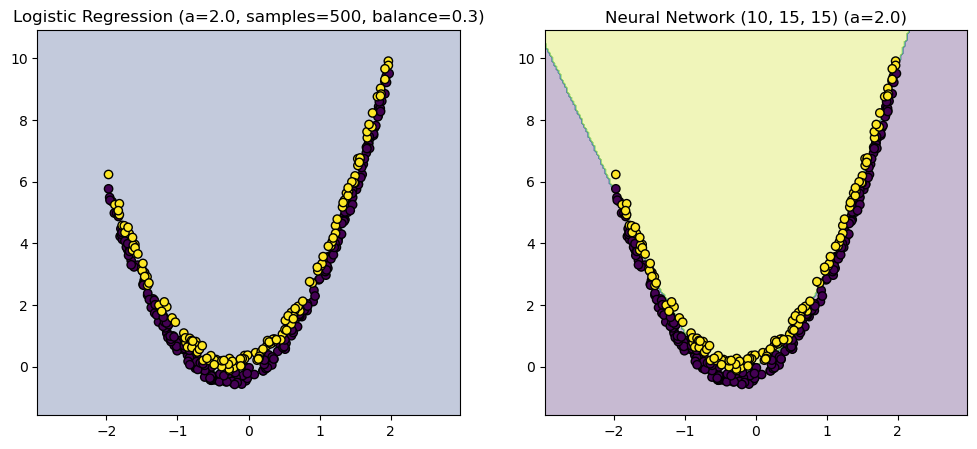

Generated data: X shape (492,), y length 492


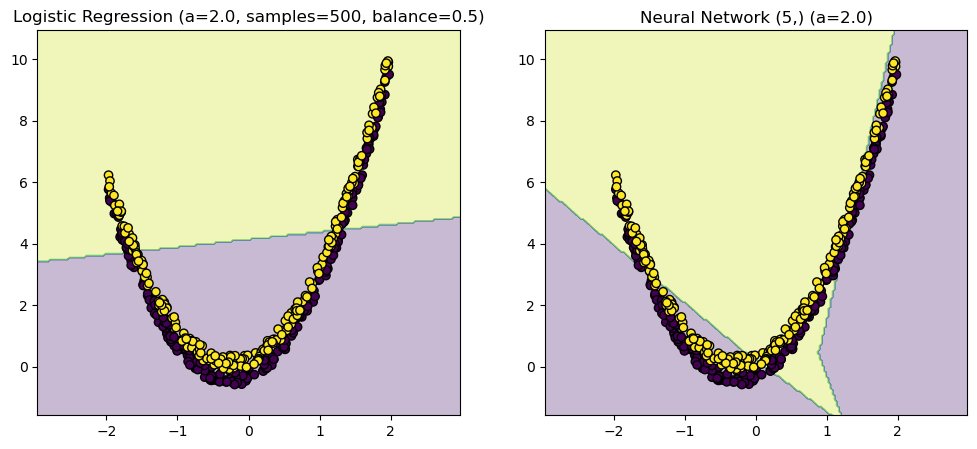

Generated data: X shape (492,), y length 492


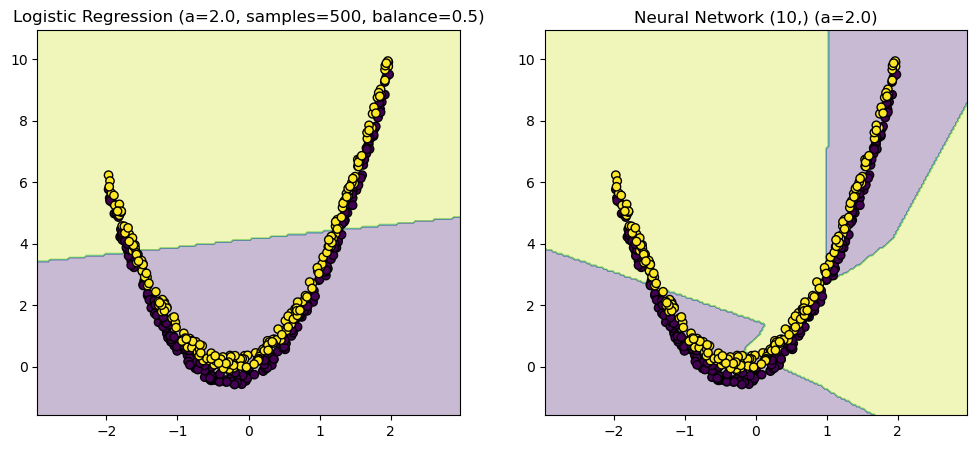

Generated data: X shape (492,), y length 492


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


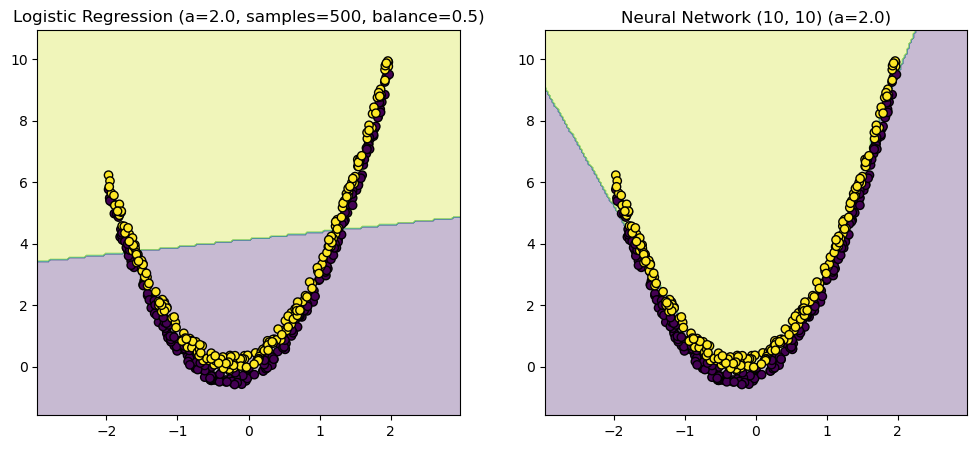

Generated data: X shape (492,), y length 492


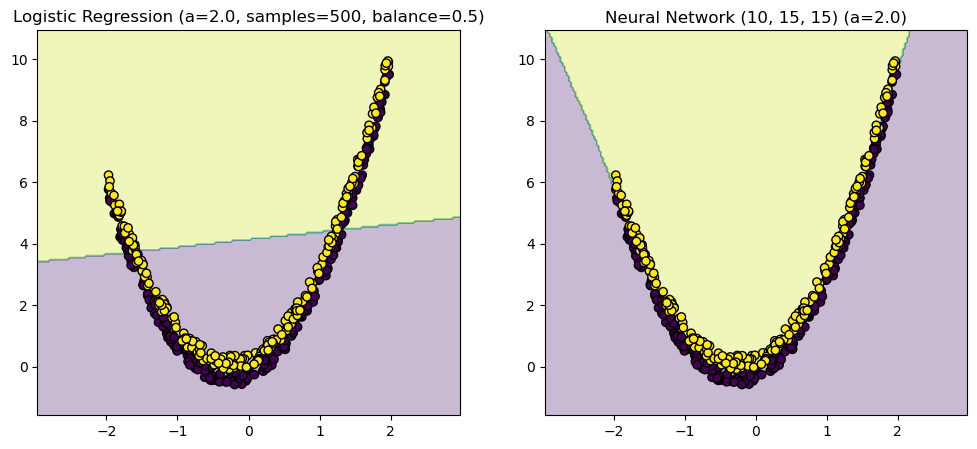

Generated data: X shape (392,), y length 392


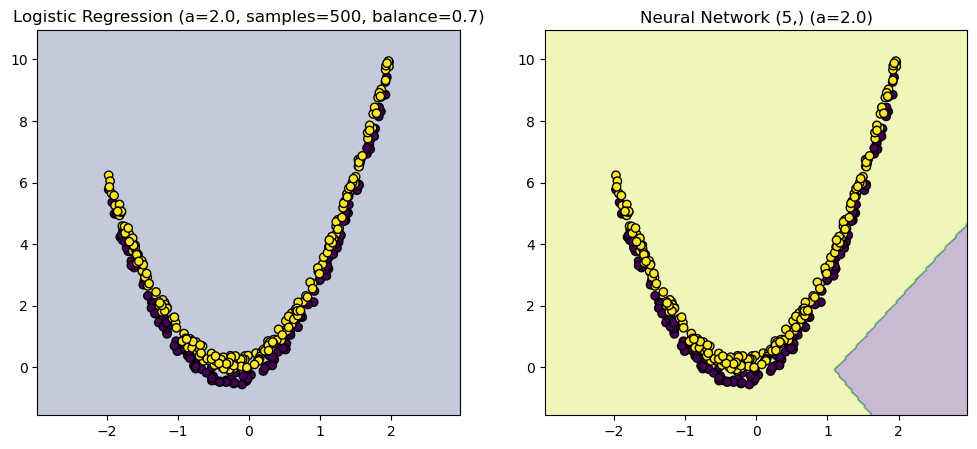

Generated data: X shape (392,), y length 392


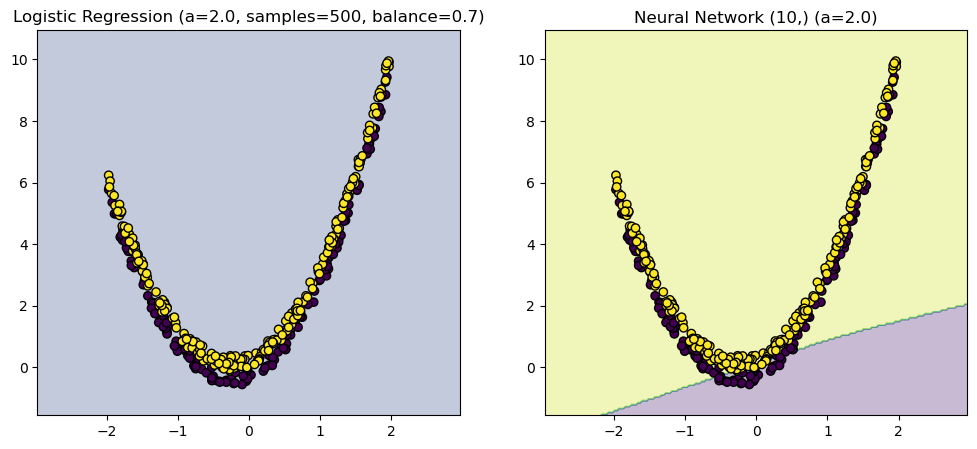

Generated data: X shape (392,), y length 392


C:\Users\agarw\anaconda3\envs\text_analytics\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


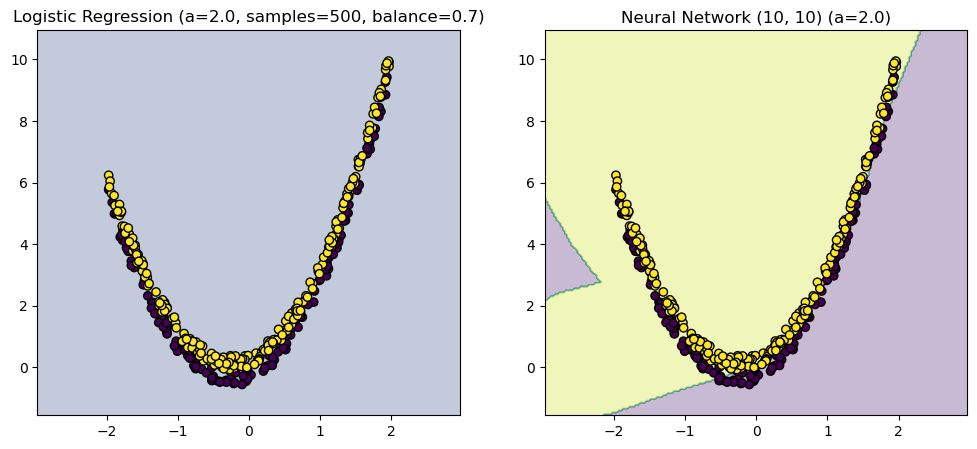

Generated data: X shape (392,), y length 392


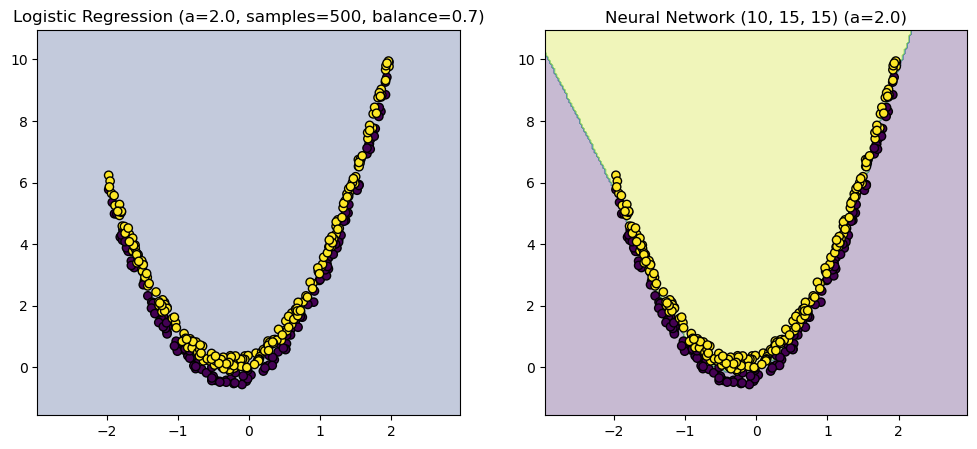

a=0.5, samples=100, balance=0.3, nn_size=(5,), log_reg_acc=0.647, nn_acc=0.765
a=0.5, samples=100, balance=0.3, nn_size=(10,), log_reg_acc=0.647, nn_acc=0.765
a=0.5, samples=100, balance=0.3, nn_size=(10, 10), log_reg_acc=0.647, nn_acc=1.000
a=0.5, samples=100, balance=0.3, nn_size=(10, 15, 15), log_reg_acc=0.647, nn_acc=1.000
a=0.5, samples=100, balance=0.5, nn_size=(5,), log_reg_acc=0.400, nn_acc=0.600
a=0.5, samples=100, balance=0.5, nn_size=(10,), log_reg_acc=0.400, nn_acc=0.750
a=0.5, samples=100, balance=0.5, nn_size=(10, 10), log_reg_acc=0.400, nn_acc=0.950
a=0.5, samples=100, balance=0.5, nn_size=(10, 15, 15), log_reg_acc=0.400, nn_acc=1.000
a=0.5, samples=100, balance=0.7, nn_size=(5,), log_reg_acc=0.750, nn_acc=0.875
a=0.5, samples=100, balance=0.7, nn_size=(10,), log_reg_acc=0.750, nn_acc=0.812
a=0.5, samples=100, balance=0.7, nn_size=(10, 10), log_reg_acc=0.750, nn_acc=0.938
a=0.5, samples=100, balance=0.7, nn_size=(10, 15, 15), log_reg_acc=0.750, nn_acc=1.000
a=0.5, sample

In [83]:
# Define test parameters
a_values = [0.5, 1.0, 2.0]  # Different boundary curvatures
sample_sizes = [100, 300, 500]  # Different dataset sizes
class_ratios = [0.3, 0.5, 0.7]  # Different class balances
nn_sizes = [(5,), (10,), (10, 10),(10,15,15)]  # Different neural network sizes

# Running Model Evaluations
results,conf_mat_logreg,conf_mat_nn = evaluate_models(a_values, sample_sizes, class_ratios, nn_sizes)

# Printing the results
for res in results:
    print(f'a={res[0]}, samples={res[1]}, balance={res[2]}, nn_size={res[3]}, log_reg_acc={res[4]:.3f}, nn_acc={res[5]:.3f}')


### Visualizing Model Performance
Converts the list of results into a Pandas DataFrame for easier manipulation.

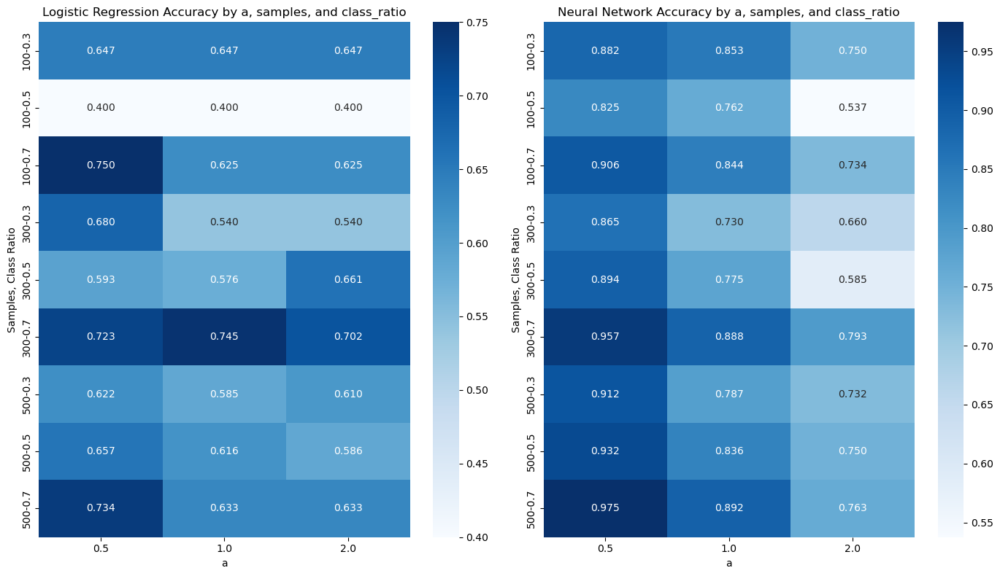

In [84]:
# Storing Results in a DataFrame
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Store results in a DataFrame for easier plotting
columns = ['a', 'samples', 'class_ratio', 'nn_size', 'log_reg_acc', 'nn_acc']
df_results = pd.DataFrame(results, columns=columns)

# Reshape the results into a form suitable for seaborn plotting
# Creating Heatmaps for Accuracy Comparisons

plt.figure(figsize=(14, 8))

# Plot Logistic Regression Accuracy
plt.subplot(1, 2, 1)
sns.heatmap(df_results.pivot_table(index=['samples', 'class_ratio'], columns='a', values='log_reg_acc'), cmap="Blues", annot=True, fmt='.3f')
plt.title('Logistic Regression Accuracy by a, samples, and class_ratio')
plt.ylabel('Samples, Class Ratio')
plt.xlabel('a')

# Plot Neural Network Accuracy
plt.subplot(1, 2, 2)
sns.heatmap(df_results.pivot_table(index=['samples', 'class_ratio'], columns='a', values='nn_acc'), cmap="Blues", annot=True, fmt='.3f')
plt.title('Neural Network Accuracy by a, samples, and class_ratio')
plt.ylabel('Samples, Class Ratio')
plt.xlabel('a')

# Final Layout Adjustments & Display
plt.tight_layout()
plt.show()


### Analyzing Accuracy vs. Class Ratio
This plot examines how class ratio (balance between classes A & B) impacts the performance of:
- Logistic Regression
- Neural Network

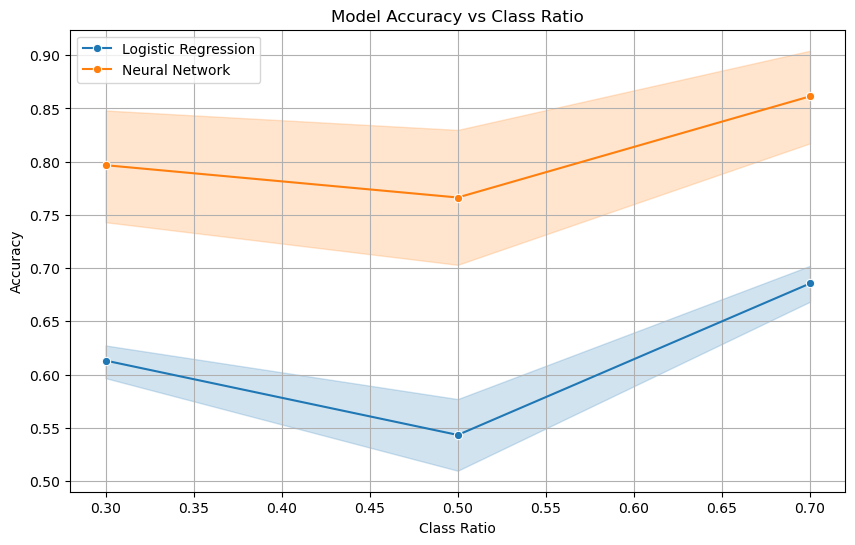

In [85]:
# Plotting Accuracy Against Class Ratio
plt.figure(figsize=(10, 6))

# Plot accuracy as a function of class ratio

# Logistic Regression Performance
sns.lineplot(x=df_results['class_ratio'], y=df_results['log_reg_acc'], label='Logistic Regression', marker='o')

# Neural Network Performance
sns.lineplot(x=df_results['class_ratio'], y=df_results['nn_acc'], label='Neural Network', marker='o')

# Final Plot Adjustments
plt.title('Model Accuracy vs Class Ratio')
plt.xlabel('Class Ratio')
plt.ylabel('Accuracy')
plt.legend()
plt.grid(True)
plt.show()


### Analyzing Neural Network Accuracy vs. Model Complexity
This plot explores how neural network architecture (nn_size) affects performance as boundary curvature (a) changes.

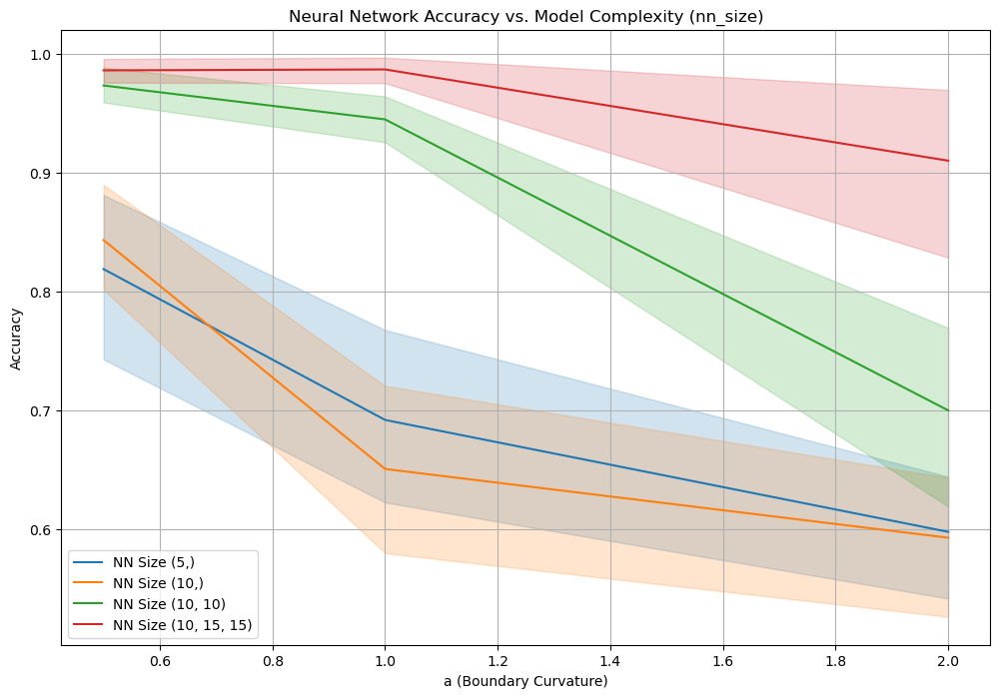

In [86]:
# Plot accuracy by nn_size (neural network architecture)
plt.figure(figsize=(12, 8))

# Loop through Different Neural Network Sizes
for nn_size in df_results['nn_size'].unique():
    subset = df_results[df_results['nn_size'] == nn_size]
    
    sns.lineplot(x=subset['a'], y=subset['nn_acc'], label=f'NN Size {nn_size}')

plt.title('Neural Network Accuracy vs. Model Complexity (nn_size)')
plt.xlabel('a (Boundary Curvature)')
plt.ylabel('Accuracy')
plt.legend()
plt.grid(True)
plt.show()


### Confusion Matrix Analysis
To visualize the confusion matrices for both Logistic Regression and Neural Network, helping us understand misclassifications across different parameter settings.

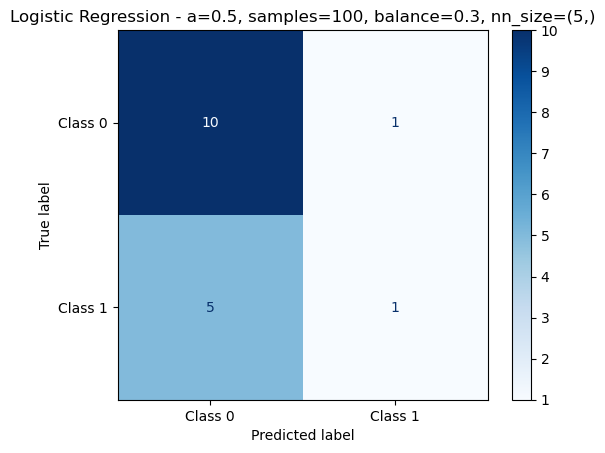

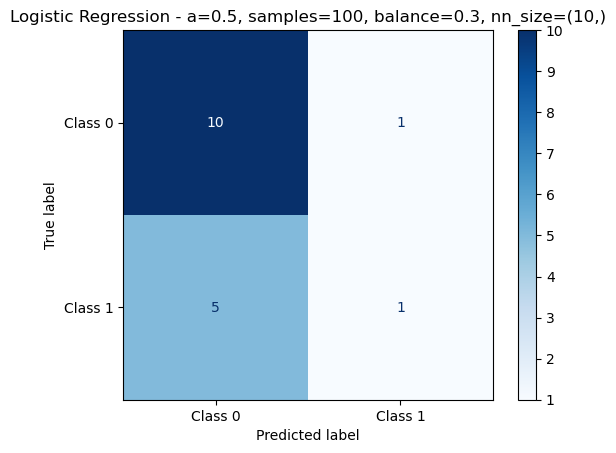

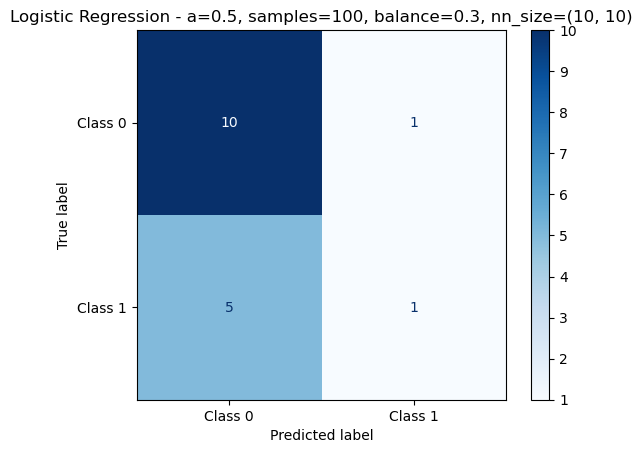

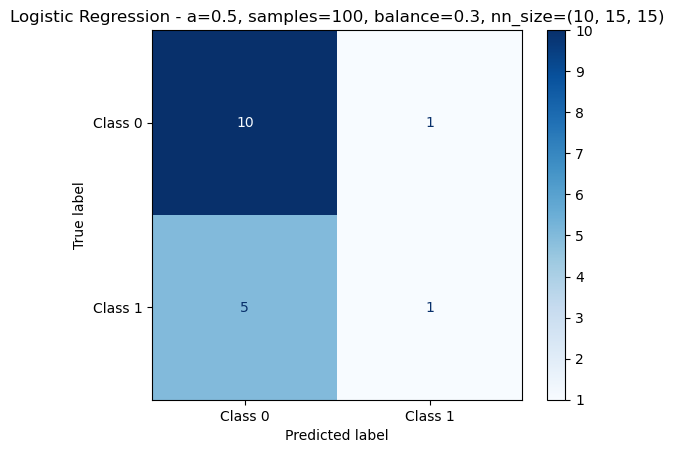

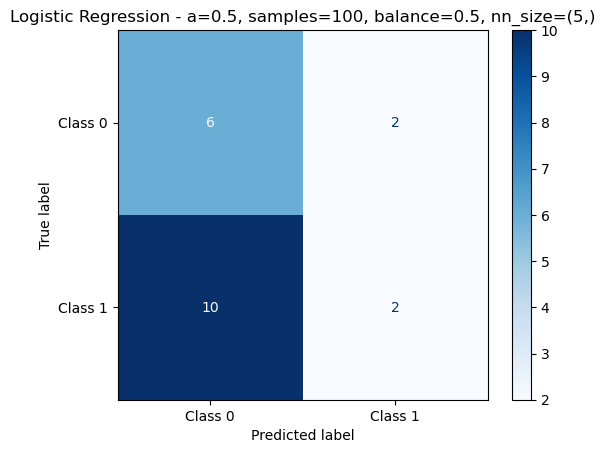

...

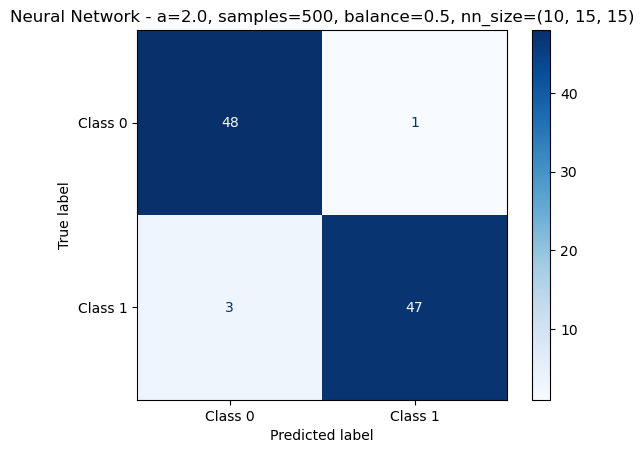

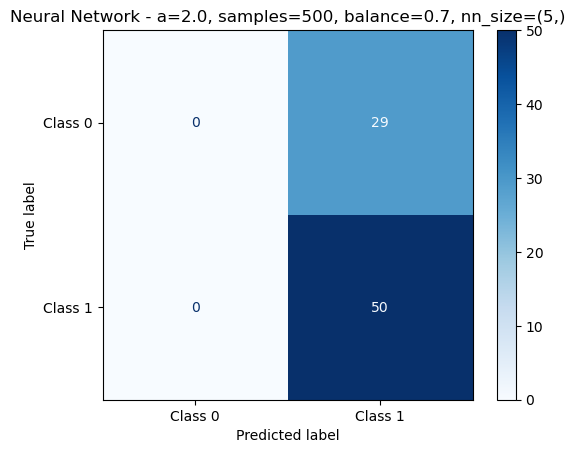

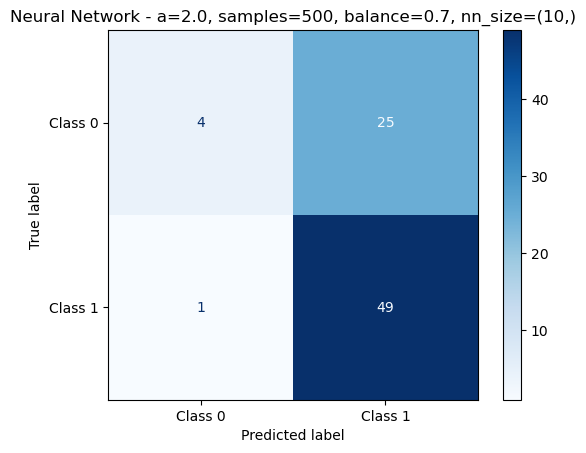

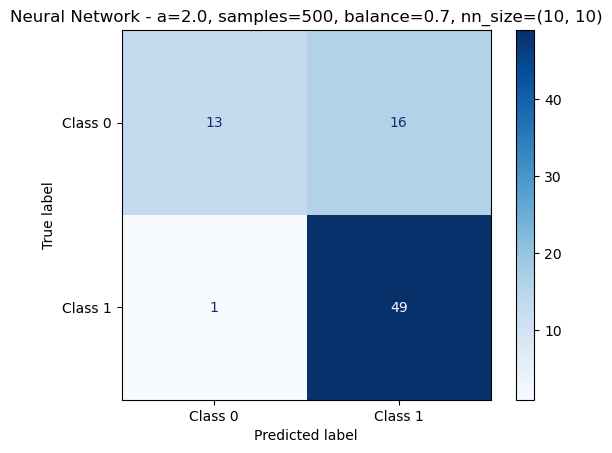

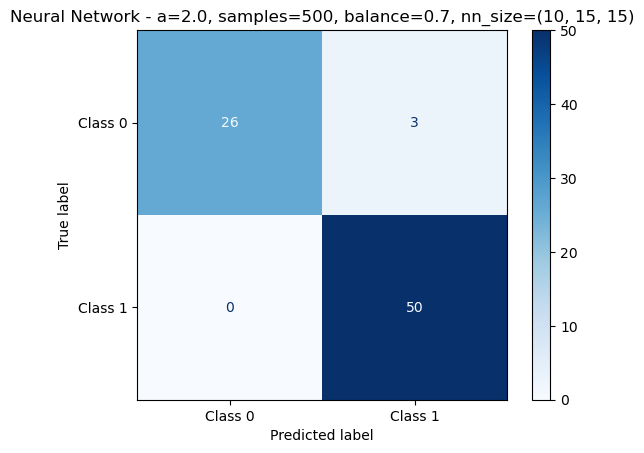

In [87]:
# Define a function to plot confusion matrix
def plot_confusion_matrix(cm, model_type, a, num_samples, class_ratio, nn_size):

    # Displaying the Confusion Matrix
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=['Class 0', 'Class 1'])
    disp.plot(cmap='Blues')
    
    # Set the title based on the model and parameters
    plt.title(f'{model_type} - a={a}, samples={num_samples}, balance={class_ratio}, nn_size={nn_size}')
    plt.show()

# Plot confusion matrices for both models after evaluation is done

# For Logistic Regression
for log_reg_cm in conf_mat_logreg:
    plot_confusion_matrix(log_reg_cm['conf_matrix'], 'Logistic Regression', 
                          log_reg_cm['a'], log_reg_cm['num_samples'], 
                          log_reg_cm['class_ratio'], log_reg_cm['nn_size'])

# For Neural Network
for nn_cm in conf_mat_nn:
    plot_confusion_matrix(nn_cm['conf_matrix'], 'Neural Network', 
                          nn_cm['a'], nn_cm['num_samples'], 
                          nn_cm['class_ratio'], nn_cm['nn_size'])



### ROC Curve Visualization
Visualize the ROC Curves (Receiver Operating Characteristic Curves) for both the Logistic Regression and Neural Network models, providing insight into their performance across different experiment setups. The ROC curve is useful for evaluating classification performance, especially in imbalanced data scenarios. Here, we focus on AUC (Area Under Curve) as an evaluation metric.

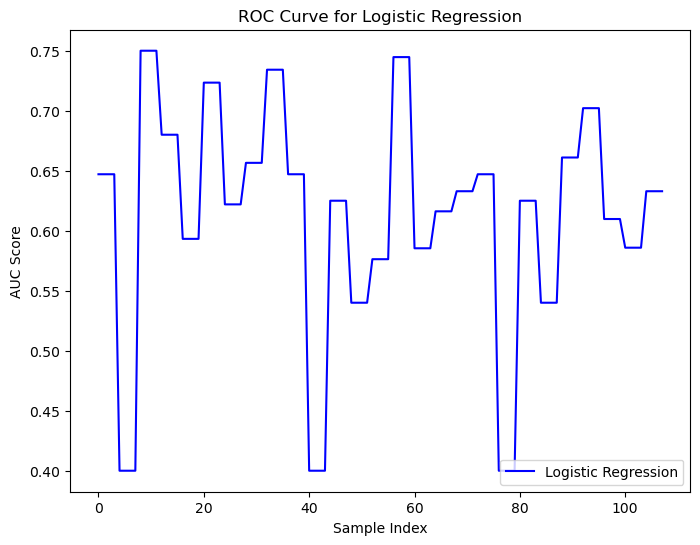

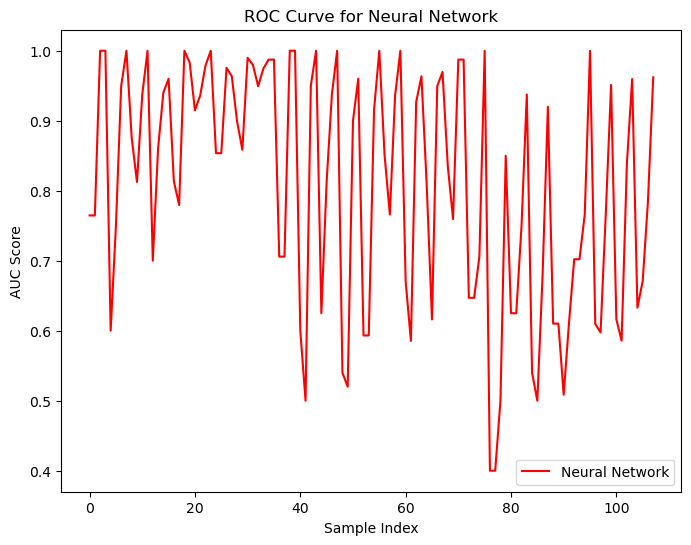

In [88]:
from sklearn.metrics import roc_curve, auc

# Plot ROC Curves using pre-calculated results
def plot_roc_curves(results):
    # We assume the results list contains the AUC values for both models
    # Extracting AUC Values
    log_reg_auc_values = [res[4] for res in results]  # LogReg AUC values
    nn_auc_values = [res[5] for res in results]  # NN AUC values

    # Plot ROC Curve for Logistic Regression
    plt.figure(figsize=(8, 6))
    plt.plot(log_reg_auc_values, color='blue', label='Logistic Regression')
    plt.title('ROC Curve for Logistic Regression')
    plt.xlabel('Sample Index')
    plt.ylabel('AUC Score')
    plt.legend(loc='lower right')
    plt.show()

    # Plot ROC Curve for Neural Network
    plt.figure(figsize=(8, 6))
    plt.plot(nn_auc_values, color='red', label='Neural Network')
    plt.title('ROC Curve for Neural Network')
    plt.xlabel('Sample Index')
    plt.ylabel('AUC Score')
    plt.legend(loc='lower right')
    plt.show()

plot_roc_curves(results)

### Scatter Plot Comparison of Model Accuracies
Create a scatter plot comparing the accuracies of Logistic Regression vs. Neural Network across different configurations. This visualization will help evaluate how both models perform in comparison to each other, with Neural Network accuracy plotted against Logistic Regression accuracy.

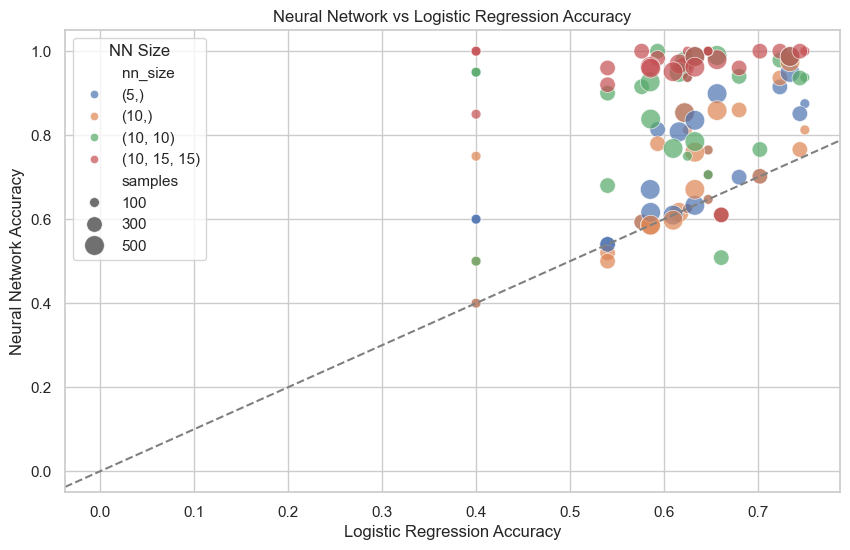

In [89]:
import pandas as pd
import seaborn as sns
df = pd.DataFrame(results, columns=["a", "samples", "balance", "nn_size", "log_reg_acc", "nn_acc"])

# Convert nn_size to string for better plotting
df["nn_size"] = df["nn_size"].astype(str)

# Set style
sns.set(style="whitegrid")

# Plot Neural Network accuracy vs Logistic Regression accuracy
plt.figure(figsize=(10, 6))
sns.scatterplot(data=df, x="log_reg_acc", y="nn_acc", hue="nn_size", size="samples", sizes=(50, 200), alpha=0.7)

plt.axline((0, 0), slope=1, linestyle="--", color="gray")  # Reference line y=x

plt.title("Neural Network vs Logistic Regression Accuracy")
plt.xlabel("Logistic Regression Accuracy")
plt.ylabel("Neural Network Accuracy")
plt.legend(title="NN Size")
plt.show()